<a href="https://colab.research.google.com/github/prabal5ghosh/UCA-M2-SEMESTER1/blob/main/deep%20learning/TP4a_backprop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center><h1>TP4a: Backpropagation in practice</h1></center>

# Warning :
# "File -> Save a copy in Drive" before starting to modify the notebook, otherwise changes won't be saved.

In [6]:
!wget https://remysun.github.io/uploads/TPBackprop.zip
!unzip -j TPBackprop.zip
!wget https://remysun.github.io/uploads/utils-data.py

--2024-10-22 12:48:26--  https://remysun.github.io/uploads/TPBackprop.zip
Resolving remysun.github.io (remysun.github.io)... 185.199.108.153, 185.199.109.153, 185.199.110.153, ...
Connecting to remysun.github.io (remysun.github.io)|185.199.108.153|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13423382 (13M) [application/zip]
Saving to: ‘TPBackprop.zip’

TPBackprop.zip      100%[===================>]  12.80M  83.2MB/s    in 0.2s    

2024-10-22 12:48:26 (83.2 MB/s) - ‘TPBackprop.zip’ saved [13423382/13423382]

Archive:  TPBackprop.zip
  inflating: ._TP3-4                 
  inflating: circles.mat             
  inflating: ._circles.mat           
  inflating: mnist.mat               
  inflating: ._mnist.mat             
--2024-10-22 12:48:27--  https://remysun.github.io/uploads/utils-data.py
Resolving remysun.github.io (remysun.github.io)... 185.199.108.153, 185.199.109.153, 185.199.110.153, ...
Connecting to remysun.github.io (remysun.github.io)|185.199.108

In [7]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%run 'utils-data.py'

# Partie 1 : Fully manual backprop

In [8]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    params["Wh"] = torch.randn((nh, nx))*0.3
    params["Wy"] = torch.randn((ny, nh))*0.3
    params["bh"] = torch.zeros((nh,1))
    params["by"] = torch.zeros((ny,1))

    return params

In [9]:
def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}

    outputs["X"] = X
    outputs["htilde"] = torch.mm(X, params["Wh"].T) + params["bh"].T
    outputs["h"] = torch.tanh(outputs["htilde"])
    outputs["ytilde"] = torch.mm(outputs["h"], params["Wy"].T) + params["by"].T
    outputs["yhat"] = torch.exp(outputs["ytilde"])
    outputs["yhat"] = outputs["yhat"] / outputs["yhat"].sum(dim=-1, keepdim=True)


    return outputs['yhat'], outputs

In [10]:
def loss_accuracy(Yhat, Y):


    L = - torch.mean((Y * torch.log(Yhat)).sum(dim=1)) # mean for the batch

    _, indYhat = torch.max(Yhat, 1)
    _, indY = torch.max(Y, 1)

    acc = torch.sum(indY == indYhat) * 100. / indY.size(0);


    return L, acc

In [11]:
def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}

    Y_tilde_grad = outputs["yhat"] - Y
    h_tilde_grad = torch.mm(Y_tilde_grad, params['Wy']
                            ) * (1 - torch.pow(outputs['h'], 2))

    grads["Wy"] = torch.mm(Y_tilde_grad.T, outputs["h"])
    grads["Wh"] = torch.mm(h_tilde_grad.T, outputs['X'])
    grads["by"] = Y_tilde_grad.sum(dim=0,keepdim=True).T
    grads["bh"] = h_tilde_grad.sum(0, keepdim=True).T

    grads['Wy'] /= bsize
    grads['by'] /= bsize
    grads['Wh'] /= bsize
    grads['bh'] /= bsize

    return grads

In [12]:
def sgd(params, grads, eta):

    params['Wy'] -= eta * grads['Wy']
    params['Wh'] -= eta * grads['Wh']
    params['by'] -= eta * grads['by']
    params['bh'] -= eta * grads['bh']

    return params

## Manual global learning algorithm

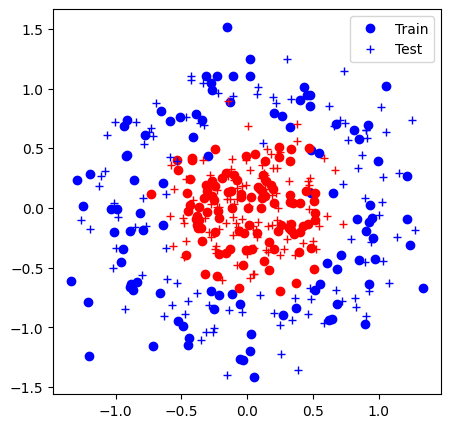

Iter 0: Acc train 49.5% (0.70), acc test 49.0% (0.71)


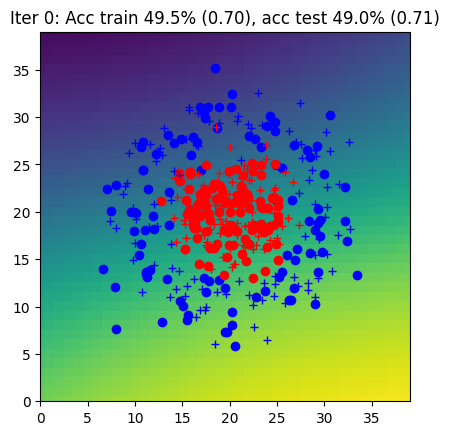

Iter 1: Acc train 49.0% (0.70), acc test 47.5% (0.70)


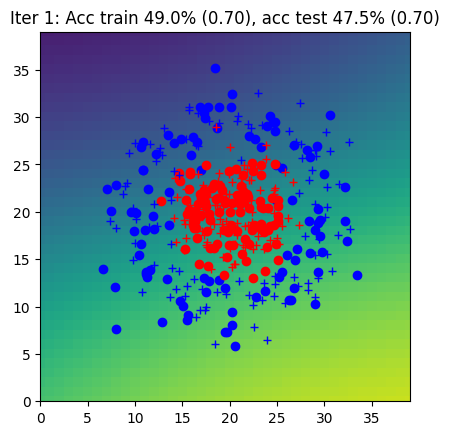

Iter 2: Acc train 51.0% (0.70), acc test 50.5% (0.70)


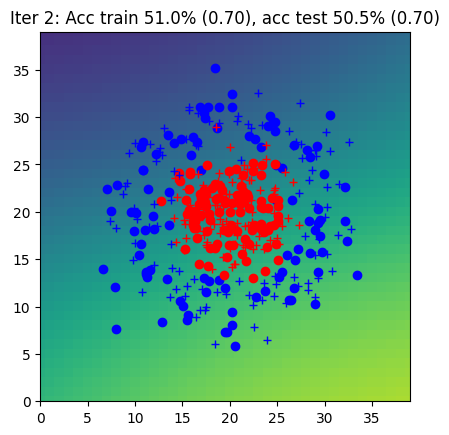

Iter 3: Acc train 54.5% (0.70), acc test 56.5% (0.70)


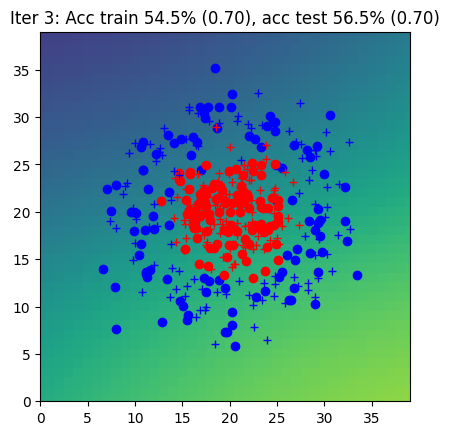

Iter 4: Acc train 56.0% (0.69), acc test 55.5% (0.70)


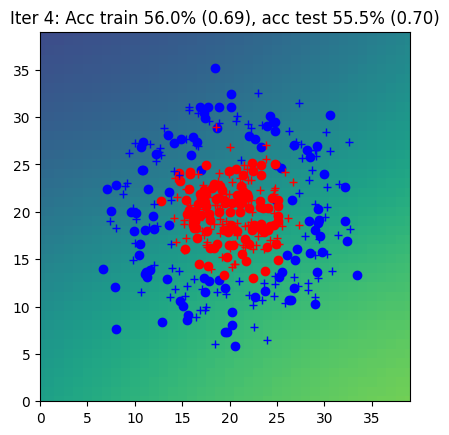

Iter 5: Acc train 54.5% (0.69), acc test 53.5% (0.70)


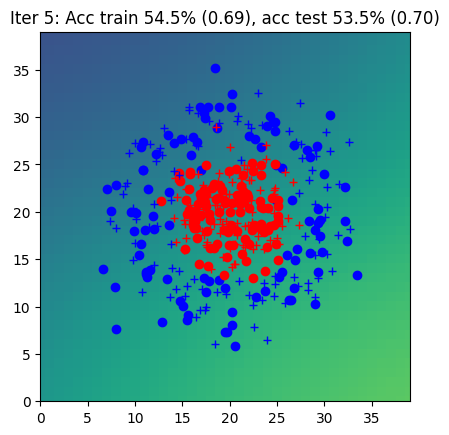

Iter 6: Acc train 55.5% (0.69), acc test 52.5% (0.69)


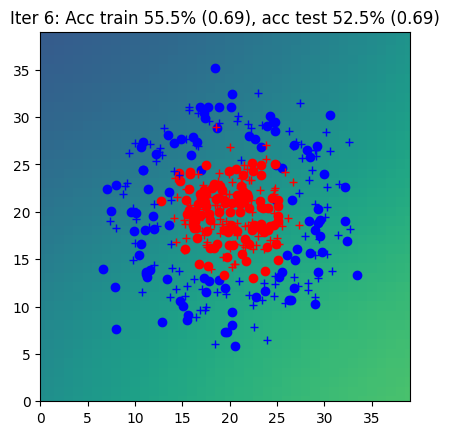

Iter 7: Acc train 52.5% (0.69), acc test 50.0% (0.69)


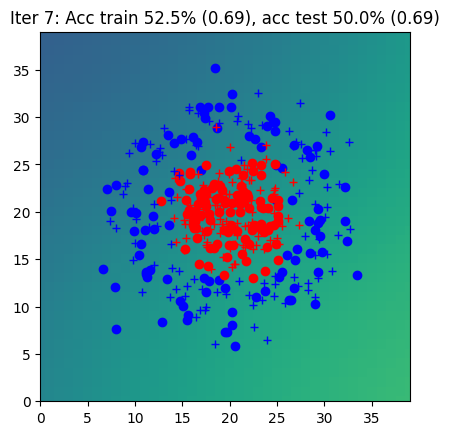

Iter 8: Acc train 54.5% (0.69), acc test 51.0% (0.69)


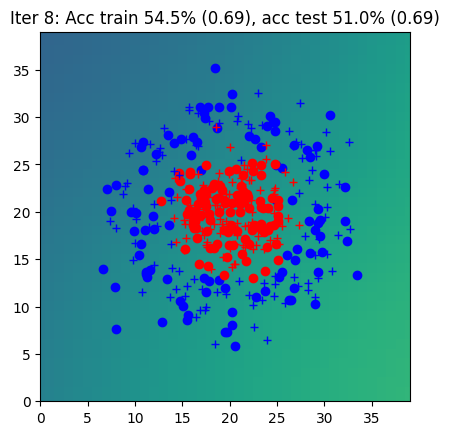

Iter 9: Acc train 57.0% (0.69), acc test 54.0% (0.69)


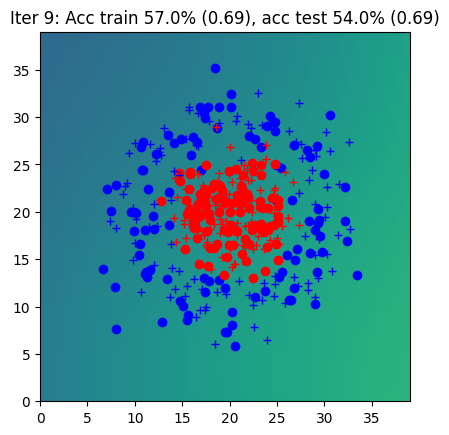

Iter 10: Acc train 61.0% (0.69), acc test 61.0% (0.69)


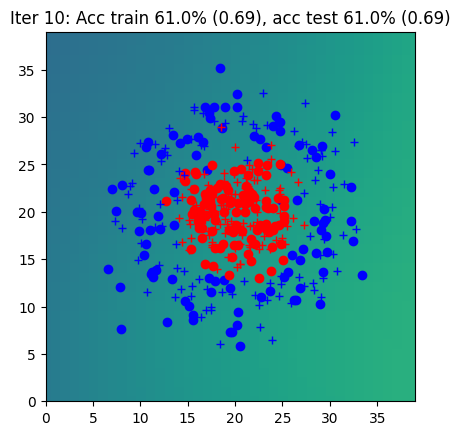

Iter 11: Acc train 55.0% (0.69), acc test 59.5% (0.69)


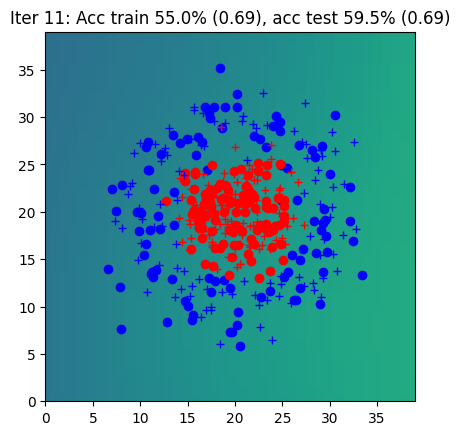

Iter 12: Acc train 55.5% (0.69), acc test 57.5% (0.69)


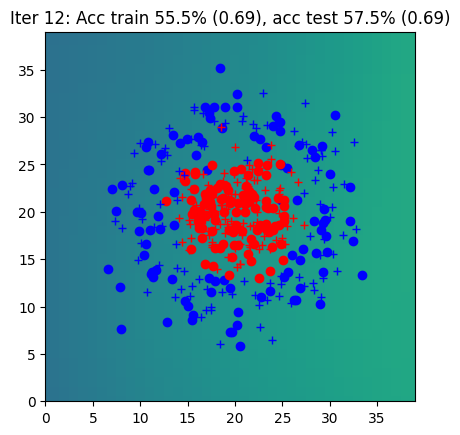

Iter 13: Acc train 58.5% (0.69), acc test 60.0% (0.69)


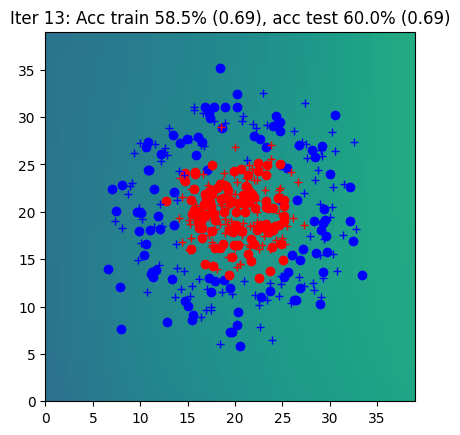

Iter 14: Acc train 59.5% (0.69), acc test 60.5% (0.69)


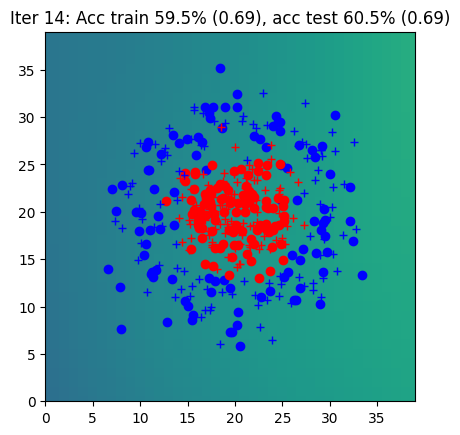

Iter 15: Acc train 56.0% (0.69), acc test 58.0% (0.69)


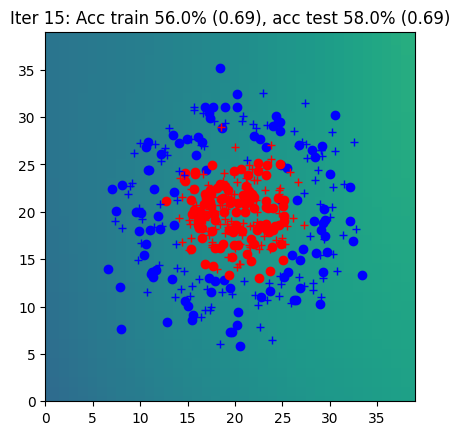

Iter 16: Acc train 58.0% (0.69), acc test 58.0% (0.69)


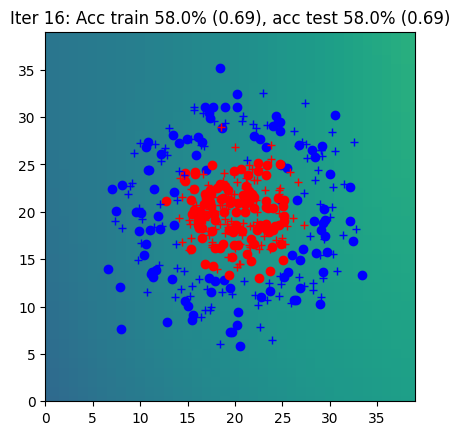

Iter 17: Acc train 60.5% (0.69), acc test 65.0% (0.69)


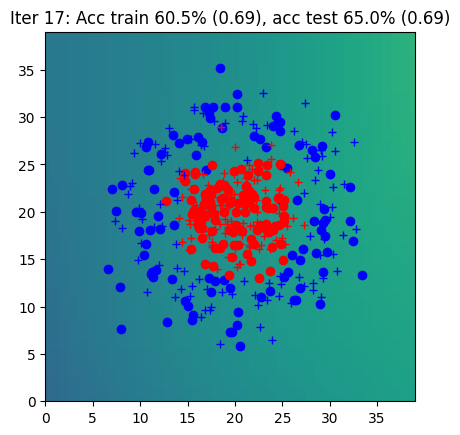

Iter 18: Acc train 61.5% (0.69), acc test 62.0% (0.69)


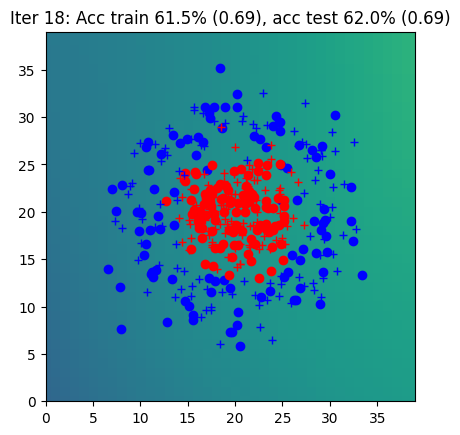

Iter 19: Acc train 59.5% (0.69), acc test 58.5% (0.69)


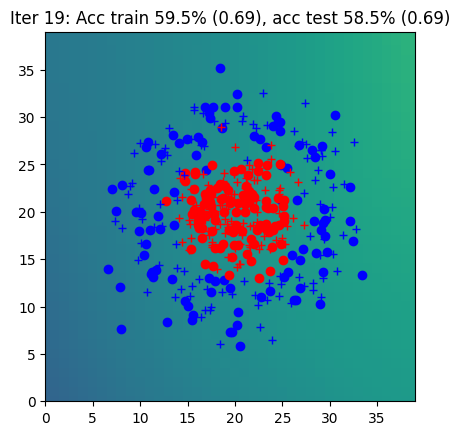

Iter 20: Acc train 58.0% (0.69), acc test 58.5% (0.69)


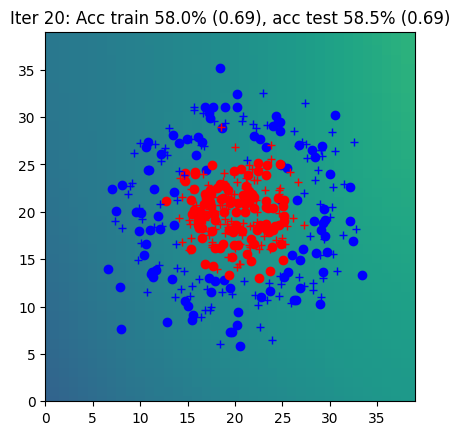

Iter 21: Acc train 62.0% (0.69), acc test 62.5% (0.69)


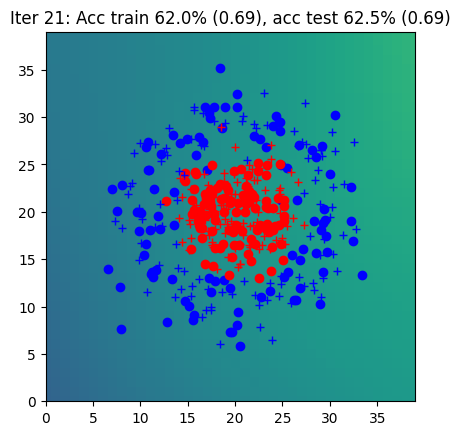

Iter 22: Acc train 64.5% (0.69), acc test 67.0% (0.69)


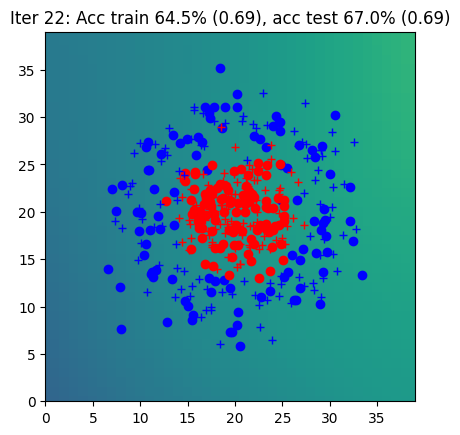

Iter 23: Acc train 65.5% (0.69), acc test 67.0% (0.69)


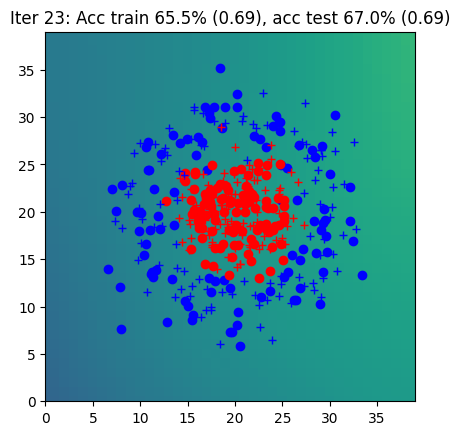

Iter 24: Acc train 63.0% (0.69), acc test 63.0% (0.69)


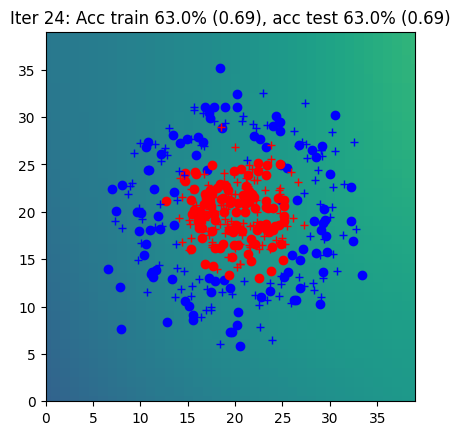

Iter 25: Acc train 64.5% (0.69), acc test 66.5% (0.69)


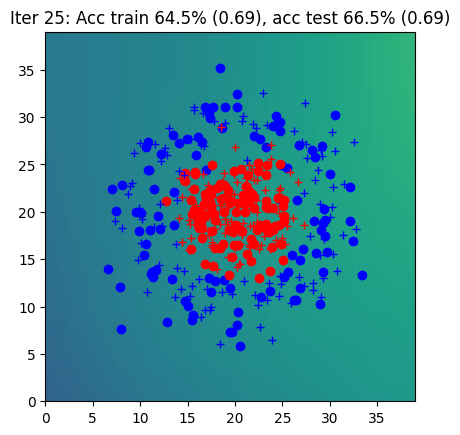

Iter 26: Acc train 64.0% (0.69), acc test 65.5% (0.69)


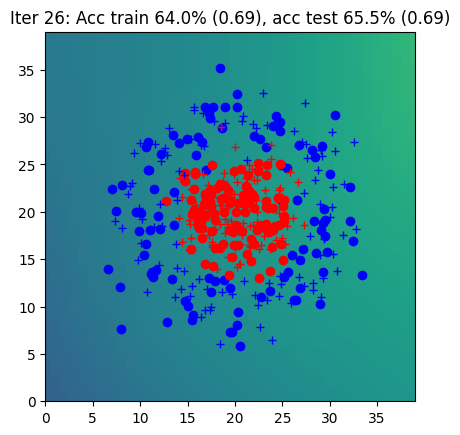

Iter 27: Acc train 64.0% (0.69), acc test 66.5% (0.69)


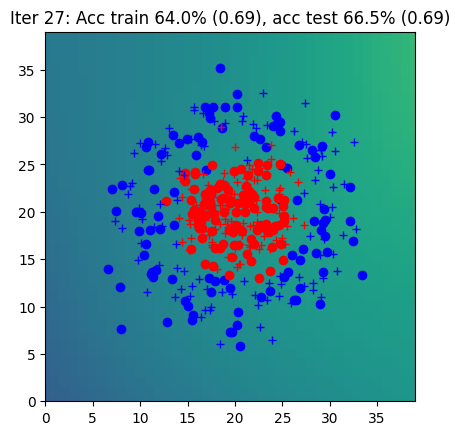

Iter 28: Acc train 64.5% (0.69), acc test 67.5% (0.69)


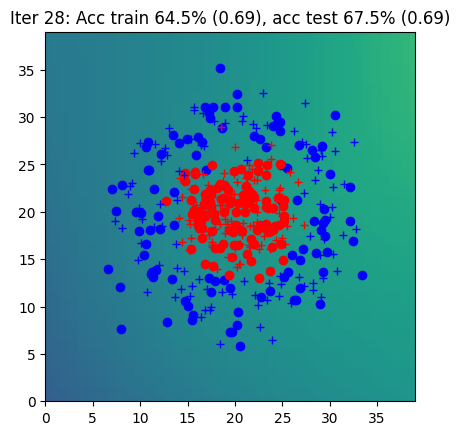

Iter 29: Acc train 65.5% (0.69), acc test 68.5% (0.69)


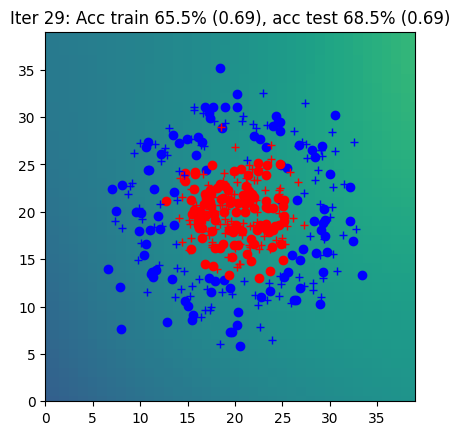

Iter 30: Acc train 68.0% (0.69), acc test 67.5% (0.69)


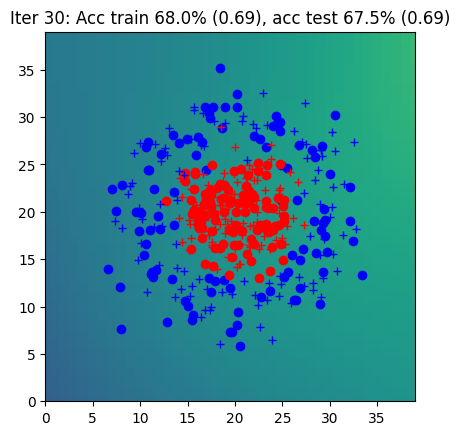

Iter 31: Acc train 65.5% (0.69), acc test 67.5% (0.69)


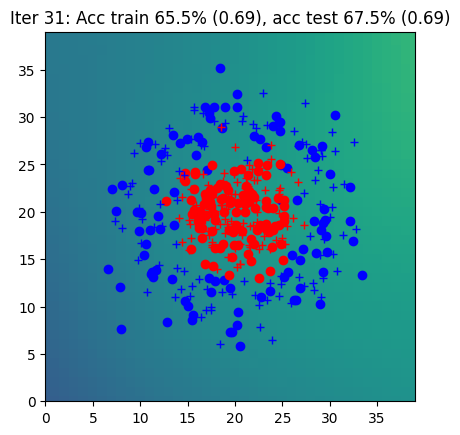

Iter 32: Acc train 65.0% (0.69), acc test 65.0% (0.69)


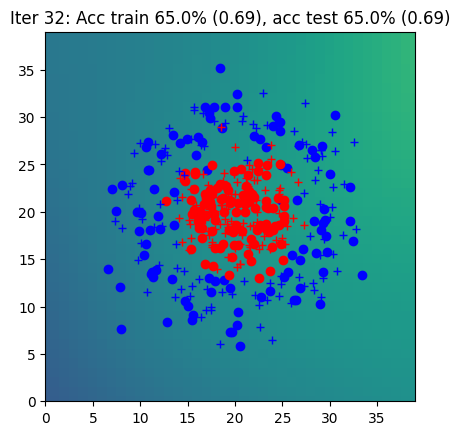

Iter 33: Acc train 64.5% (0.69), acc test 64.5% (0.69)


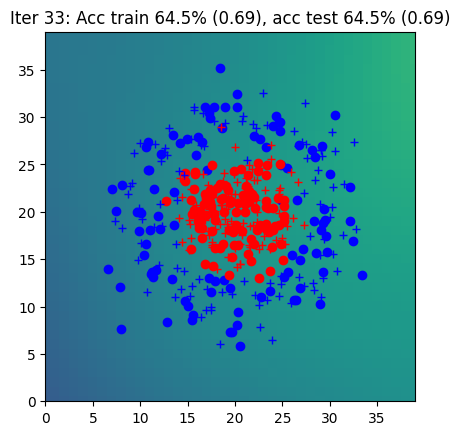

Iter 34: Acc train 69.5% (0.69), acc test 67.5% (0.69)


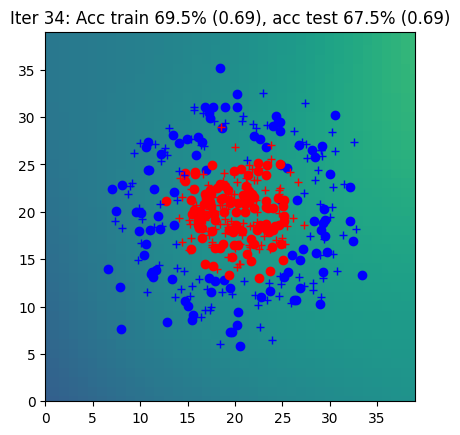

Iter 35: Acc train 70.0% (0.69), acc test 68.0% (0.69)


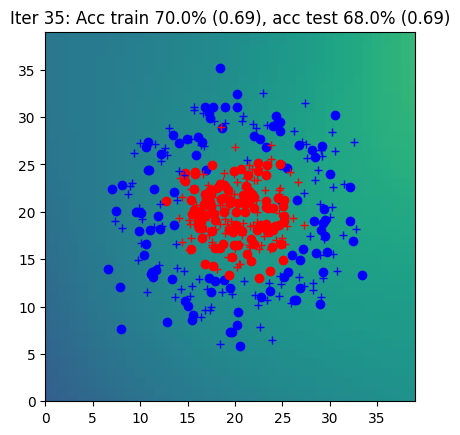

Iter 36: Acc train 72.0% (0.69), acc test 69.0% (0.69)


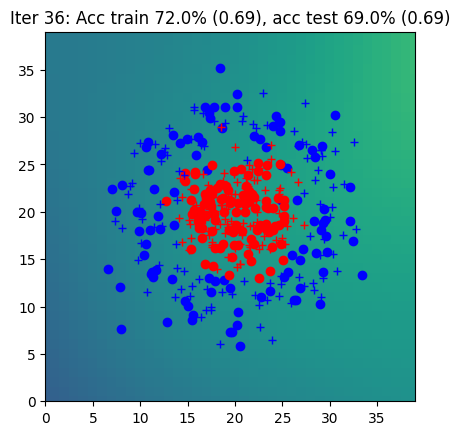

Iter 37: Acc train 70.5% (0.69), acc test 68.5% (0.69)


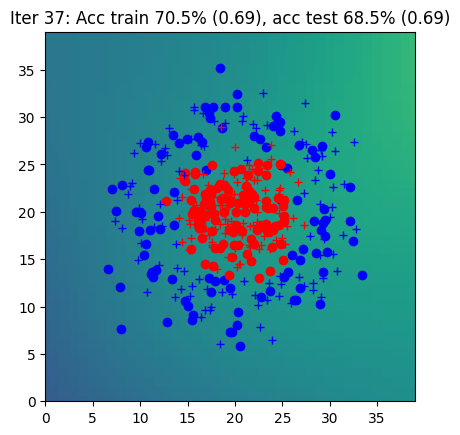

Iter 38: Acc train 71.0% (0.69), acc test 69.0% (0.69)


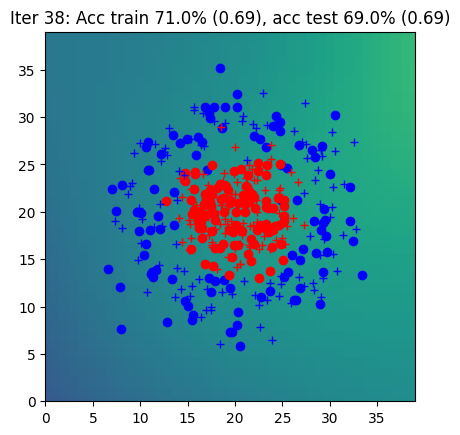

Iter 39: Acc train 71.0% (0.69), acc test 69.5% (0.69)


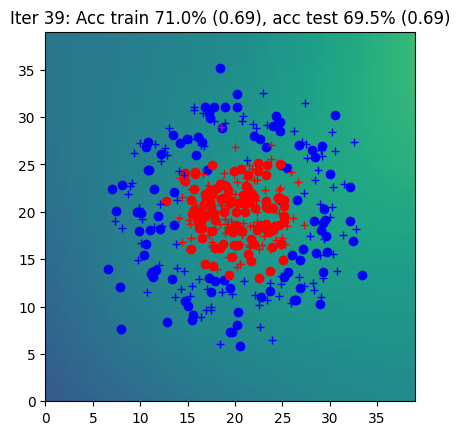

Iter 40: Acc train 71.5% (0.69), acc test 68.5% (0.69)


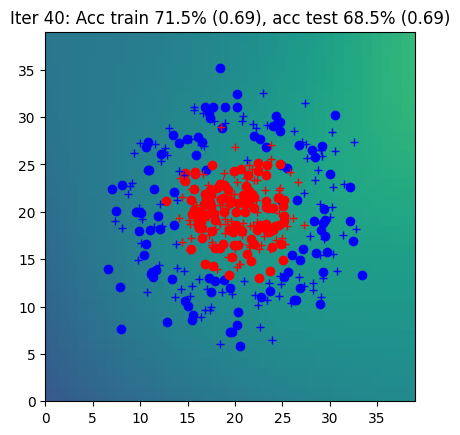

Iter 41: Acc train 71.5% (0.68), acc test 69.5% (0.69)


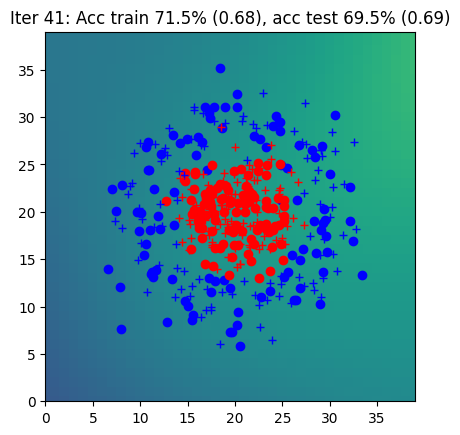

Iter 42: Acc train 72.0% (0.68), acc test 71.5% (0.69)


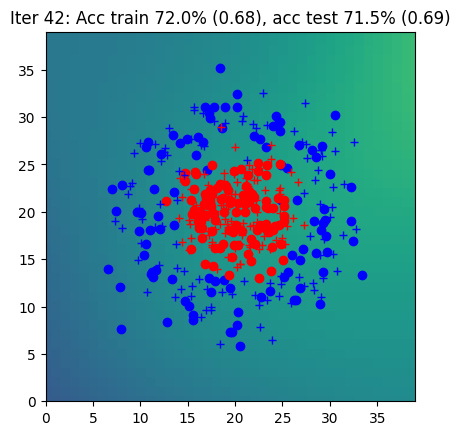

Iter 43: Acc train 71.5% (0.68), acc test 68.0% (0.69)


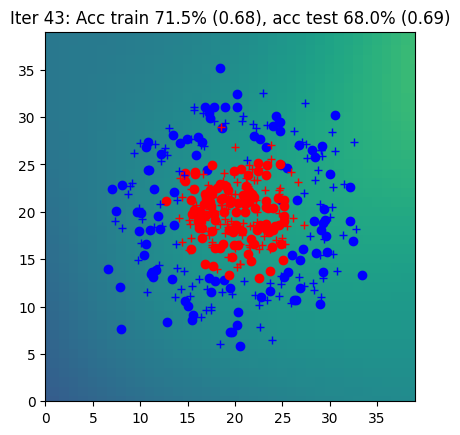

Iter 44: Acc train 73.5% (0.68), acc test 71.0% (0.69)


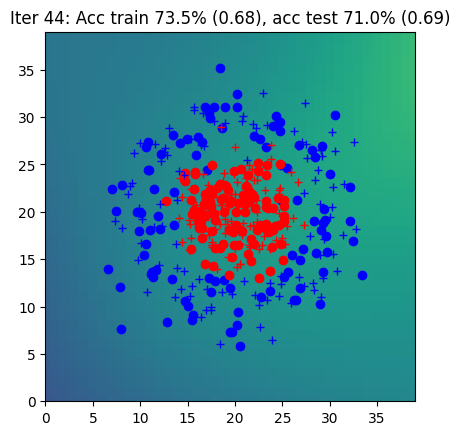

Iter 45: Acc train 72.5% (0.68), acc test 69.5% (0.68)


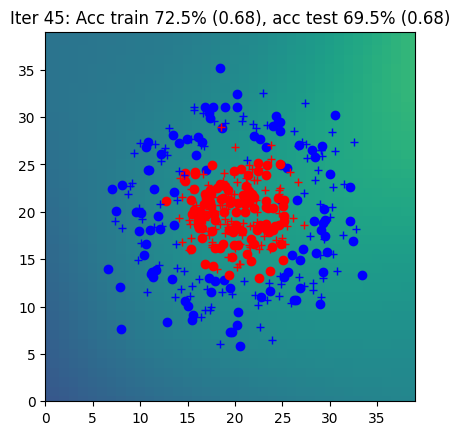

Iter 46: Acc train 73.5% (0.68), acc test 70.5% (0.68)


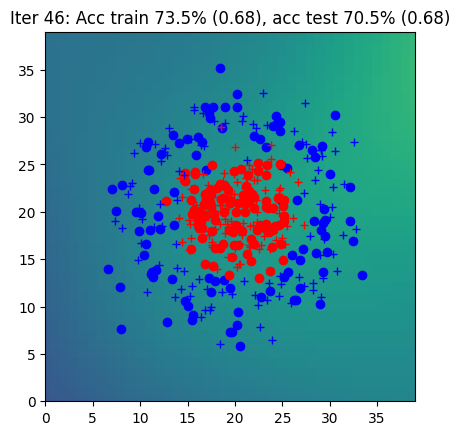

Iter 47: Acc train 73.0% (0.68), acc test 71.0% (0.68)


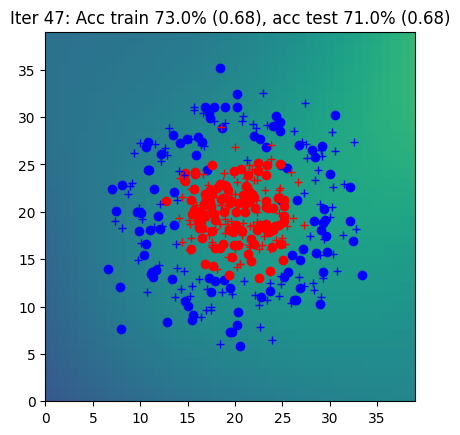

Iter 48: Acc train 71.5% (0.68), acc test 69.5% (0.68)


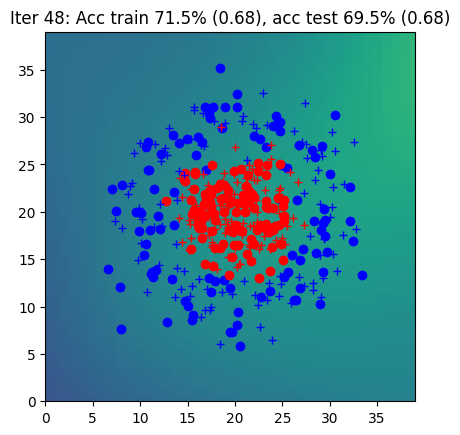

Iter 49: Acc train 72.0% (0.68), acc test 71.0% (0.68)


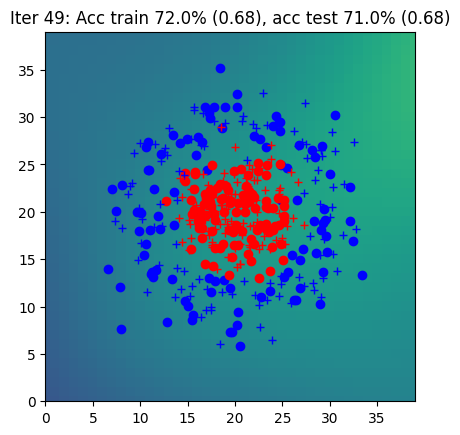

Iter 50: Acc train 73.0% (0.68), acc test 71.0% (0.68)


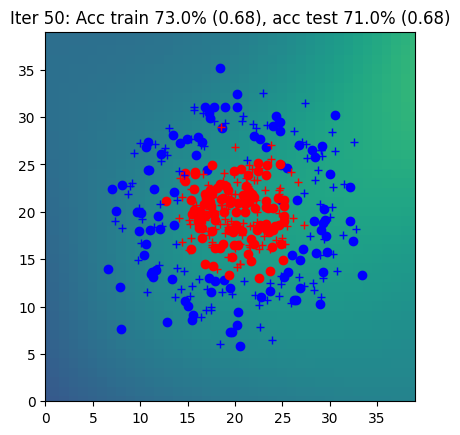

Iter 51: Acc train 72.0% (0.68), acc test 69.0% (0.68)


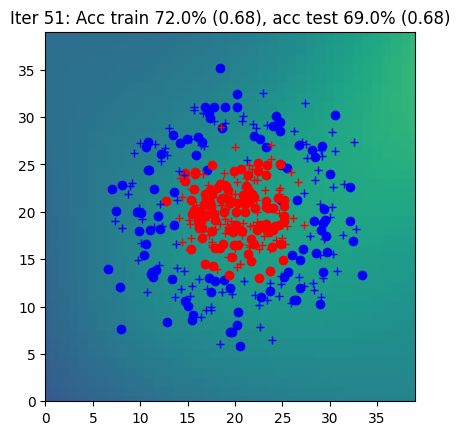

Iter 52: Acc train 72.5% (0.68), acc test 71.5% (0.68)


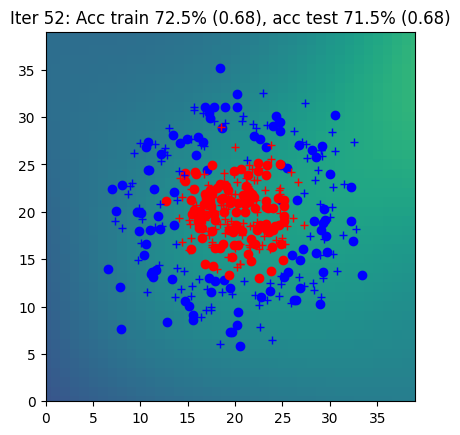

Iter 53: Acc train 72.5% (0.68), acc test 71.5% (0.68)


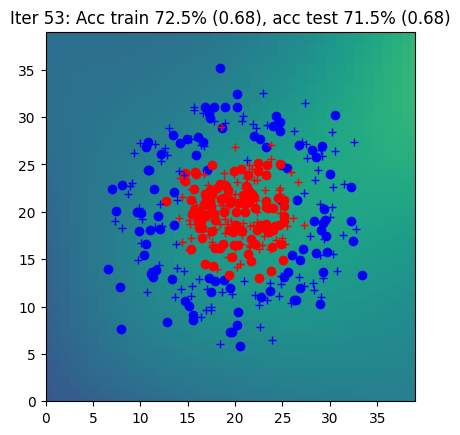

Iter 54: Acc train 73.0% (0.68), acc test 72.0% (0.68)


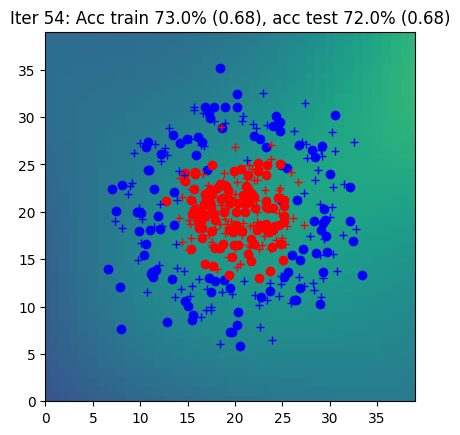

Iter 55: Acc train 72.5% (0.68), acc test 72.0% (0.68)


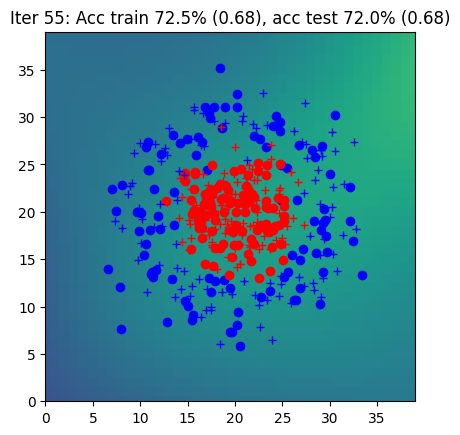

Iter 56: Acc train 73.0% (0.68), acc test 71.5% (0.68)


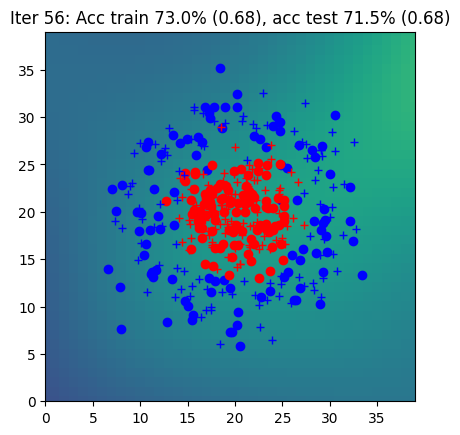

Iter 57: Acc train 75.0% (0.68), acc test 74.5% (0.68)


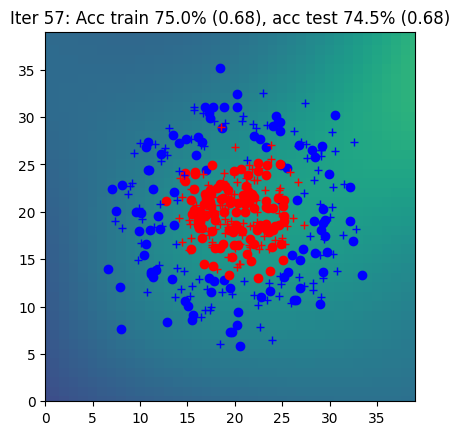

Iter 58: Acc train 74.0% (0.67), acc test 72.0% (0.68)


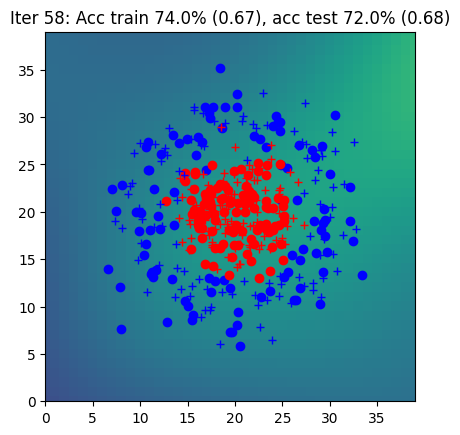

Iter 59: Acc train 73.5% (0.67), acc test 72.5% (0.68)


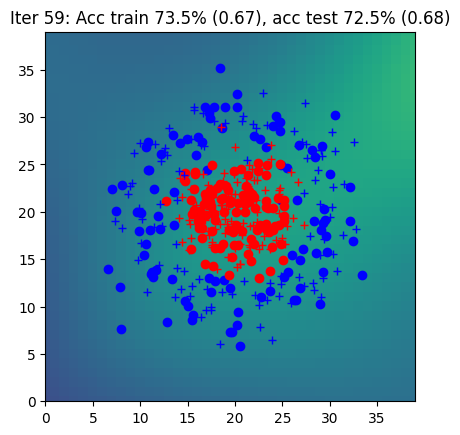

Iter 60: Acc train 72.0% (0.67), acc test 67.5% (0.67)


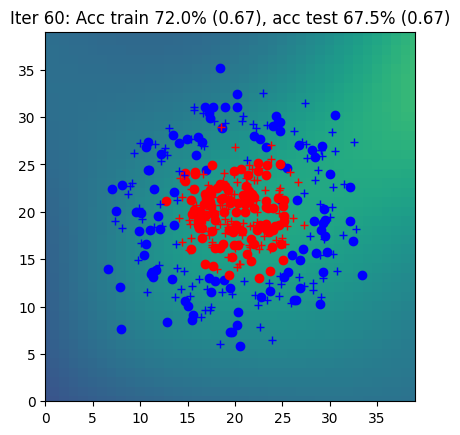

Iter 61: Acc train 72.0% (0.67), acc test 70.5% (0.67)


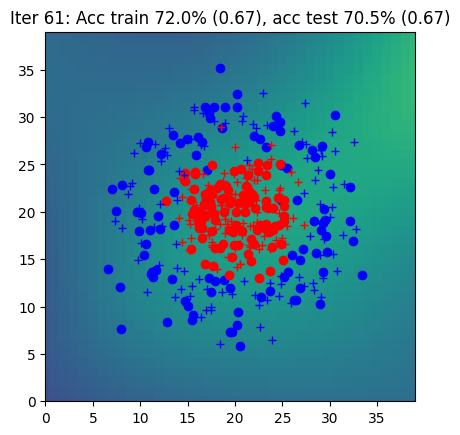

Iter 62: Acc train 75.0% (0.67), acc test 72.5% (0.67)


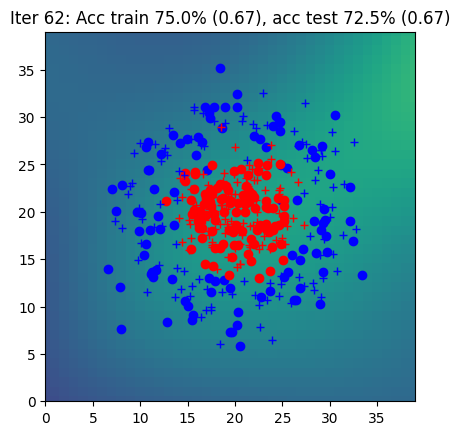

Iter 63: Acc train 77.0% (0.67), acc test 72.5% (0.67)


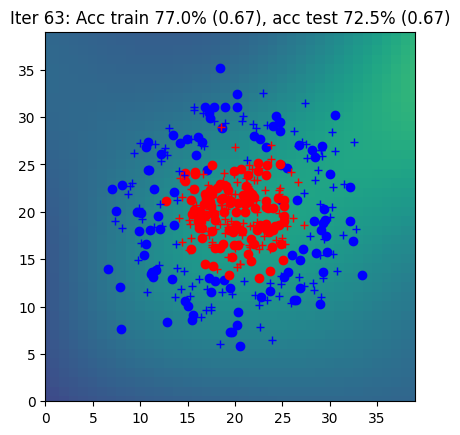

Iter 64: Acc train 73.5% (0.67), acc test 71.5% (0.67)


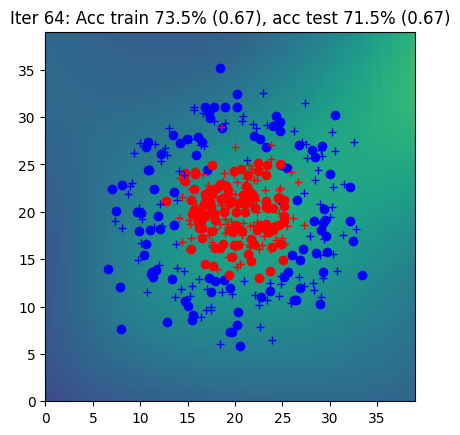

Iter 65: Acc train 77.5% (0.67), acc test 73.5% (0.67)


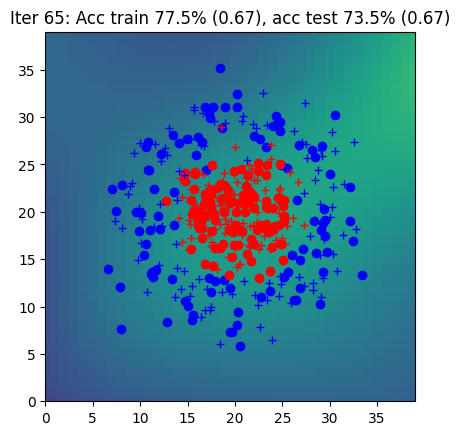

Iter 66: Acc train 78.0% (0.66), acc test 74.5% (0.67)


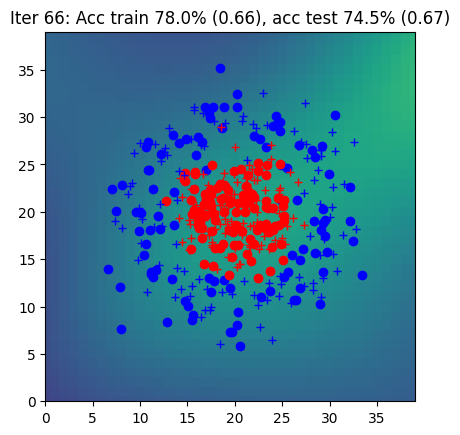

Iter 67: Acc train 78.5% (0.66), acc test 76.5% (0.67)


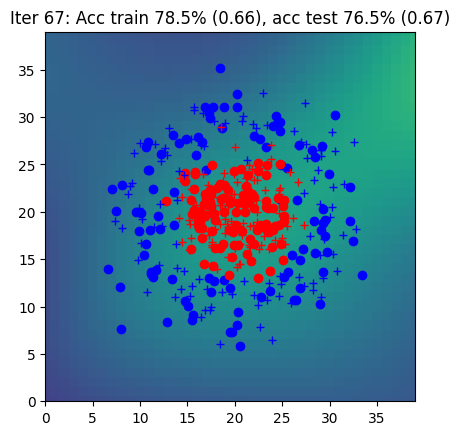

Iter 68: Acc train 76.5% (0.66), acc test 72.5% (0.66)


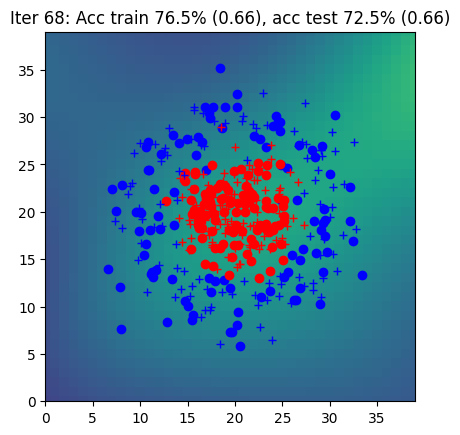

Iter 69: Acc train 76.5% (0.66), acc test 72.5% (0.66)


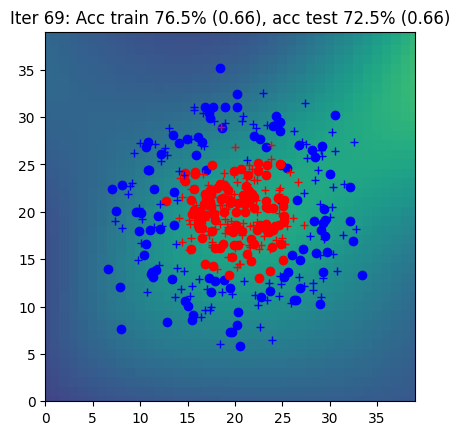

Iter 70: Acc train 71.0% (0.66), acc test 69.0% (0.66)


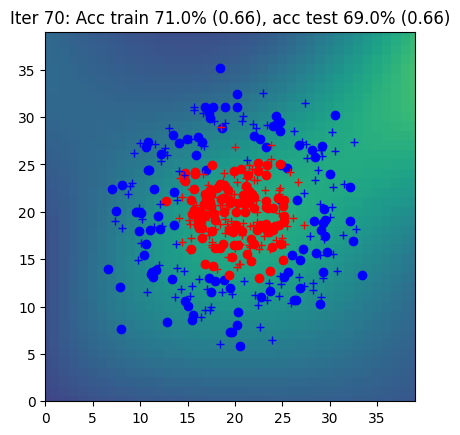

Iter 71: Acc train 73.5% (0.66), acc test 69.0% (0.66)


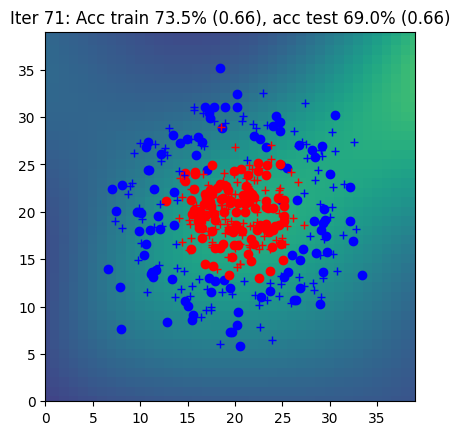

Iter 72: Acc train 76.5% (0.65), acc test 73.0% (0.66)


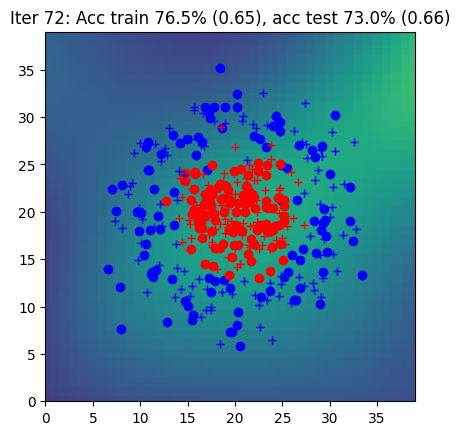

Iter 73: Acc train 73.0% (0.65), acc test 70.5% (0.66)


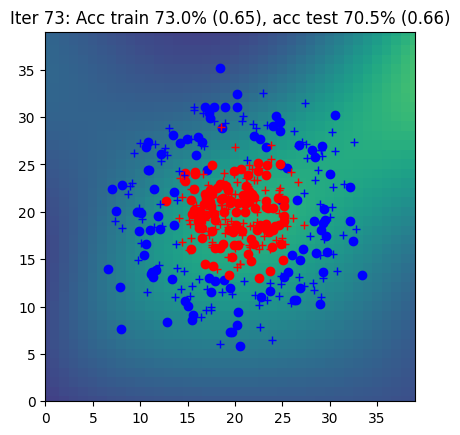

Iter 74: Acc train 74.5% (0.65), acc test 71.0% (0.65)


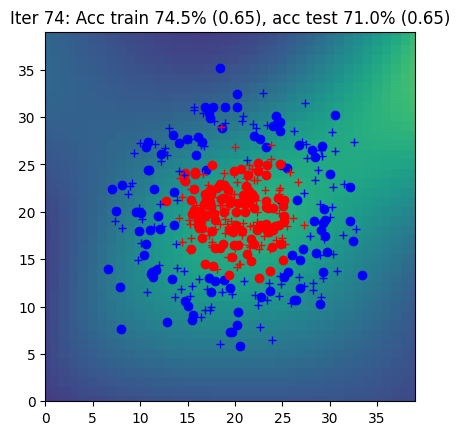

Iter 75: Acc train 79.5% (0.65), acc test 77.5% (0.65)


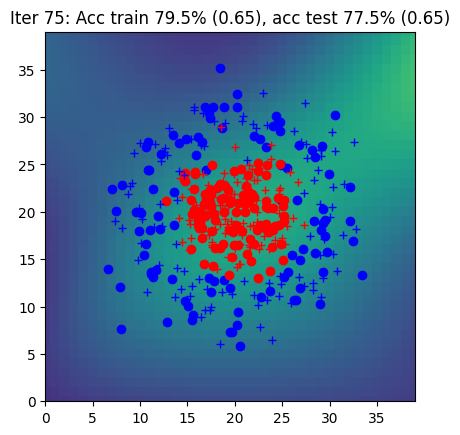

Iter 76: Acc train 78.5% (0.65), acc test 77.5% (0.65)


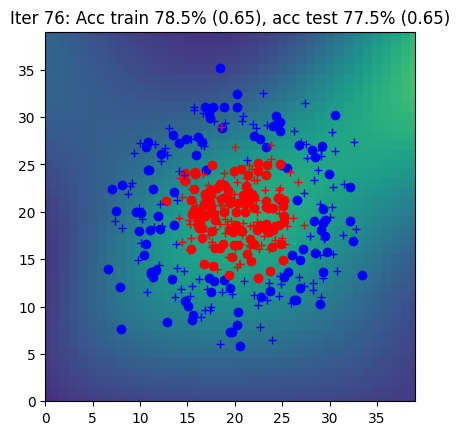

Iter 77: Acc train 81.0% (0.64), acc test 77.5% (0.65)


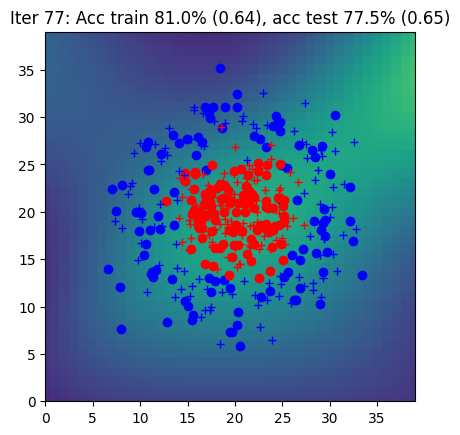

Iter 78: Acc train 79.5% (0.64), acc test 77.5% (0.64)


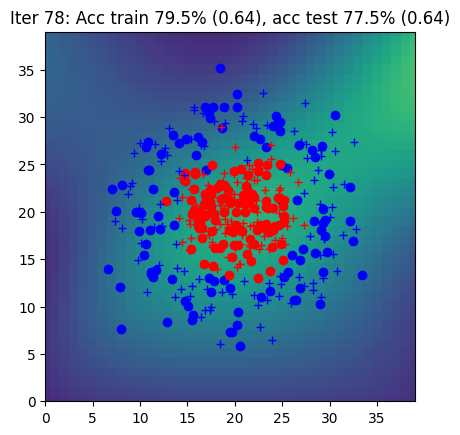

Iter 79: Acc train 79.0% (0.64), acc test 77.5% (0.64)


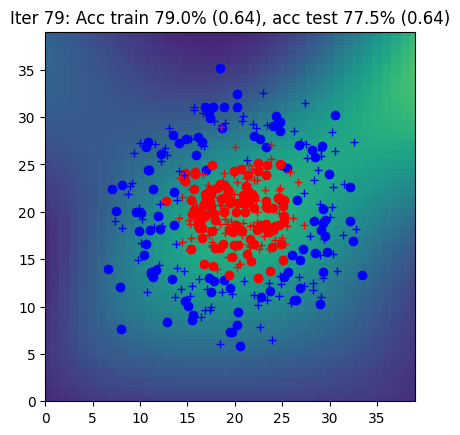

Iter 80: Acc train 79.0% (0.63), acc test 76.5% (0.64)


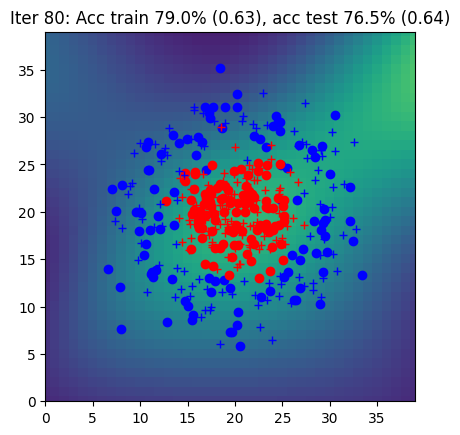

Iter 81: Acc train 79.0% (0.63), acc test 77.5% (0.64)


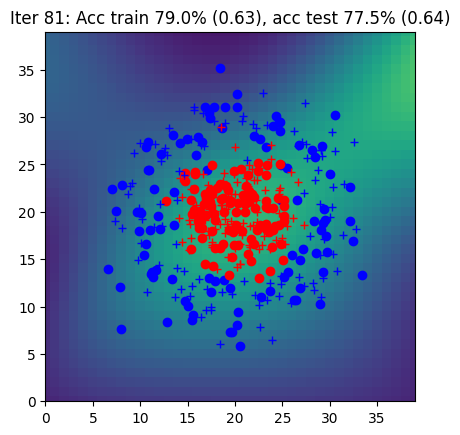

Iter 82: Acc train 81.0% (0.63), acc test 79.5% (0.63)


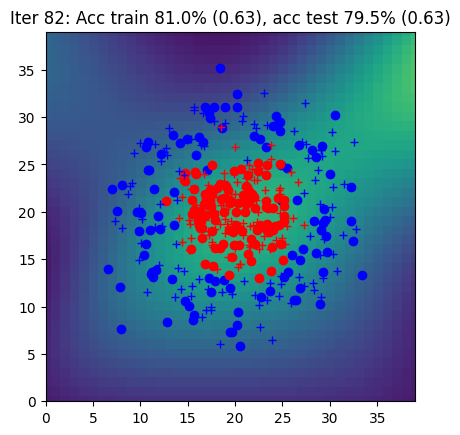

Iter 83: Acc train 80.0% (0.63), acc test 79.5% (0.63)


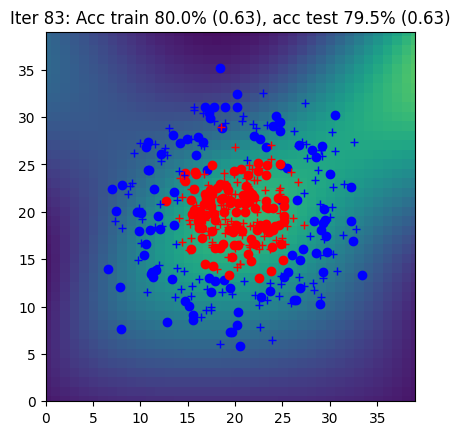

Iter 84: Acc train 80.5% (0.62), acc test 79.0% (0.63)


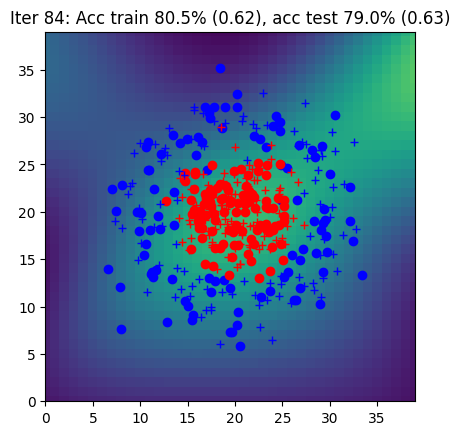

Iter 85: Acc train 81.5% (0.62), acc test 79.5% (0.62)


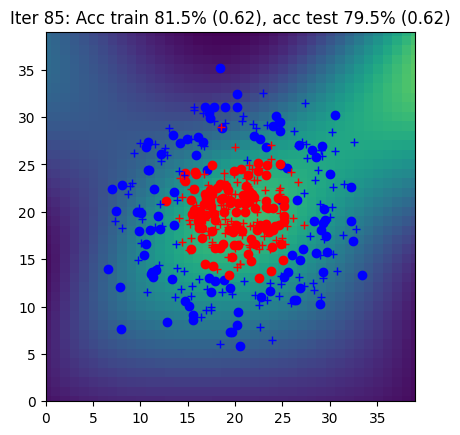

Iter 86: Acc train 81.0% (0.62), acc test 80.0% (0.62)


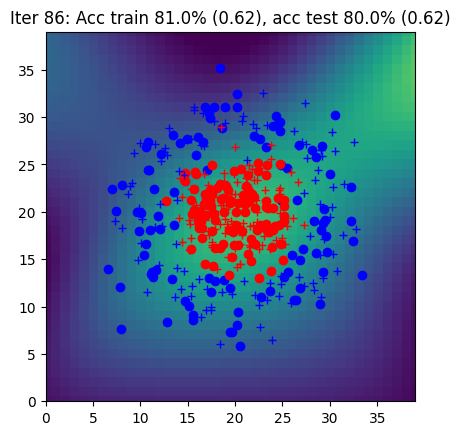

Iter 87: Acc train 78.0% (0.61), acc test 78.0% (0.62)


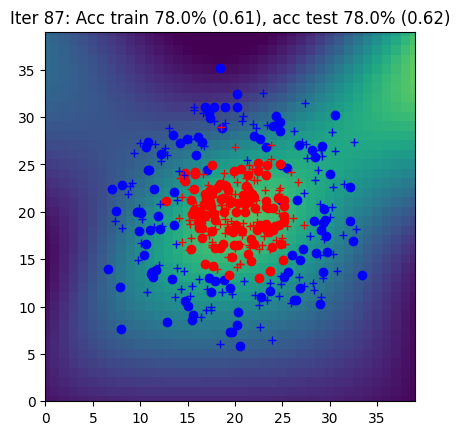

Iter 88: Acc train 80.5% (0.61), acc test 78.5% (0.61)


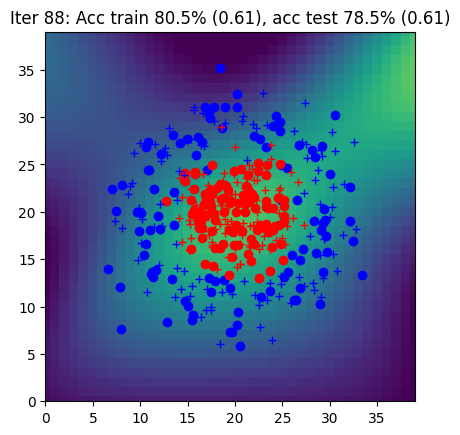

Iter 89: Acc train 80.0% (0.60), acc test 78.5% (0.61)


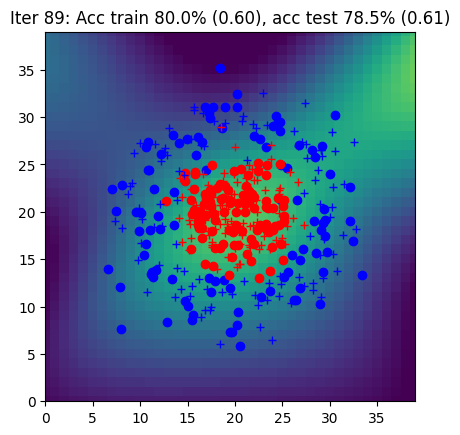

Iter 90: Acc train 79.0% (0.60), acc test 77.5% (0.61)


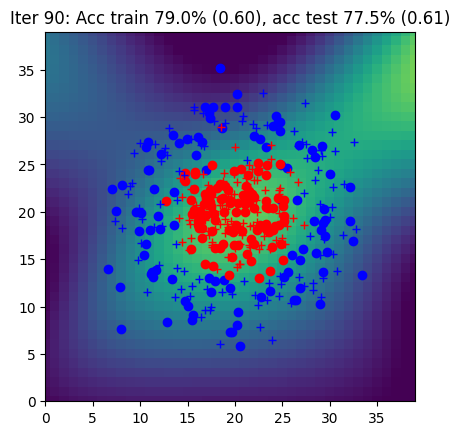

Iter 91: Acc train 79.0% (0.60), acc test 77.5% (0.60)


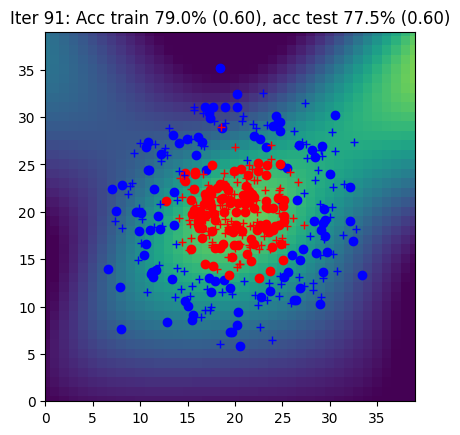

Iter 92: Acc train 81.0% (0.59), acc test 80.5% (0.60)


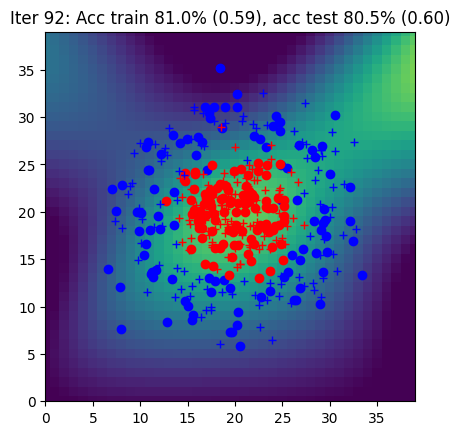

Iter 93: Acc train 85.5% (0.59), acc test 84.0% (0.59)


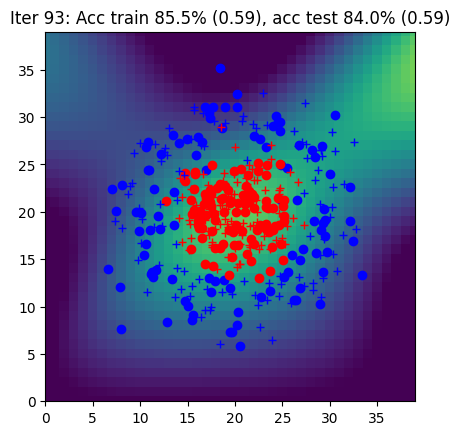

Iter 94: Acc train 86.5% (0.58), acc test 83.5% (0.59)


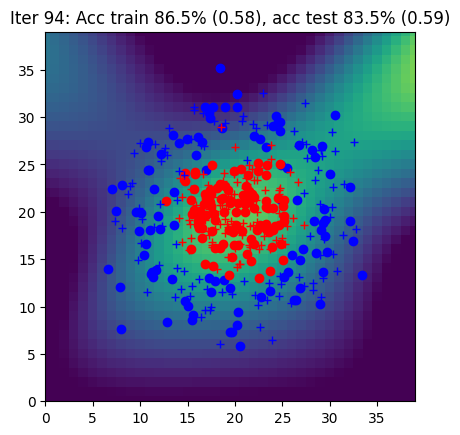

Iter 95: Acc train 86.0% (0.58), acc test 83.0% (0.58)


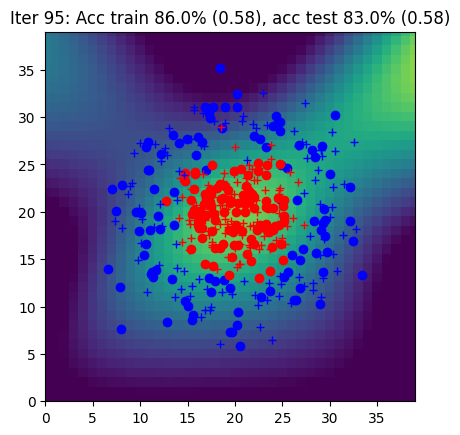

Iter 96: Acc train 83.0% (0.57), acc test 80.5% (0.58)


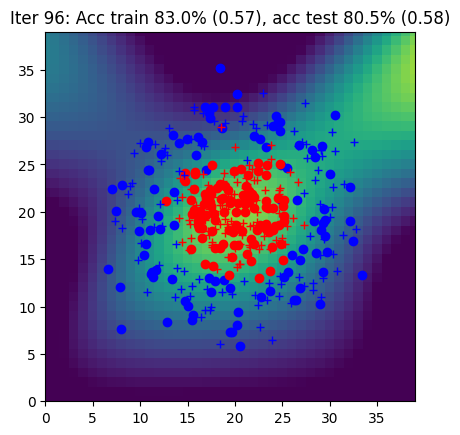

Iter 97: Acc train 83.5% (0.57), acc test 81.0% (0.58)


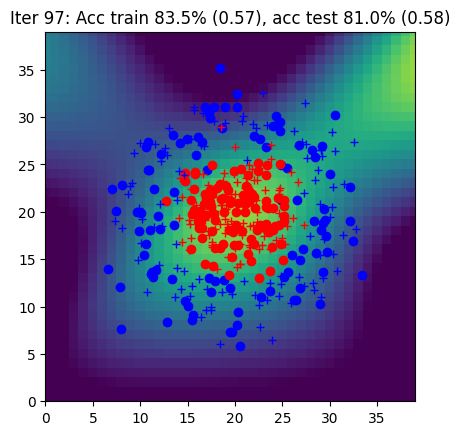

Iter 98: Acc train 85.5% (0.56), acc test 82.0% (0.57)


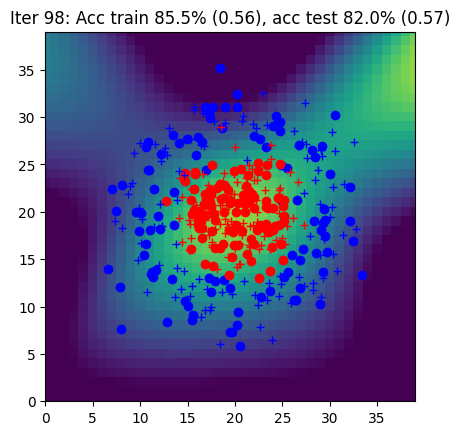

Iter 99: Acc train 87.5% (0.56), acc test 84.5% (0.57)


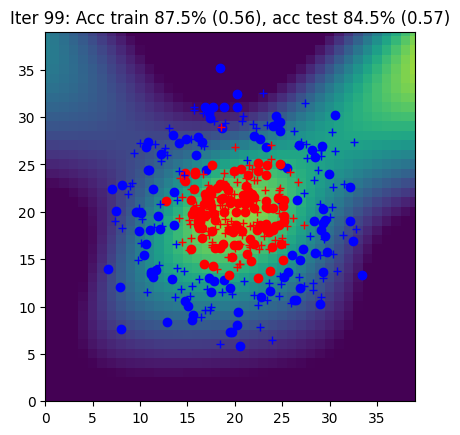

Iter 100: Acc train 86.5% (0.55), acc test 84.0% (0.56)


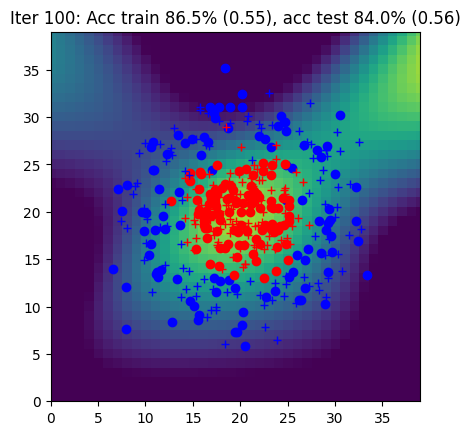

Iter 101: Acc train 86.5% (0.55), acc test 84.0% (0.56)


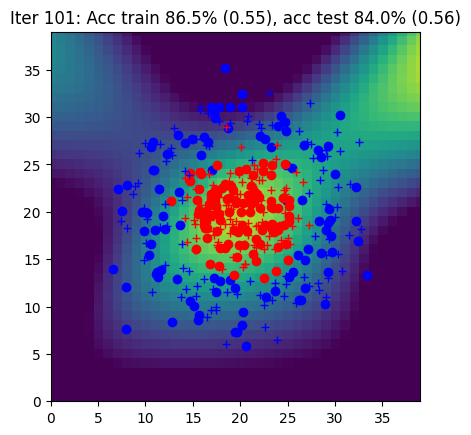

Iter 102: Acc train 89.0% (0.54), acc test 86.0% (0.55)


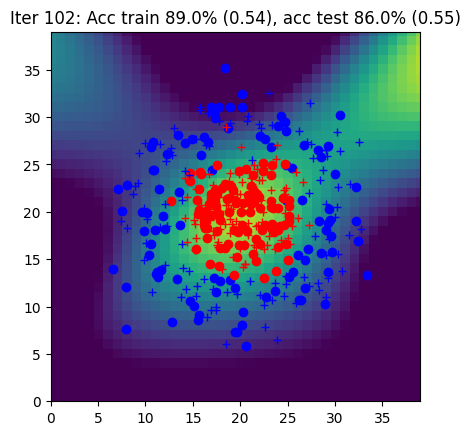

Iter 103: Acc train 89.0% (0.54), acc test 86.0% (0.55)


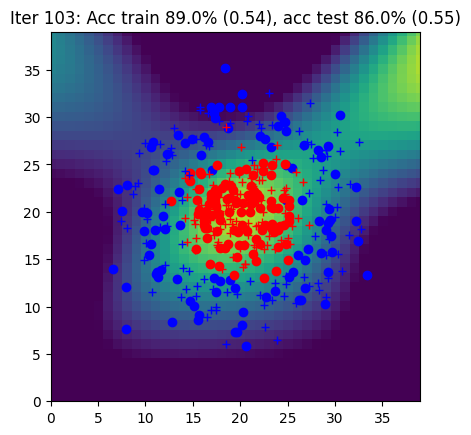

Iter 104: Acc train 88.5% (0.53), acc test 85.5% (0.54)


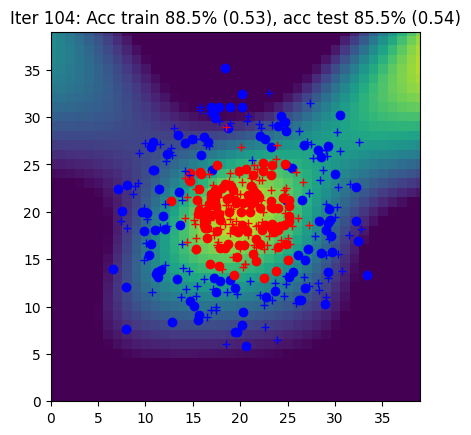

Iter 105: Acc train 89.5% (0.53), acc test 86.0% (0.54)


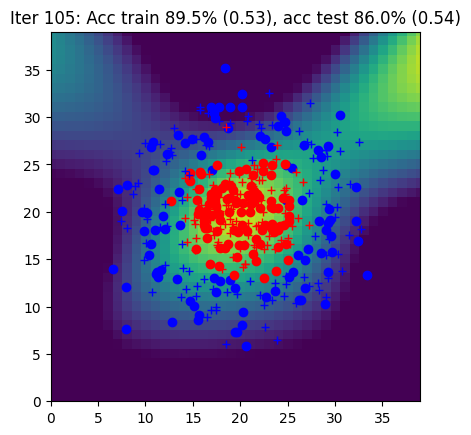

Iter 106: Acc train 89.5% (0.52), acc test 86.0% (0.53)


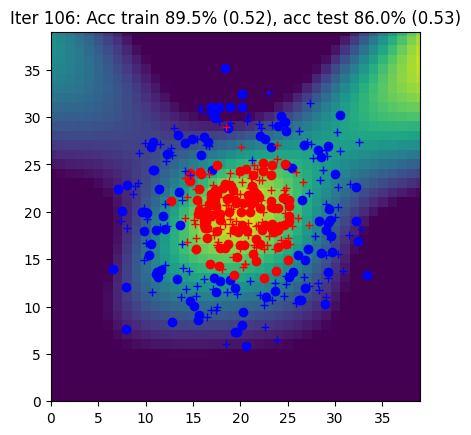

Iter 107: Acc train 90.5% (0.52), acc test 87.0% (0.53)


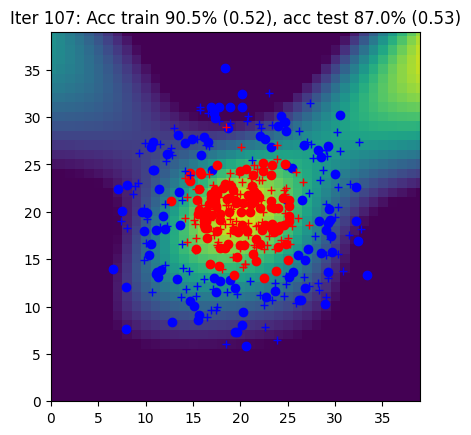

Iter 108: Acc train 90.0% (0.51), acc test 86.5% (0.52)


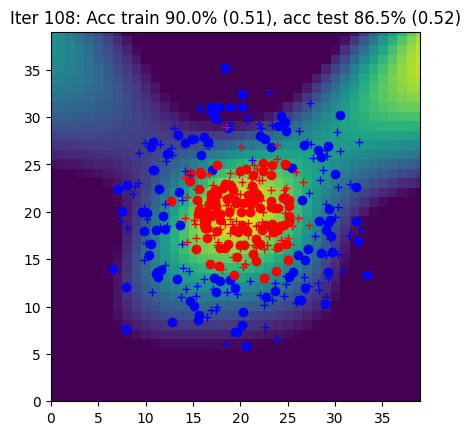

Iter 109: Acc train 91.5% (0.51), acc test 88.0% (0.52)


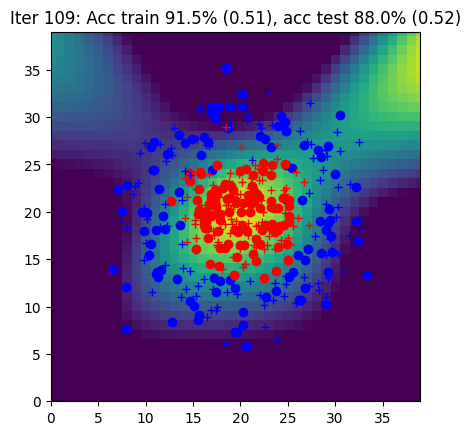

Iter 110: Acc train 92.0% (0.50), acc test 88.0% (0.51)


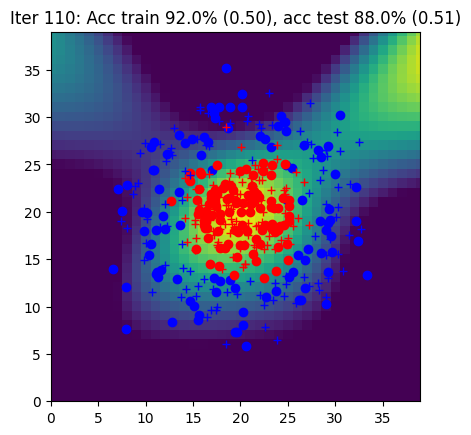

Iter 111: Acc train 92.5% (0.49), acc test 89.0% (0.50)


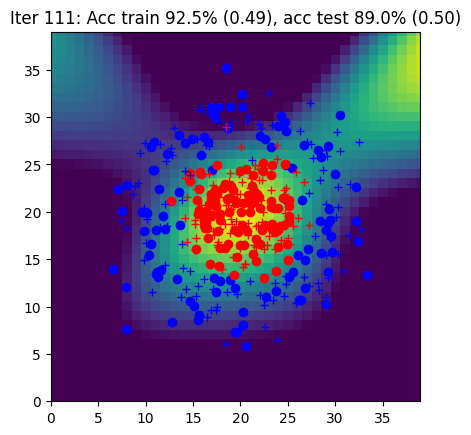

Iter 112: Acc train 90.5% (0.49), acc test 87.5% (0.50)


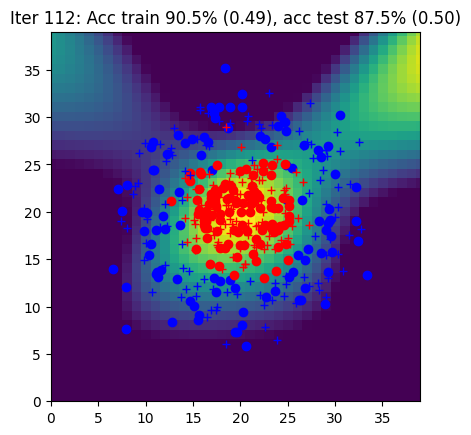

Iter 113: Acc train 93.0% (0.48), acc test 92.0% (0.49)


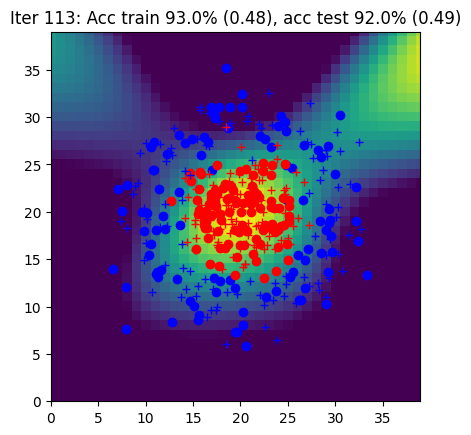

Iter 114: Acc train 91.0% (0.48), acc test 89.0% (0.49)


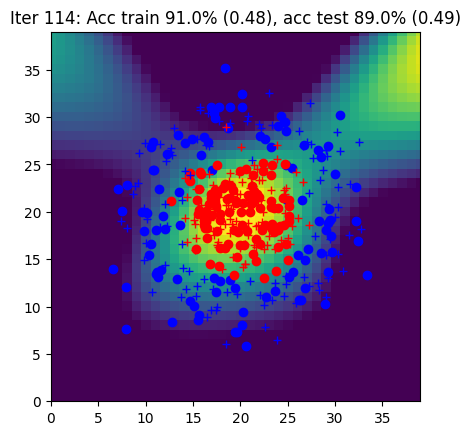

Iter 115: Acc train 92.0% (0.47), acc test 90.0% (0.48)


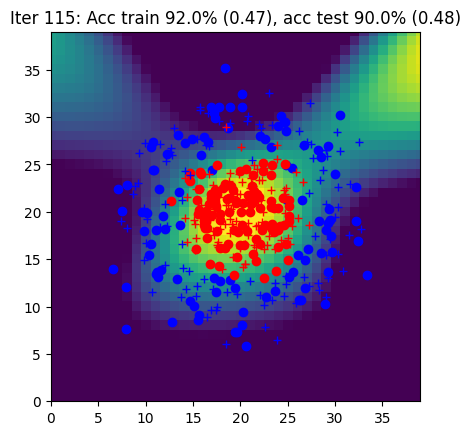

Iter 116: Acc train 90.5% (0.47), acc test 86.0% (0.48)


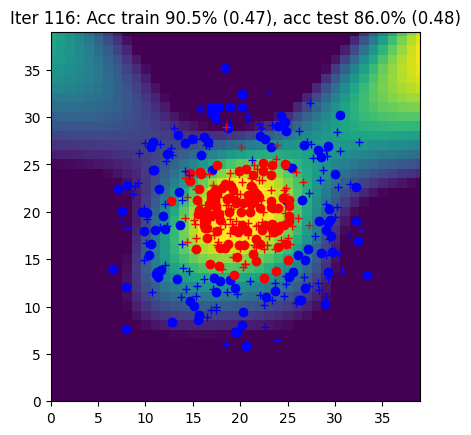

Iter 117: Acc train 93.0% (0.46), acc test 91.5% (0.47)


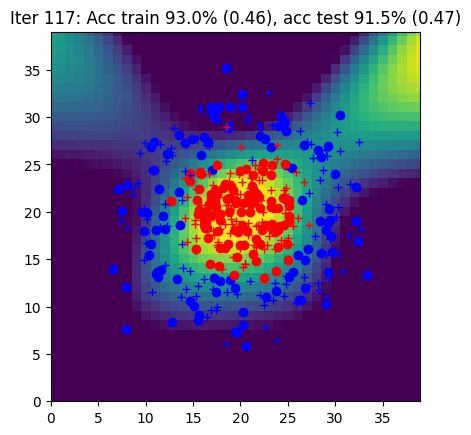

Iter 118: Acc train 93.5% (0.45), acc test 91.5% (0.47)


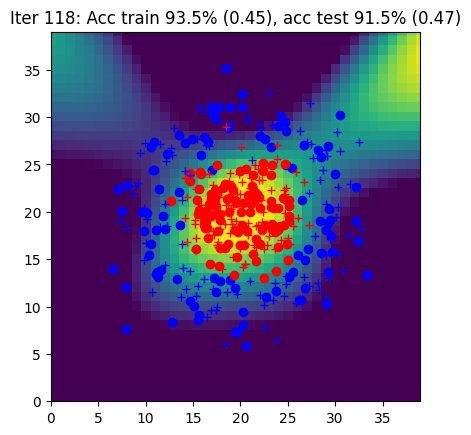

Iter 119: Acc train 93.0% (0.45), acc test 91.0% (0.46)


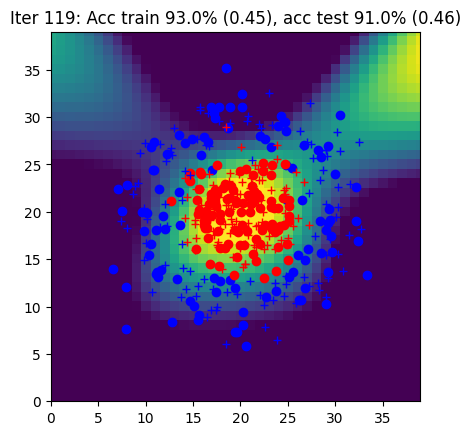

Iter 120: Acc train 92.0% (0.44), acc test 89.5% (0.46)


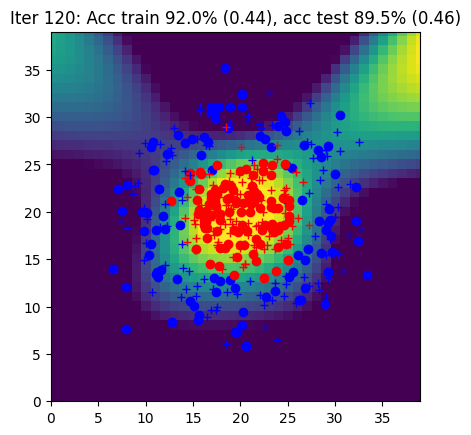

Iter 121: Acc train 93.5% (0.44), acc test 94.0% (0.45)


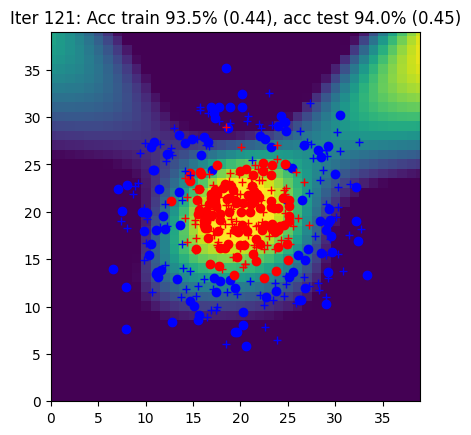

Iter 122: Acc train 94.0% (0.43), acc test 94.5% (0.45)


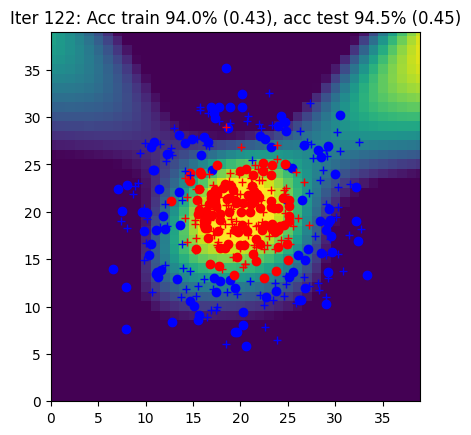

Iter 123: Acc train 93.5% (0.43), acc test 93.0% (0.44)


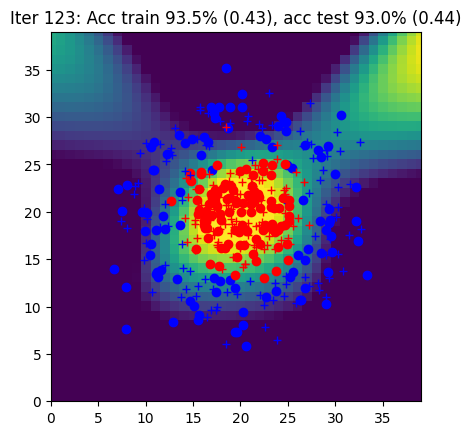

Iter 124: Acc train 93.5% (0.42), acc test 92.0% (0.44)


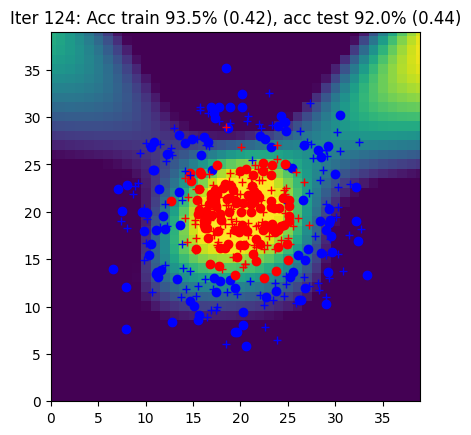

Iter 125: Acc train 94.0% (0.42), acc test 93.0% (0.43)


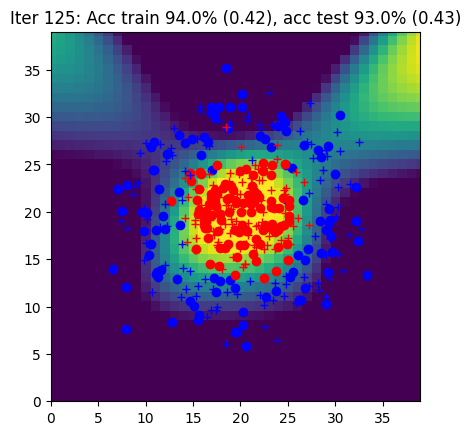

Iter 126: Acc train 94.0% (0.41), acc test 94.5% (0.43)


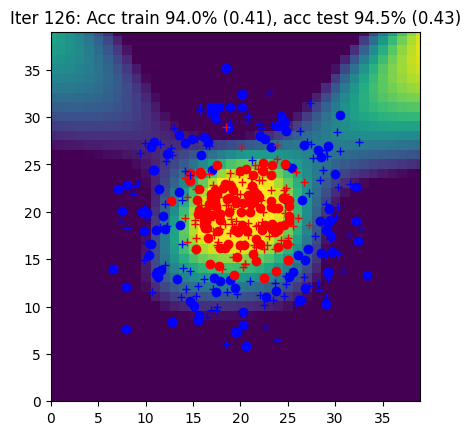

Iter 127: Acc train 94.0% (0.41), acc test 93.5% (0.42)


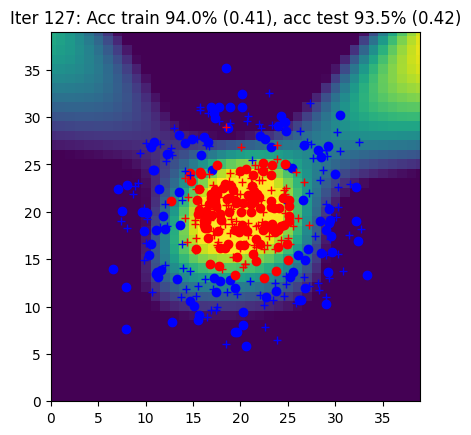

Iter 128: Acc train 94.0% (0.40), acc test 94.5% (0.42)


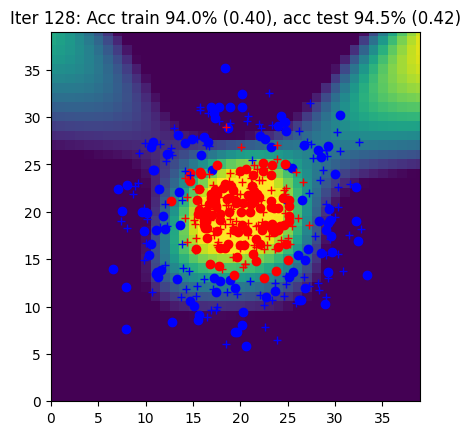

Iter 129: Acc train 94.5% (0.40), acc test 94.0% (0.41)


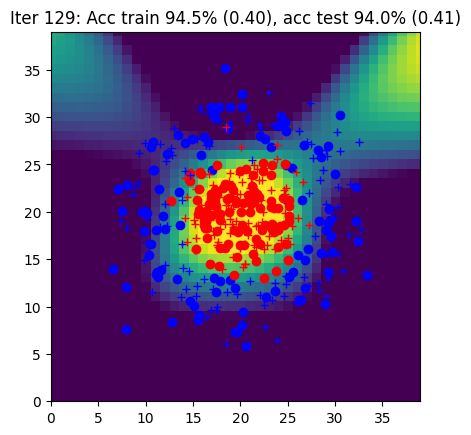

Iter 130: Acc train 94.5% (0.39), acc test 95.0% (0.41)


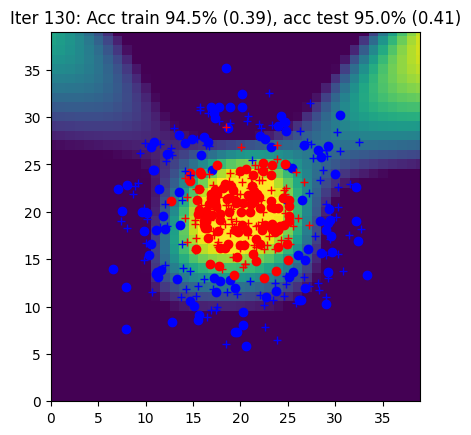

Iter 131: Acc train 94.5% (0.39), acc test 95.0% (0.40)


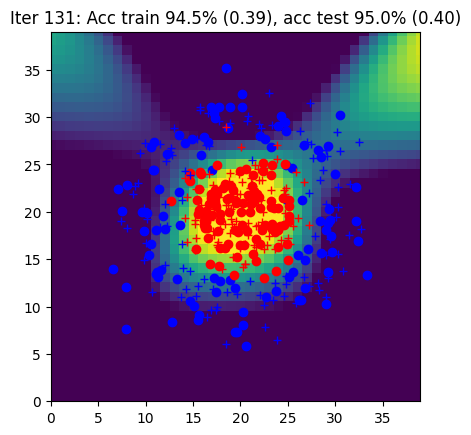

Iter 132: Acc train 94.5% (0.38), acc test 94.5% (0.40)


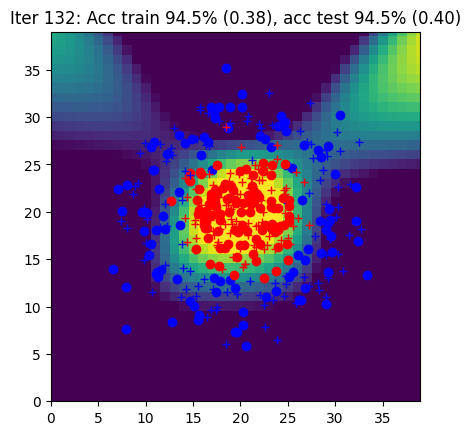

Iter 133: Acc train 94.5% (0.38), acc test 94.5% (0.39)


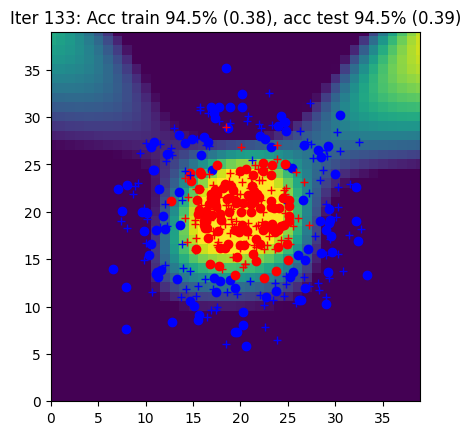

Iter 134: Acc train 94.5% (0.37), acc test 94.5% (0.39)


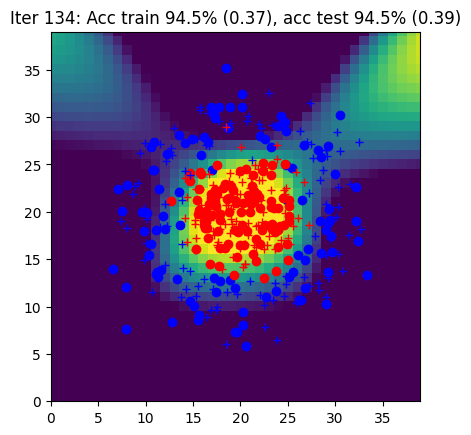

Iter 135: Acc train 94.0% (0.37), acc test 94.0% (0.38)


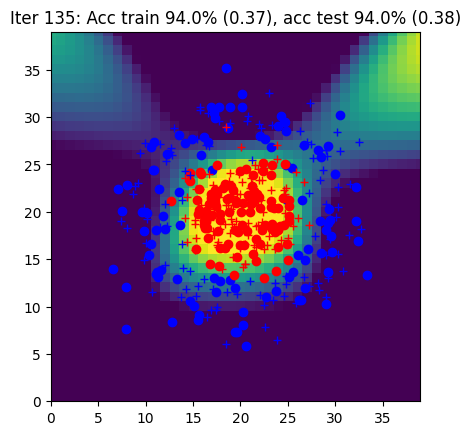

Iter 136: Acc train 94.5% (0.36), acc test 94.0% (0.38)


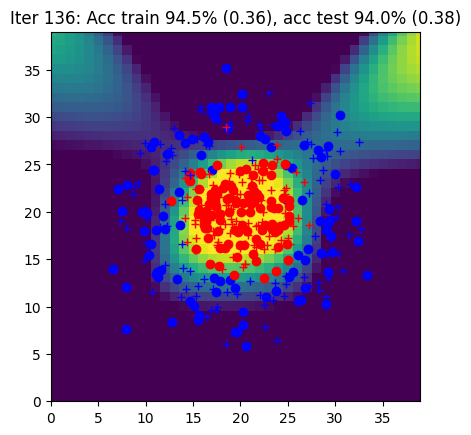

Iter 137: Acc train 95.0% (0.36), acc test 94.0% (0.38)


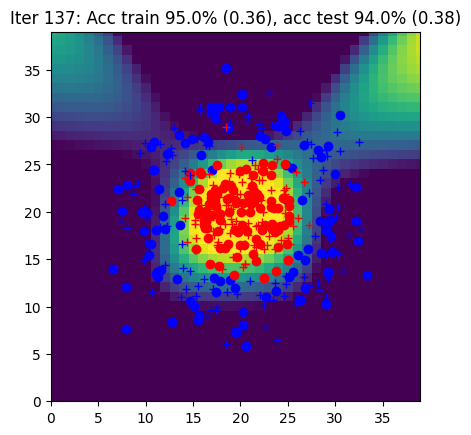

Iter 138: Acc train 95.0% (0.35), acc test 95.0% (0.37)


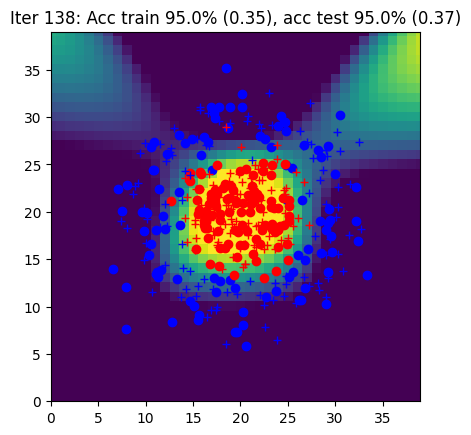

Iter 139: Acc train 95.0% (0.35), acc test 94.0% (0.37)


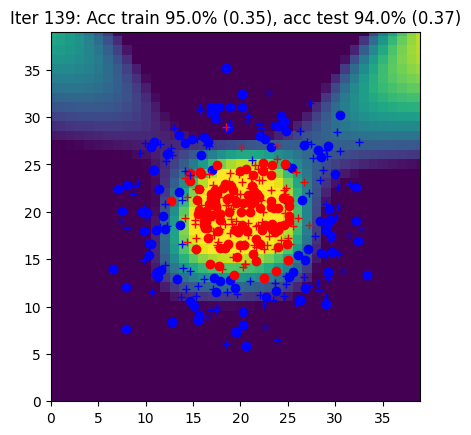

Iter 140: Acc train 95.0% (0.35), acc test 95.0% (0.36)


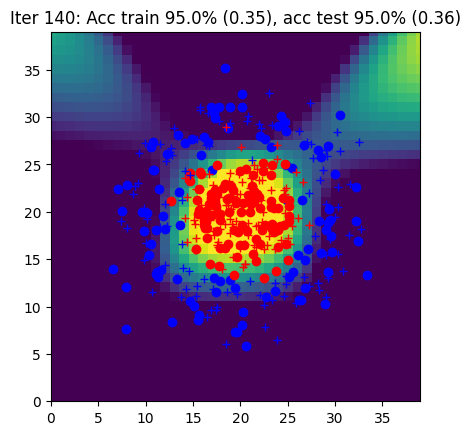

Iter 141: Acc train 95.0% (0.34), acc test 95.0% (0.36)


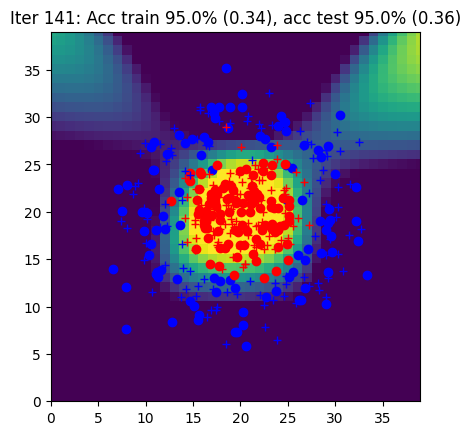

Iter 142: Acc train 95.0% (0.34), acc test 95.0% (0.36)


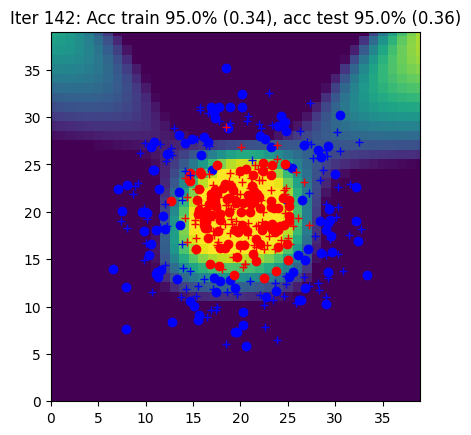

Iter 143: Acc train 95.5% (0.33), acc test 95.0% (0.35)


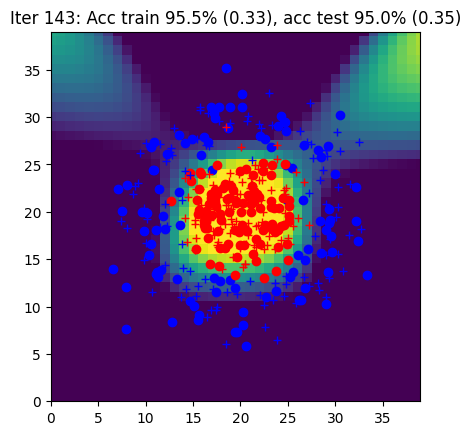

Iter 144: Acc train 95.5% (0.33), acc test 95.0% (0.35)


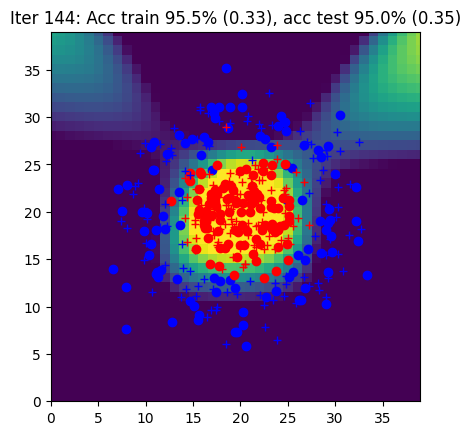

Iter 145: Acc train 96.0% (0.33), acc test 95.0% (0.35)


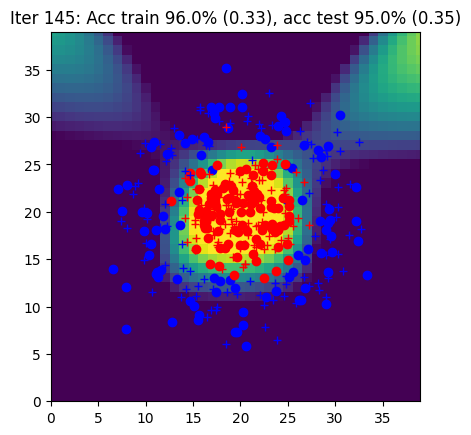

Iter 146: Acc train 95.0% (0.32), acc test 94.5% (0.34)


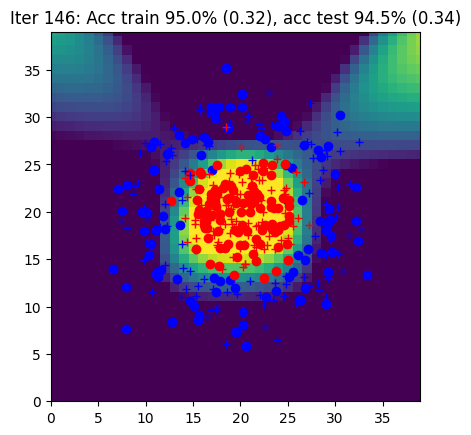

Iter 147: Acc train 96.0% (0.32), acc test 94.5% (0.34)


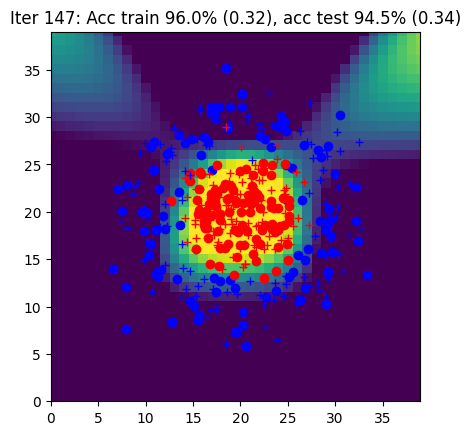

Iter 148: Acc train 96.5% (0.32), acc test 95.0% (0.33)


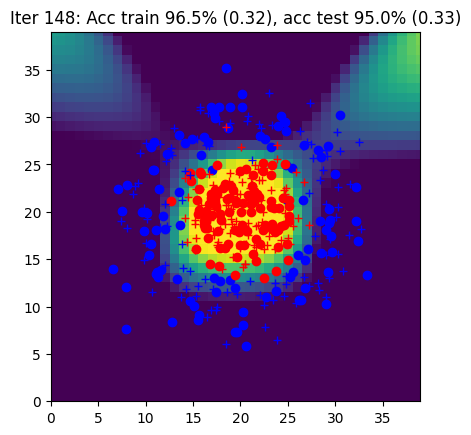

Iter 149: Acc train 95.0% (0.31), acc test 94.0% (0.33)


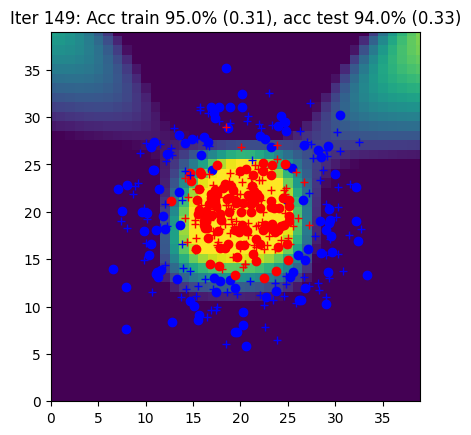

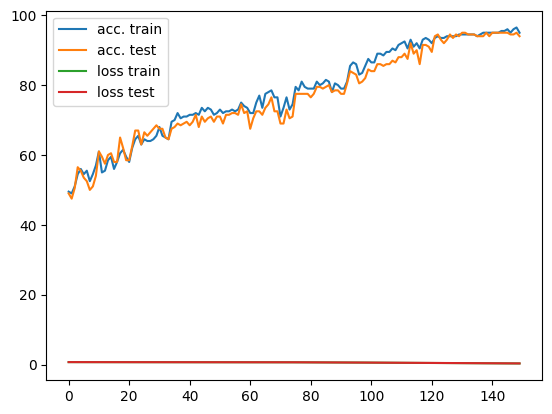

In [13]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        Y_hat, outputs = forward(params, X)
        loss, accuracy = loss_accuracy(Y_hat, Y)
        grads = backward(params, outputs, Y)
        params = sgd(params, grads, eta)


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 2 : Simplify backward with `torch.autograd`



In [23]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # Fill out Wh, Wy, bh, by
    # Turn on autograd for the torch tensors

    params["Wh"] = torch.randn((nh, nx))*0.3
    params["Wy"] = torch.randn((ny, nh))*0.3
    params["bh"] = torch.zeros((nh,1))
    params["by"] = torch.zeros((ny,1))

    params["Wh"].requires_grad = True
    params["Wy"].requires_grad = True

    params["bh"].requires_grad = True
    params["by"].requires_grad = True


    ####################
    ##      FIN        #
    ####################
    return params

In [24]:
def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}

    outputs["X"] = X
    outputs["htilde"] = torch.mm(X, params["Wh"].T) + params["bh"].T
    outputs["h"] = torch.tanh(outputs["htilde"])
    outputs["ytilde"] = torch.mm(outputs["h"], params["Wy"].T) + params["by"].T
    outputs["yhat"] = torch.exp(outputs["ytilde"])
    outputs["yhat"] = outputs["yhat"] / outputs["yhat"].sum(dim=-1, keepdim=True)


    return outputs['yhat'], outputs

In [26]:
def loss_accuracy(Yhat, Y):


    L = - torch.mean((Y * torch.log(Yhat)).sum(dim=1)) # mean for the batch

    _, indYhat = torch.max(Yhat, 1)
    _, indY = torch.max(Y, 1)

    acc = torch.sum(indY == indYhat) * 100. / indY.size(0);


    return L, acc

`forward` and `loss_accuracy` are the same as before.

`backward` is not necessary anymore thanks to pytorch.

In [36]:
def sgd(params, eta):

    #####################
    ## Your code here  ##
    #####################
    # Update parameters with a SGD step
    # Take care to take this off the computation graph with torch.no_grad()
    # And remember to reset the gradients after use with .grad.zero_()

    with torch.no_grad():
      params['Wy'] -= eta * params['Wy'].grad
      params['Wh'] -= eta * params['Wh'].grad
      params['by'] -= eta * params['by'].grad
      params['bh'] -= eta * params['bh'].grad
      params['Wy'].grad.zero_()
      params['Wh'].grad.zero_()
      params['by'].grad.zero_()
      params['bh'].grad.zero_()

    return params

    ####################
    ##      FIN        #
    ####################

## Algorithme global d'apprentissage (avec autograd)

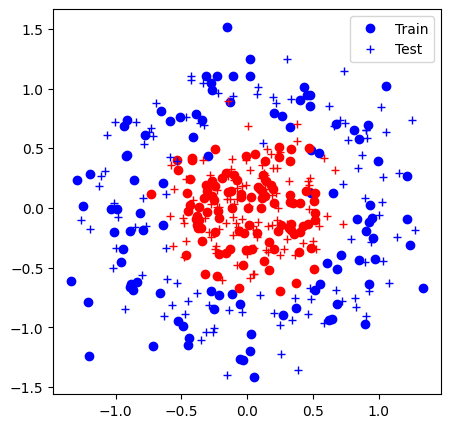

Iter 0: Acc train 51.0% (0.70), acc test 50.5% (0.70)


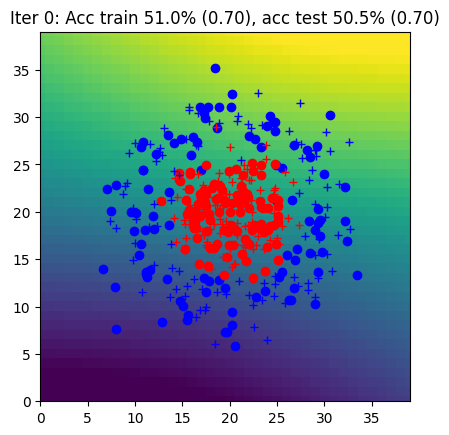

Iter 1: Acc train 51.5% (0.70), acc test 50.0% (0.70)


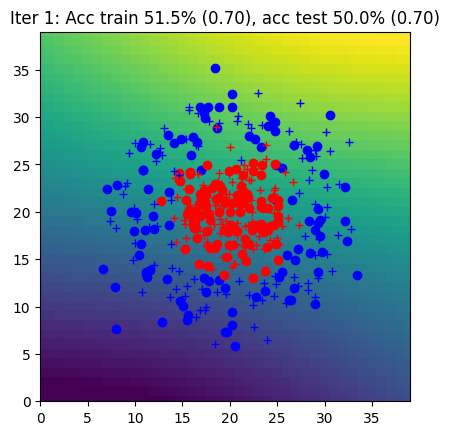

Iter 2: Acc train 52.0% (0.70), acc test 51.0% (0.70)


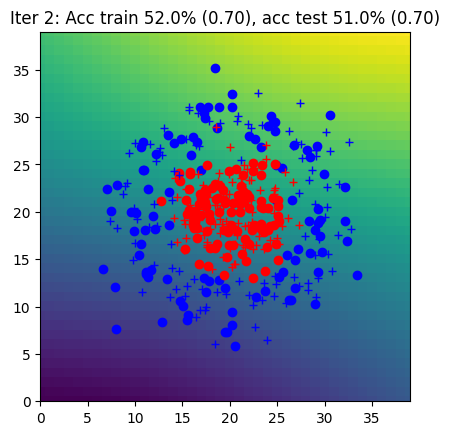

Iter 3: Acc train 53.0% (0.70), acc test 51.5% (0.70)


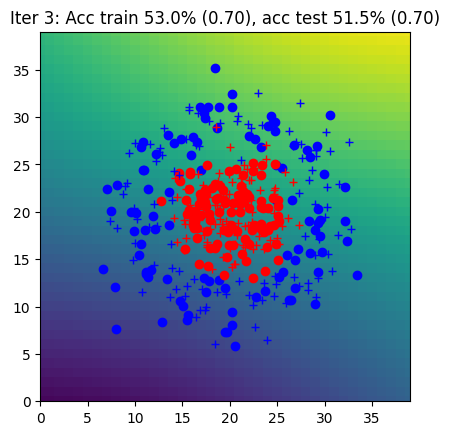

Iter 4: Acc train 51.5% (0.70), acc test 50.5% (0.69)


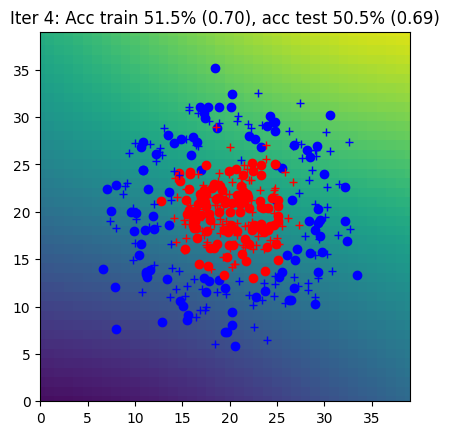

Iter 5: Acc train 52.0% (0.69), acc test 51.5% (0.69)


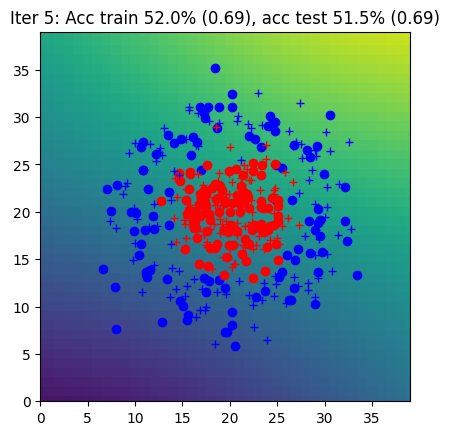

Iter 6: Acc train 53.0% (0.69), acc test 51.0% (0.69)


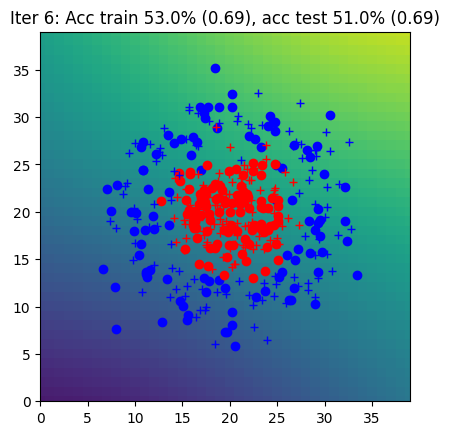

Iter 7: Acc train 53.5% (0.69), acc test 52.0% (0.69)


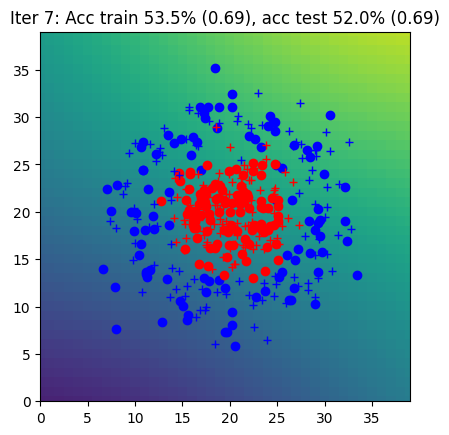

Iter 8: Acc train 53.5% (0.69), acc test 52.0% (0.69)


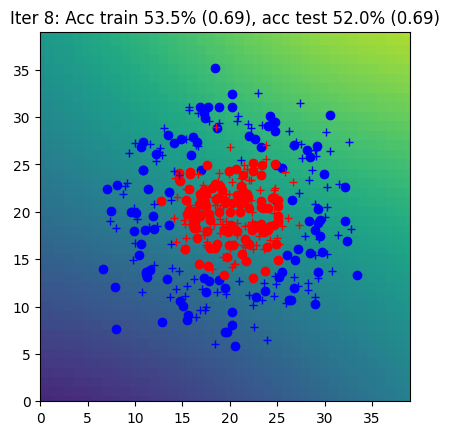

Iter 9: Acc train 55.0% (0.69), acc test 56.5% (0.69)


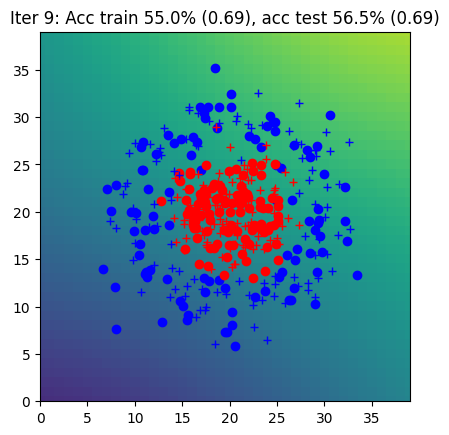

Iter 10: Acc train 53.5% (0.69), acc test 52.0% (0.69)


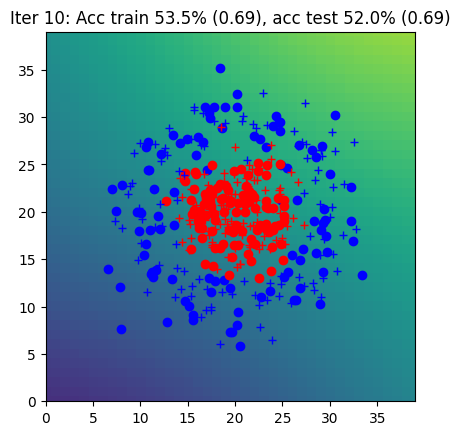

Iter 11: Acc train 54.5% (0.69), acc test 55.0% (0.69)


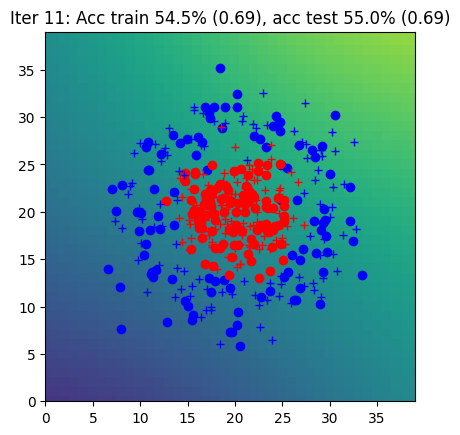

Iter 12: Acc train 54.5% (0.69), acc test 55.0% (0.69)


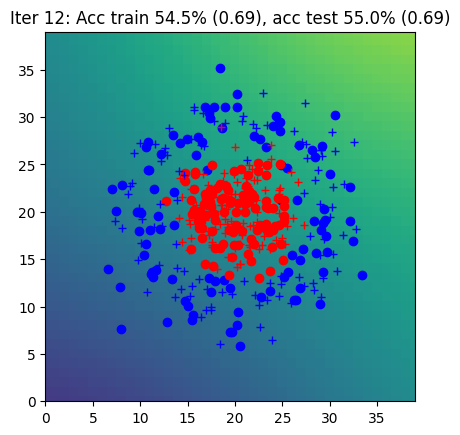

Iter 13: Acc train 55.0% (0.69), acc test 56.5% (0.69)


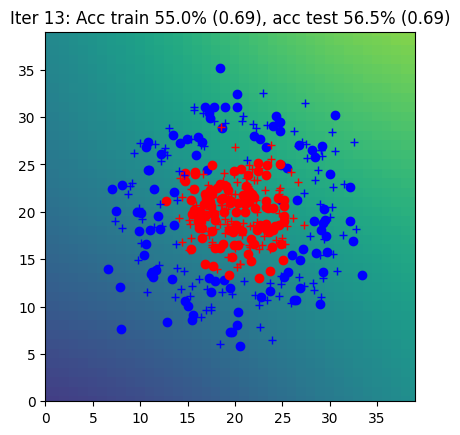

Iter 14: Acc train 60.5% (0.69), acc test 60.0% (0.69)


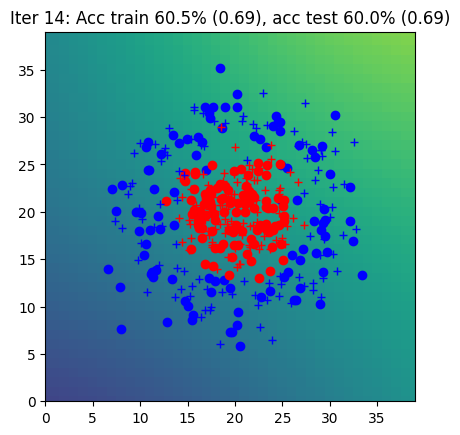

Iter 15: Acc train 58.5% (0.69), acc test 59.0% (0.69)


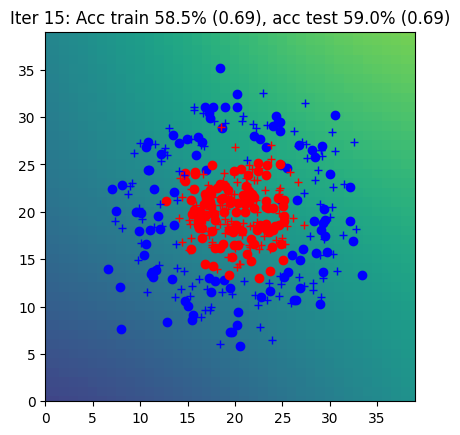

Iter 16: Acc train 59.0% (0.69), acc test 59.5% (0.69)


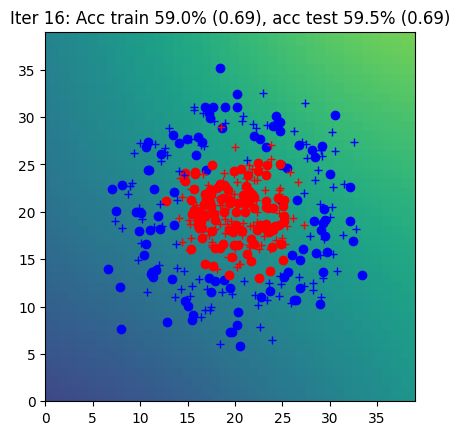

Iter 17: Acc train 55.5% (0.69), acc test 57.0% (0.69)


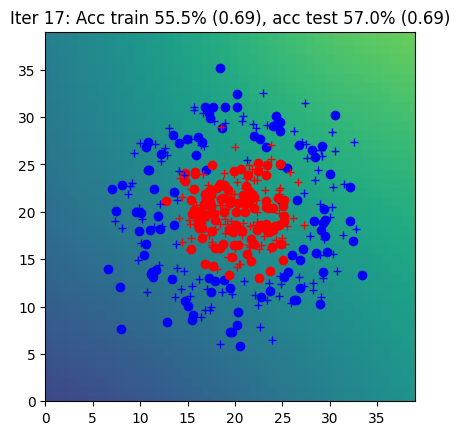

Iter 18: Acc train 52.5% (0.69), acc test 56.5% (0.69)


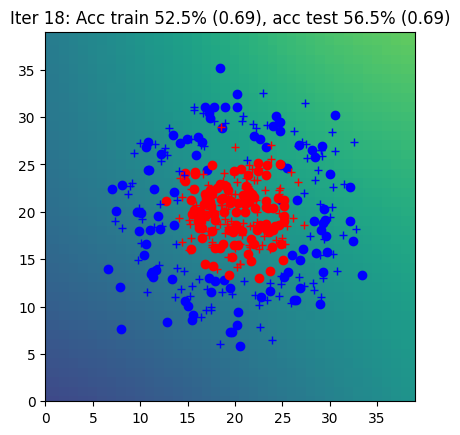

Iter 19: Acc train 54.5% (0.69), acc test 56.5% (0.69)


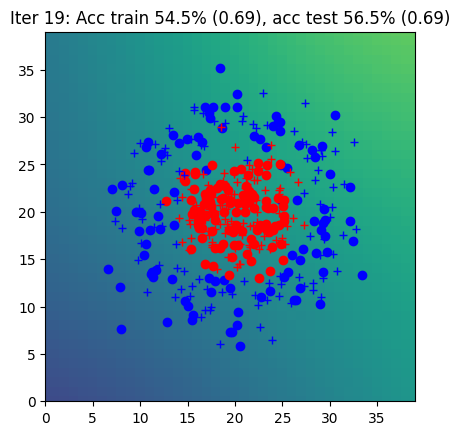

Iter 20: Acc train 55.5% (0.69), acc test 60.0% (0.69)


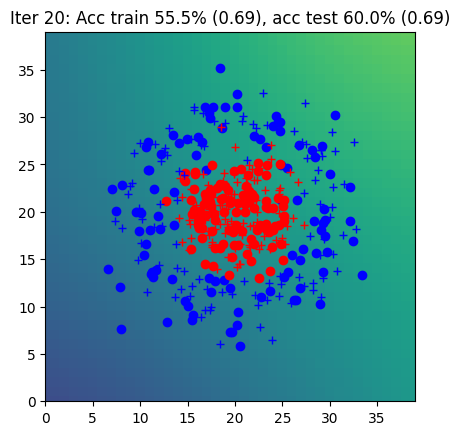

Iter 21: Acc train 50.5% (0.69), acc test 52.0% (0.69)


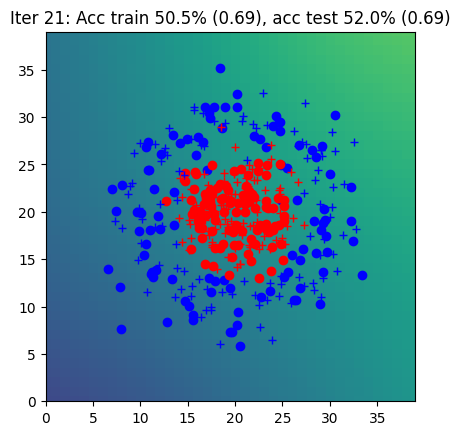

Iter 22: Acc train 50.5% (0.69), acc test 54.0% (0.69)


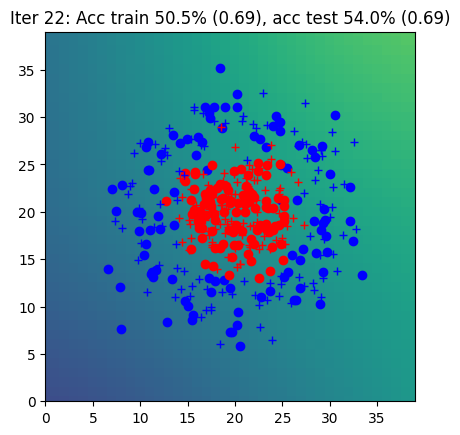

Iter 23: Acc train 54.0% (0.69), acc test 57.5% (0.69)


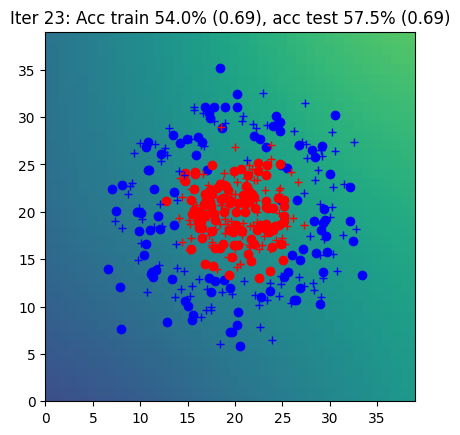

Iter 24: Acc train 54.0% (0.69), acc test 58.0% (0.69)


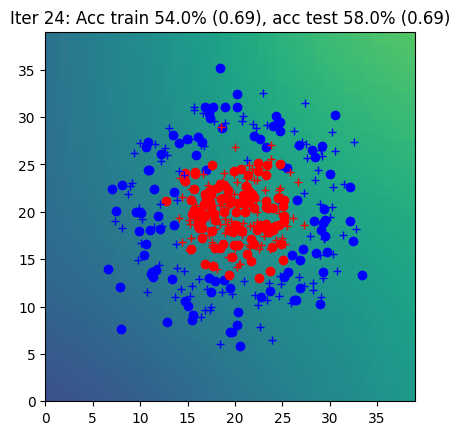

Iter 25: Acc train 55.5% (0.69), acc test 60.0% (0.69)


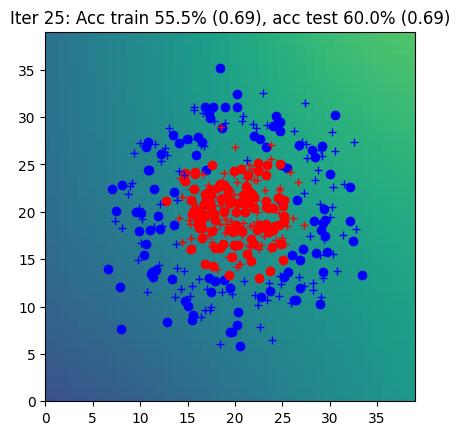

Iter 26: Acc train 53.0% (0.69), acc test 58.5% (0.69)


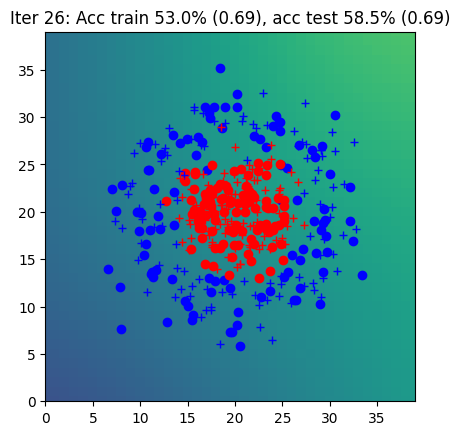

Iter 27: Acc train 57.5% (0.69), acc test 61.0% (0.69)


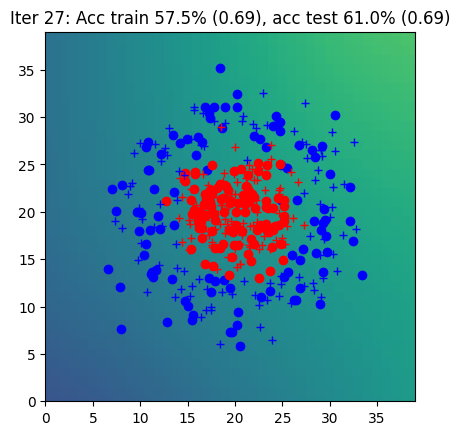

Iter 28: Acc train 57.5% (0.69), acc test 62.0% (0.69)


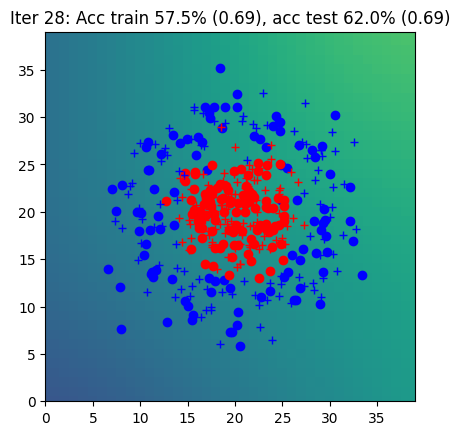

Iter 29: Acc train 59.5% (0.69), acc test 62.0% (0.69)


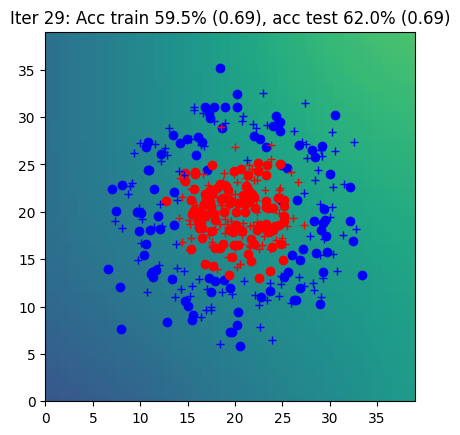

Iter 30: Acc train 58.5% (0.69), acc test 62.5% (0.69)


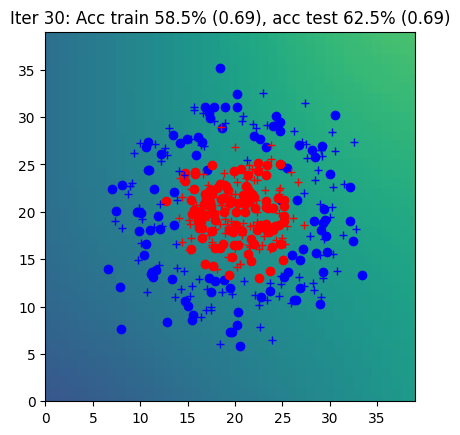

Iter 31: Acc train 58.5% (0.69), acc test 62.0% (0.69)


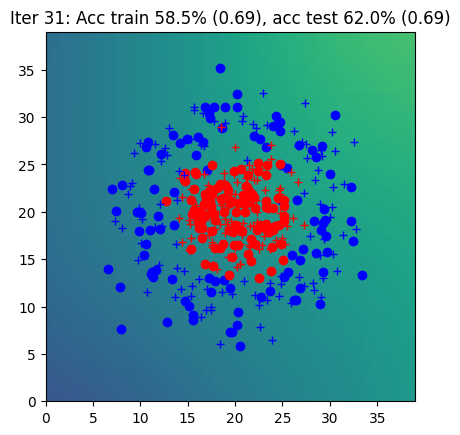

Iter 32: Acc train 57.0% (0.69), acc test 61.0% (0.69)


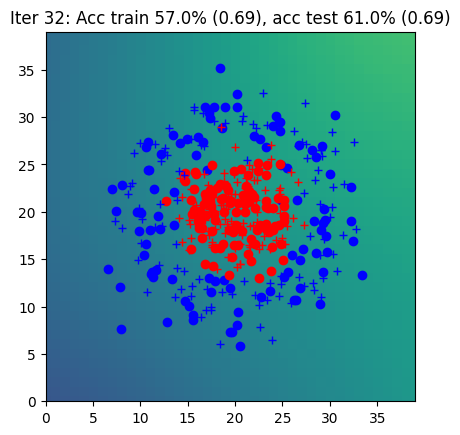

Iter 33: Acc train 58.5% (0.69), acc test 61.5% (0.69)


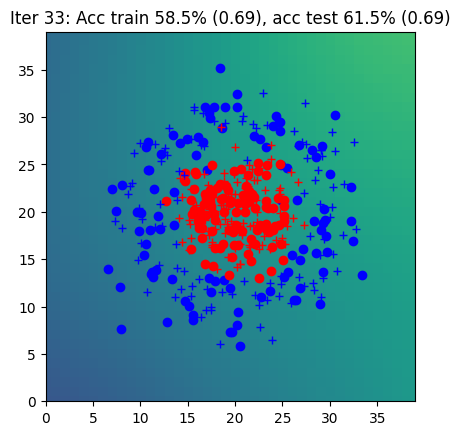

Iter 34: Acc train 60.0% (0.69), acc test 63.0% (0.69)


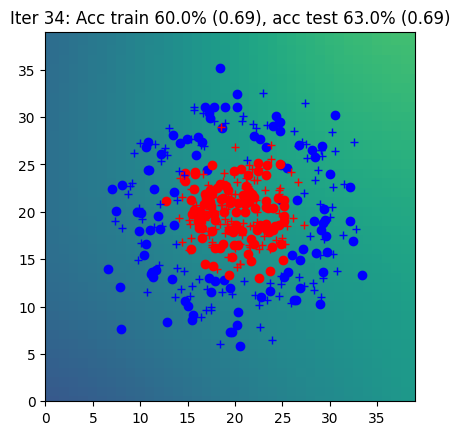

Iter 35: Acc train 61.5% (0.69), acc test 63.0% (0.69)


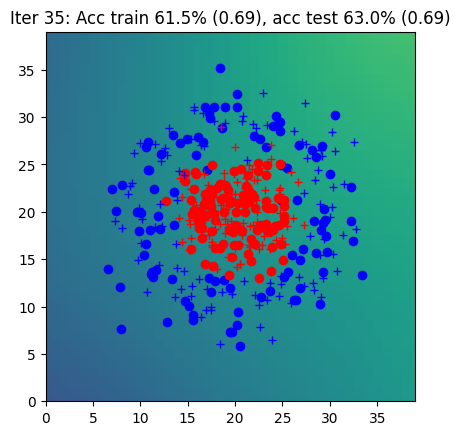

Iter 36: Acc train 62.5% (0.69), acc test 65.0% (0.69)


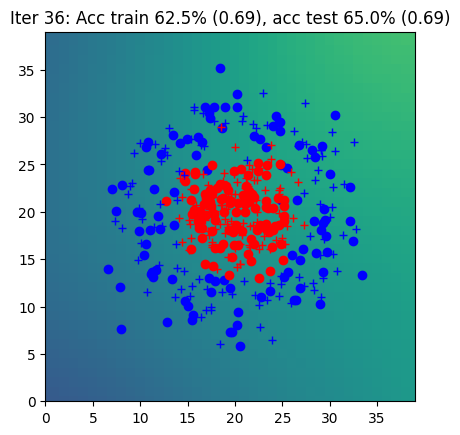

Iter 37: Acc train 60.5% (0.69), acc test 63.5% (0.69)


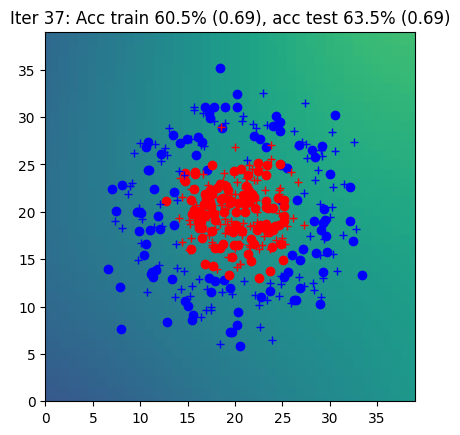

Iter 38: Acc train 59.0% (0.69), acc test 62.5% (0.69)


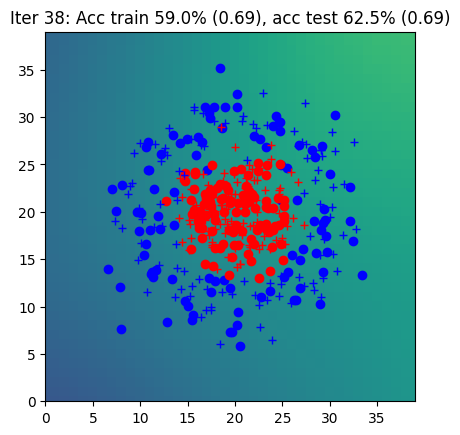

Iter 39: Acc train 56.0% (0.69), acc test 62.0% (0.69)


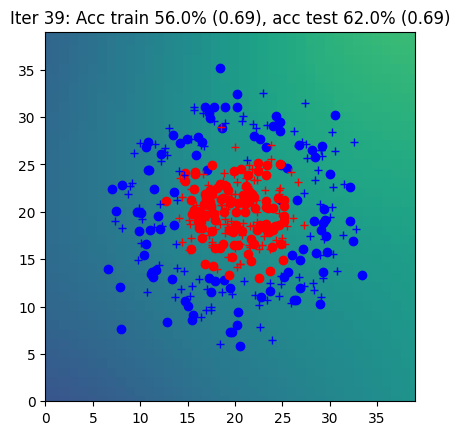

Iter 40: Acc train 60.0% (0.69), acc test 63.0% (0.69)


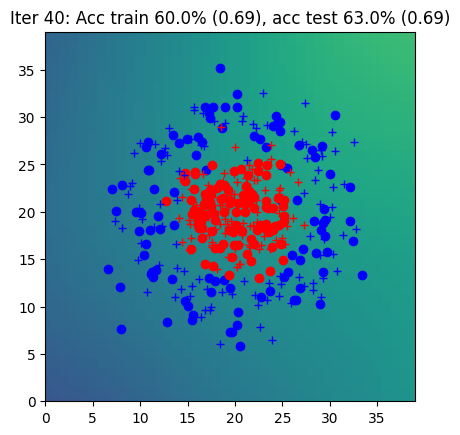

Iter 41: Acc train 60.0% (0.69), acc test 64.0% (0.69)


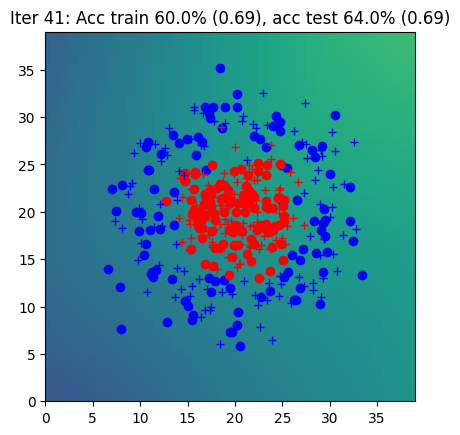

Iter 42: Acc train 62.0% (0.69), acc test 64.0% (0.69)


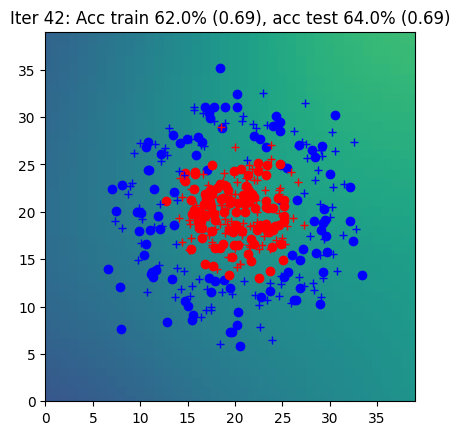

Iter 43: Acc train 64.0% (0.69), acc test 67.5% (0.69)


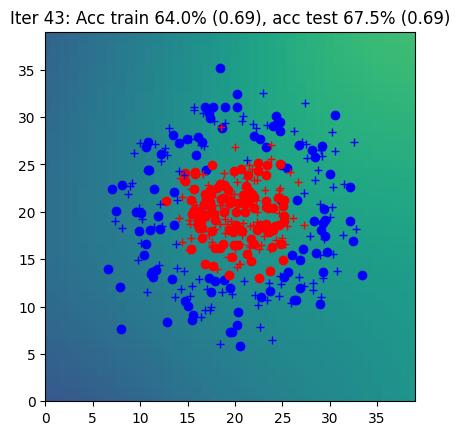

Iter 44: Acc train 64.5% (0.69), acc test 67.5% (0.69)


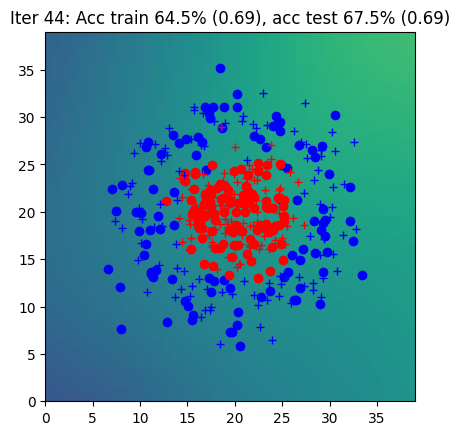

Iter 45: Acc train 64.0% (0.69), acc test 65.5% (0.69)


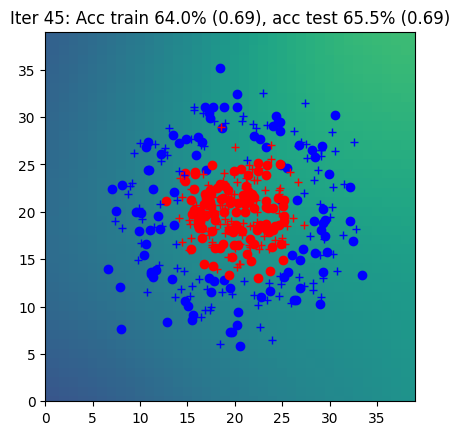

Iter 46: Acc train 64.0% (0.69), acc test 65.5% (0.69)


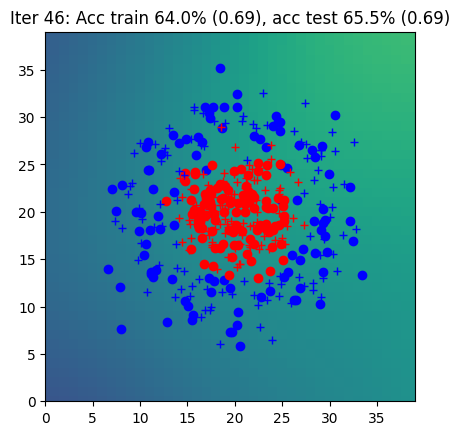

Iter 47: Acc train 64.0% (0.69), acc test 66.0% (0.69)


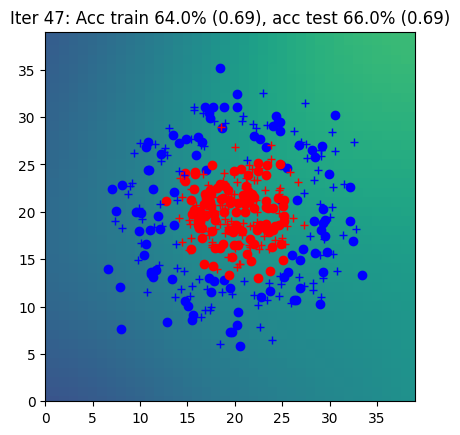

Iter 48: Acc train 61.5% (0.68), acc test 66.0% (0.69)


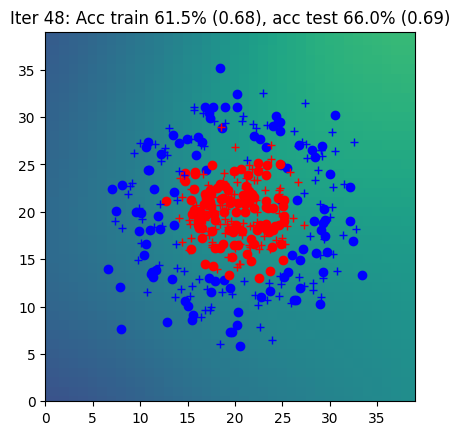

Iter 49: Acc train 64.0% (0.68), acc test 66.0% (0.69)


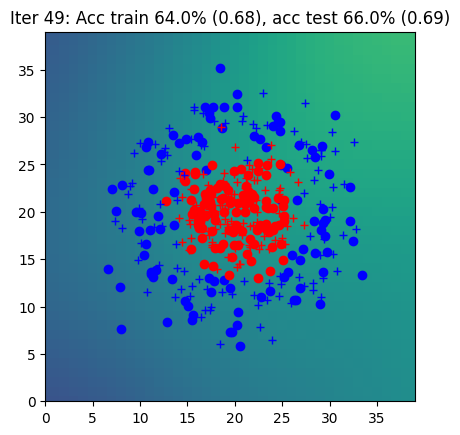

Iter 50: Acc train 64.0% (0.68), acc test 66.0% (0.68)


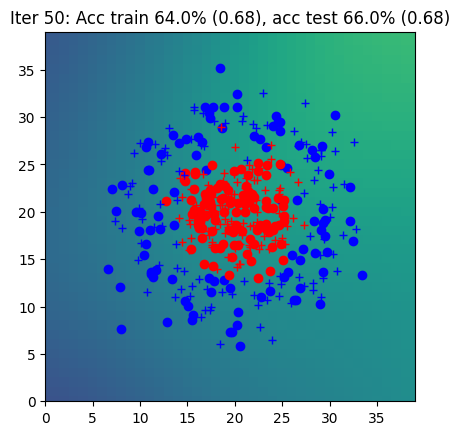

Iter 51: Acc train 70.5% (0.68), acc test 71.0% (0.68)


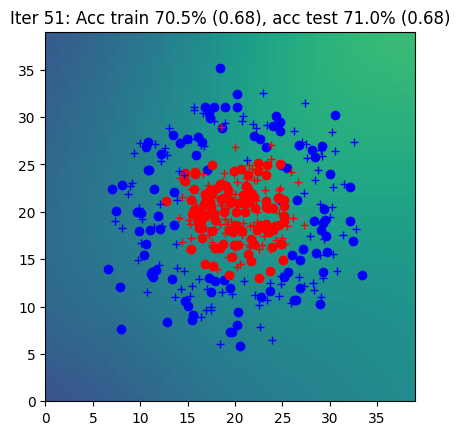

Iter 52: Acc train 67.0% (0.68), acc test 70.5% (0.68)


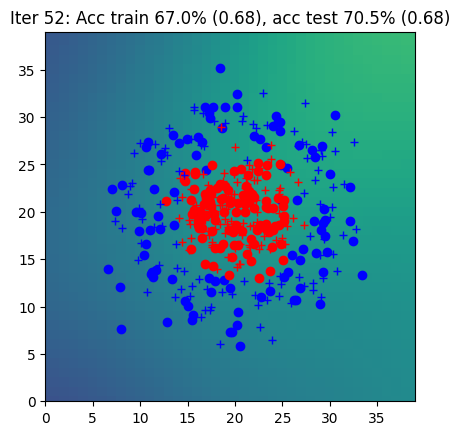

Iter 53: Acc train 63.5% (0.68), acc test 68.5% (0.68)


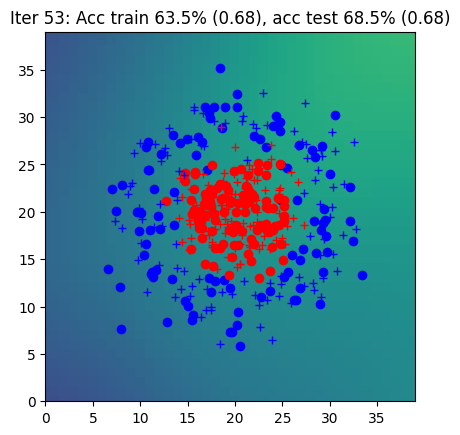

Iter 54: Acc train 65.0% (0.68), acc test 68.5% (0.68)


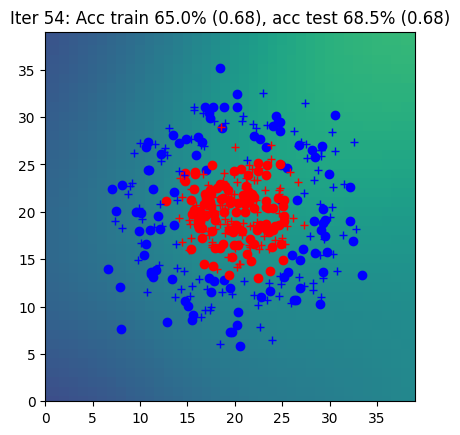

Iter 55: Acc train 64.5% (0.68), acc test 68.5% (0.68)


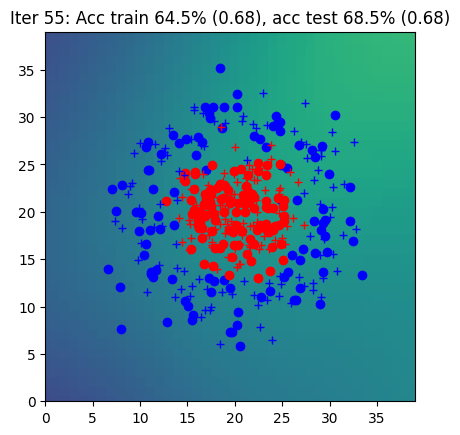

Iter 56: Acc train 66.0% (0.68), acc test 69.5% (0.68)


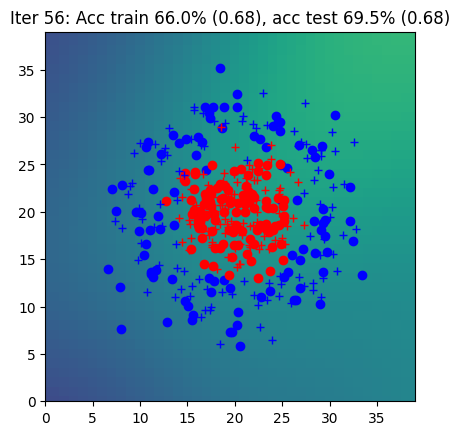

Iter 57: Acc train 72.0% (0.68), acc test 73.0% (0.68)


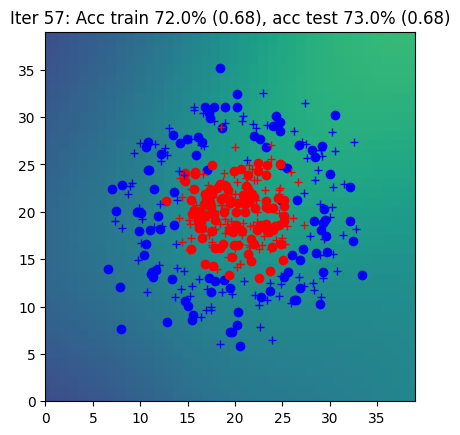

Iter 58: Acc train 67.5% (0.68), acc test 71.0% (0.68)


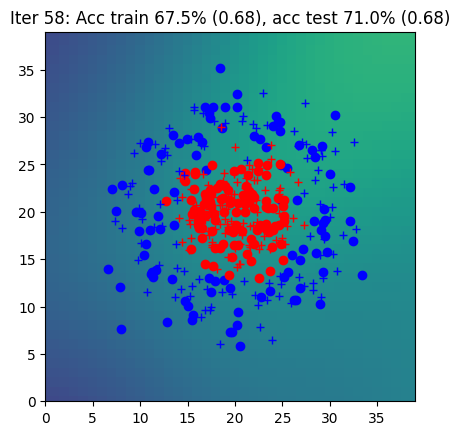

Iter 59: Acc train 69.5% (0.68), acc test 74.0% (0.68)


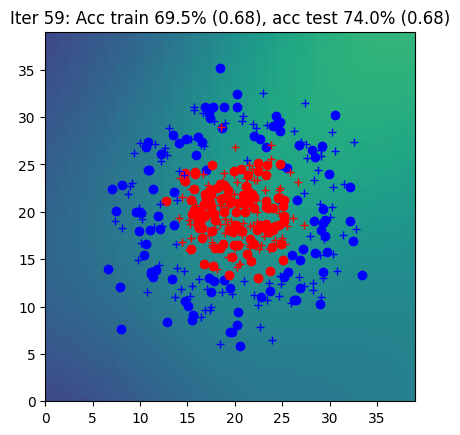

Iter 60: Acc train 73.0% (0.68), acc test 76.0% (0.68)


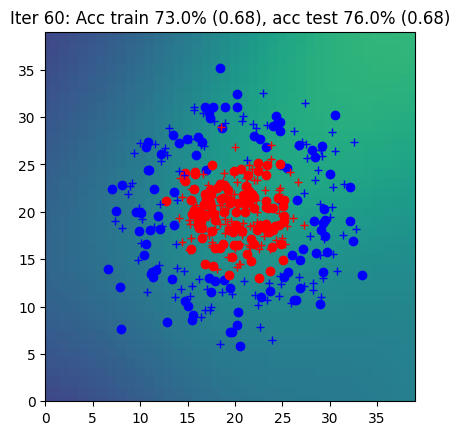

Iter 61: Acc train 73.5% (0.68), acc test 76.0% (0.68)


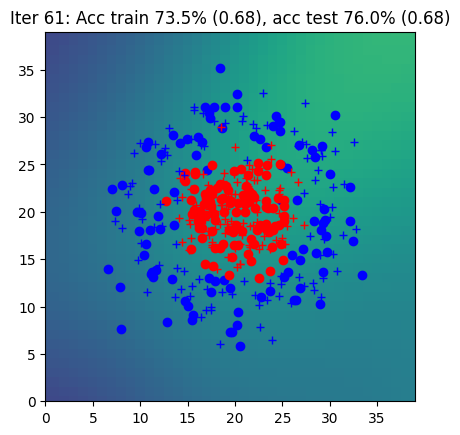

Iter 62: Acc train 74.5% (0.68), acc test 76.0% (0.68)


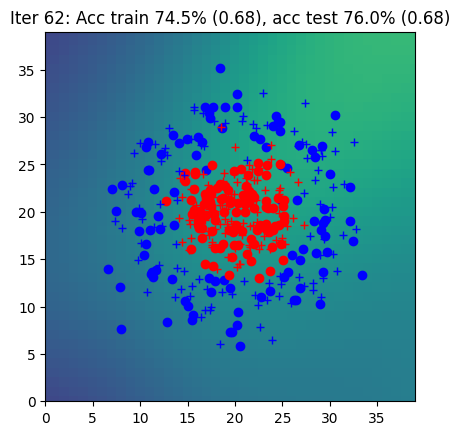

Iter 63: Acc train 75.0% (0.68), acc test 76.0% (0.68)


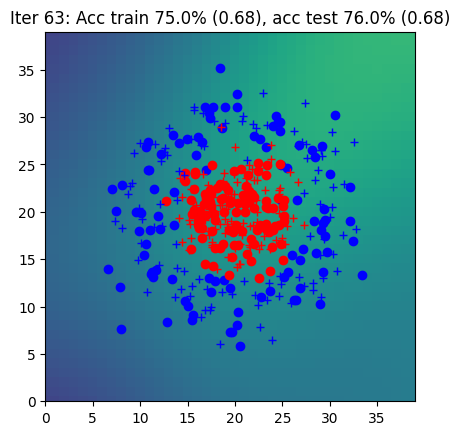

Iter 64: Acc train 75.0% (0.68), acc test 76.5% (0.68)


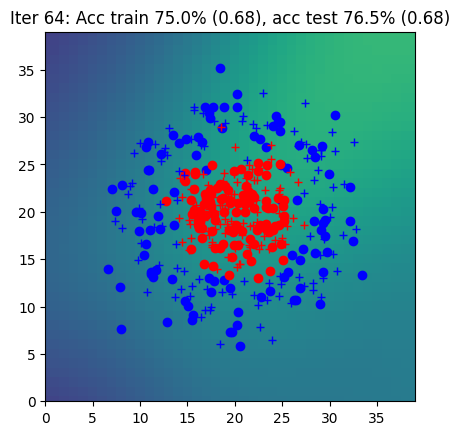

Iter 65: Acc train 75.0% (0.67), acc test 77.0% (0.68)


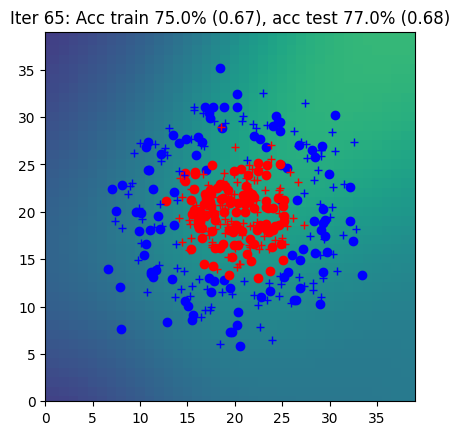

Iter 66: Acc train 76.0% (0.67), acc test 77.0% (0.67)


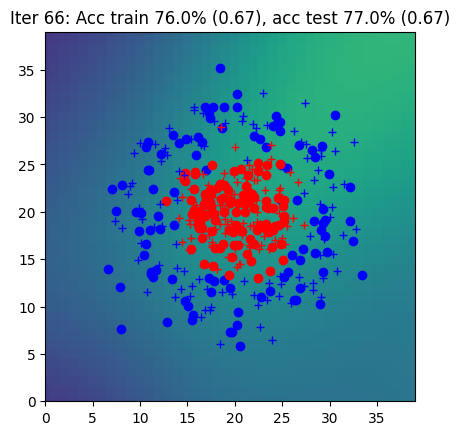

Iter 67: Acc train 76.5% (0.67), acc test 77.5% (0.67)


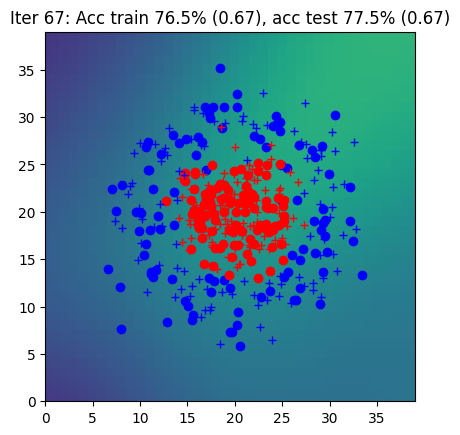

Iter 68: Acc train 76.0% (0.67), acc test 78.0% (0.67)


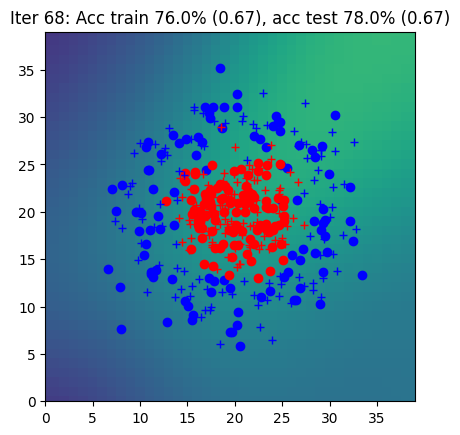

Iter 69: Acc train 76.5% (0.67), acc test 78.5% (0.67)


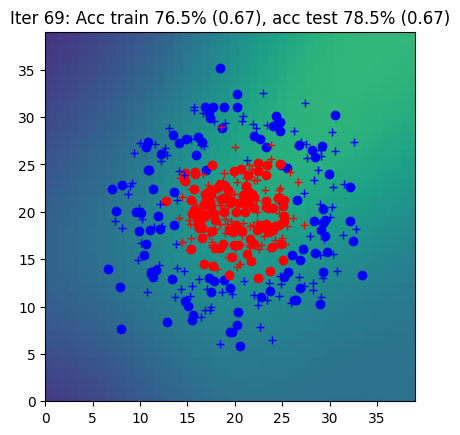

Iter 70: Acc train 74.5% (0.67), acc test 78.0% (0.67)


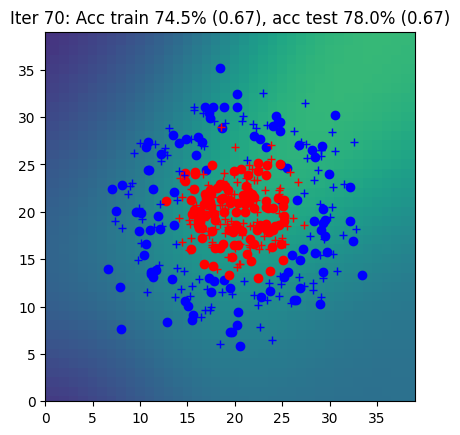

Iter 71: Acc train 74.5% (0.67), acc test 76.0% (0.67)


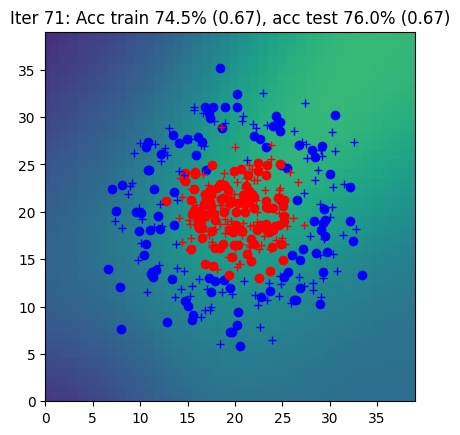

Iter 72: Acc train 76.0% (0.67), acc test 80.0% (0.67)


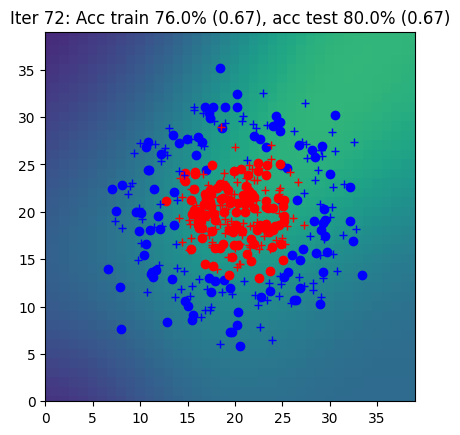

Iter 73: Acc train 75.0% (0.67), acc test 78.0% (0.67)


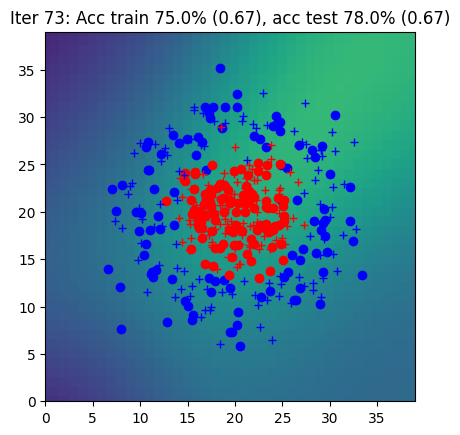

Iter 74: Acc train 78.0% (0.66), acc test 81.0% (0.66)


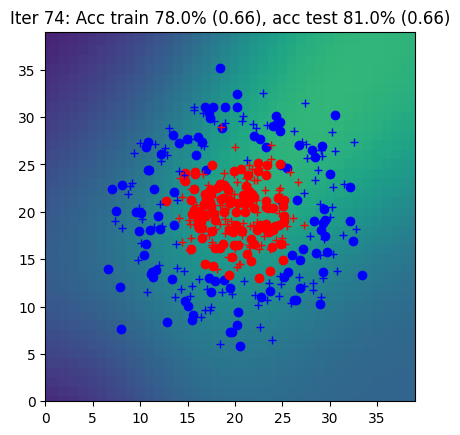

Iter 75: Acc train 79.0% (0.66), acc test 82.5% (0.66)


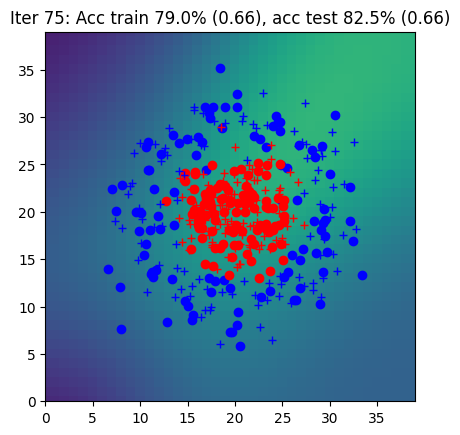

Iter 76: Acc train 81.5% (0.66), acc test 82.0% (0.66)


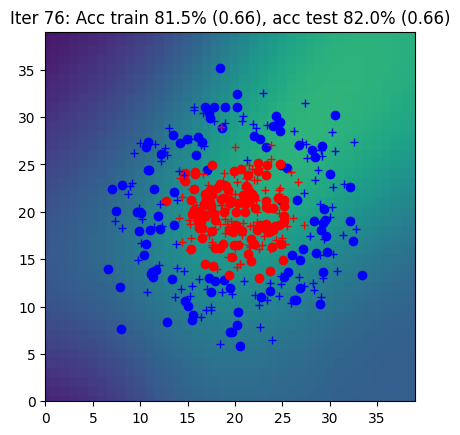

Iter 77: Acc train 81.0% (0.66), acc test 81.5% (0.66)


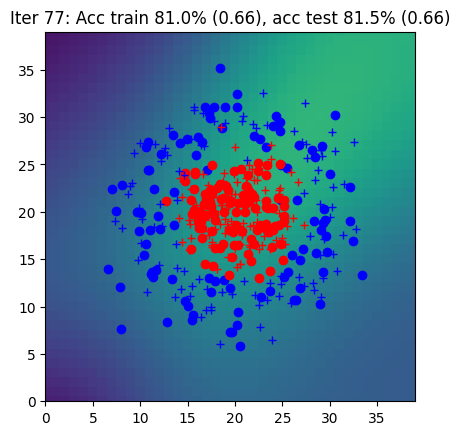

Iter 78: Acc train 81.5% (0.66), acc test 83.0% (0.66)


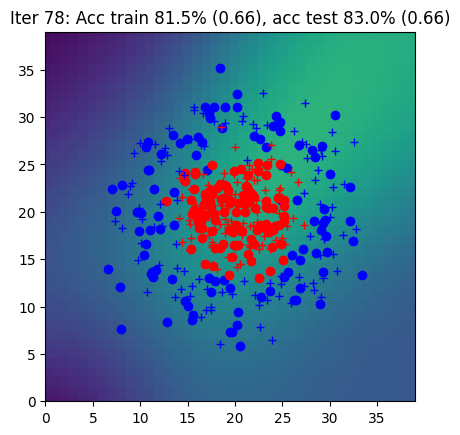

Iter 79: Acc train 80.5% (0.66), acc test 83.5% (0.66)


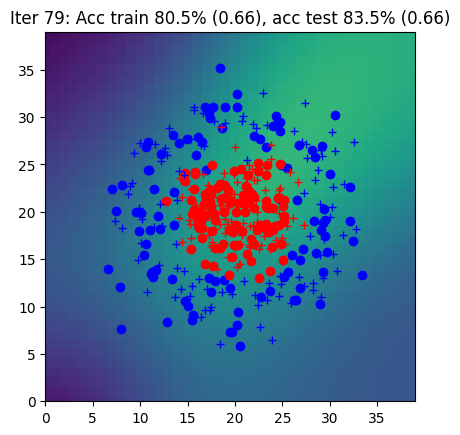

Iter 80: Acc train 76.0% (0.65), acc test 77.0% (0.65)


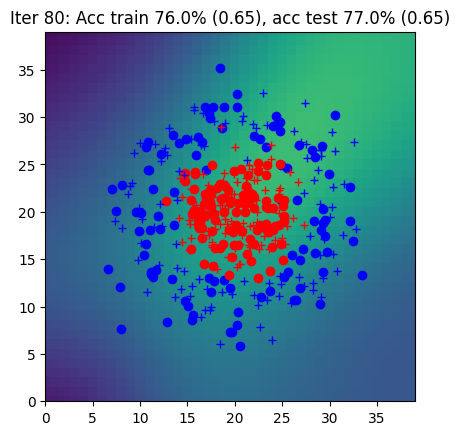

Iter 81: Acc train 79.5% (0.65), acc test 79.0% (0.65)


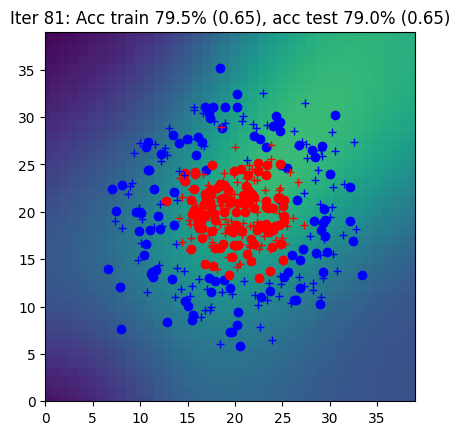

Iter 82: Acc train 82.0% (0.65), acc test 84.0% (0.65)


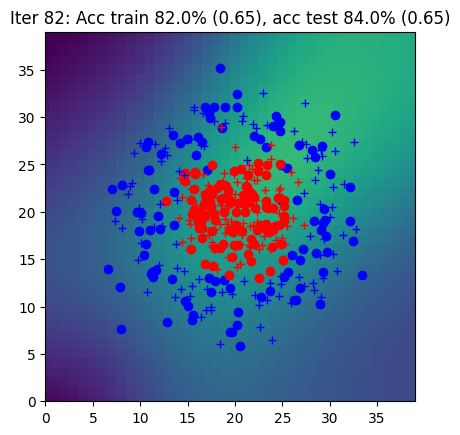

Iter 83: Acc train 81.5% (0.65), acc test 83.0% (0.65)


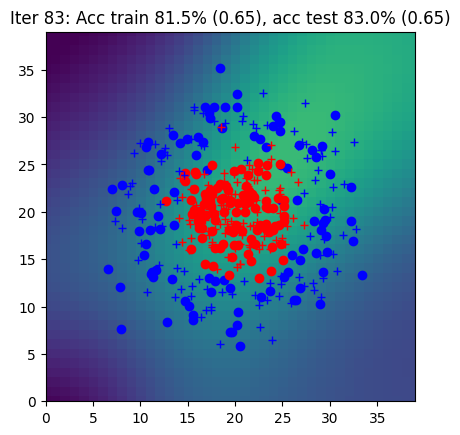

Iter 84: Acc train 81.5% (0.65), acc test 84.5% (0.65)


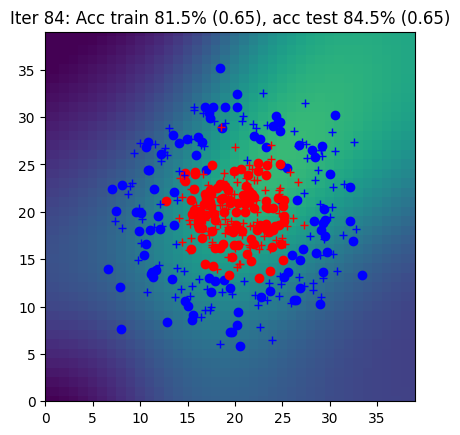

Iter 85: Acc train 81.0% (0.64), acc test 83.5% (0.64)


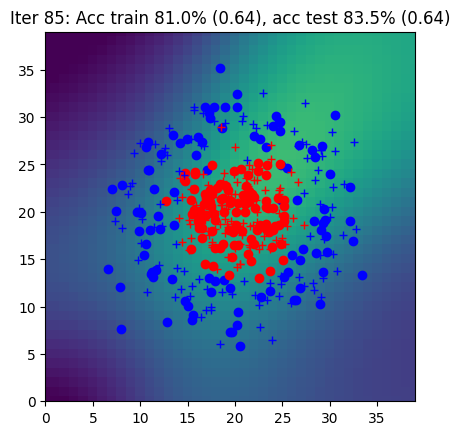

Iter 86: Acc train 83.0% (0.64), acc test 84.5% (0.64)


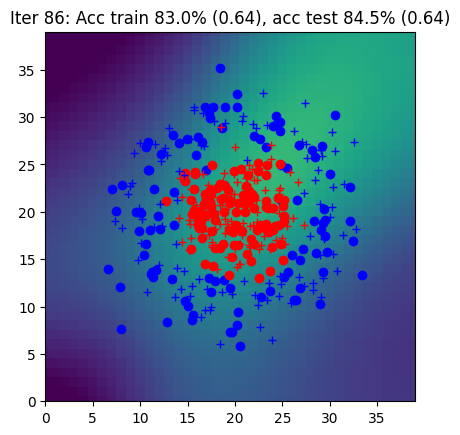

Iter 87: Acc train 81.0% (0.64), acc test 81.0% (0.64)


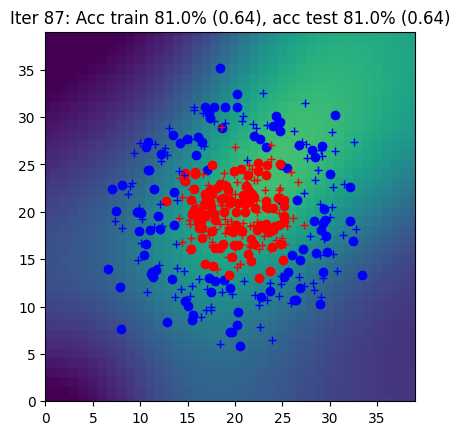

Iter 88: Acc train 82.0% (0.64), acc test 82.0% (0.64)


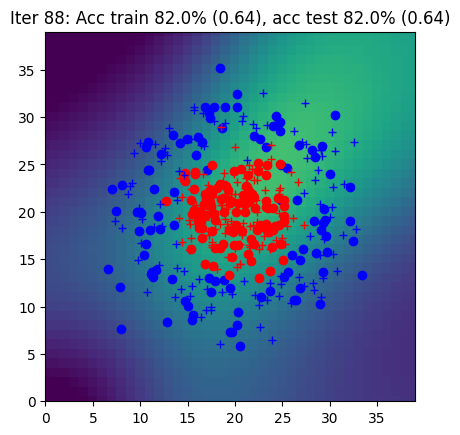

Iter 89: Acc train 81.5% (0.63), acc test 83.0% (0.63)


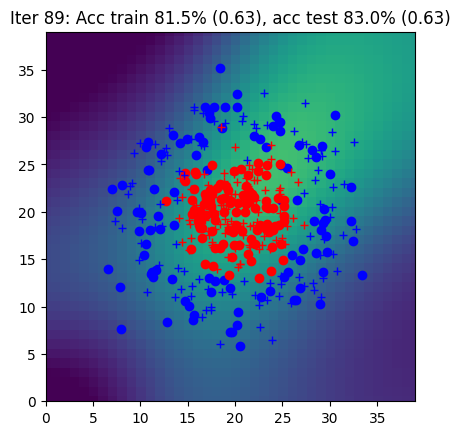

Iter 90: Acc train 81.5% (0.63), acc test 83.5% (0.63)


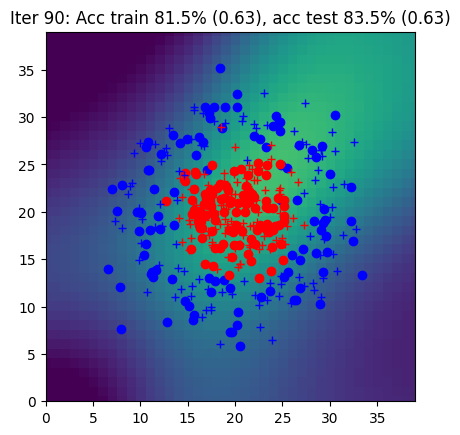

Iter 91: Acc train 82.0% (0.63), acc test 83.5% (0.63)


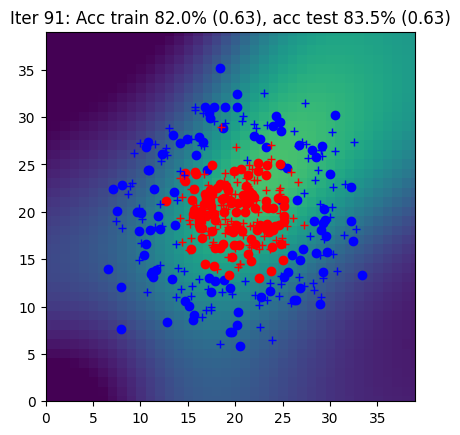

Iter 92: Acc train 82.5% (0.62), acc test 83.0% (0.62)


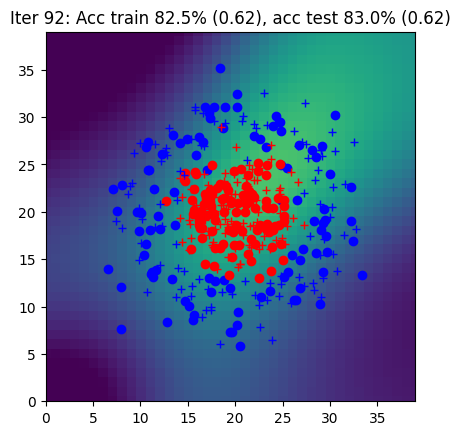

Iter 93: Acc train 83.0% (0.62), acc test 80.5% (0.62)


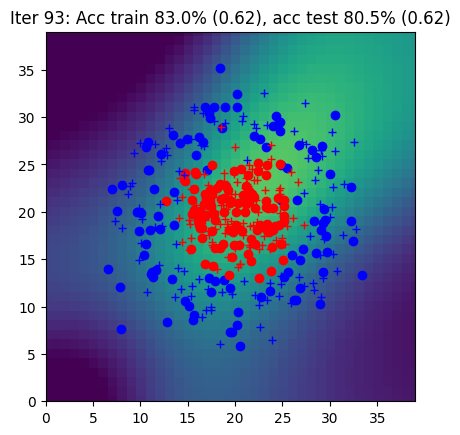

Iter 94: Acc train 82.5% (0.62), acc test 83.0% (0.62)


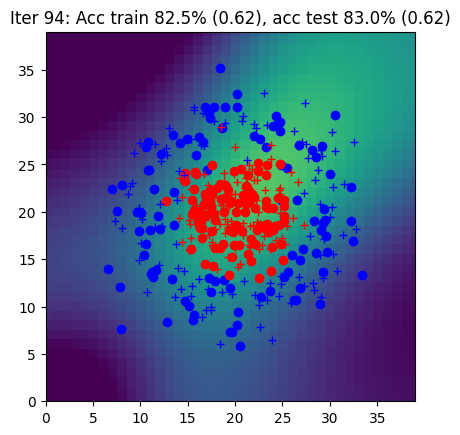

Iter 95: Acc train 83.5% (0.61), acc test 85.0% (0.61)


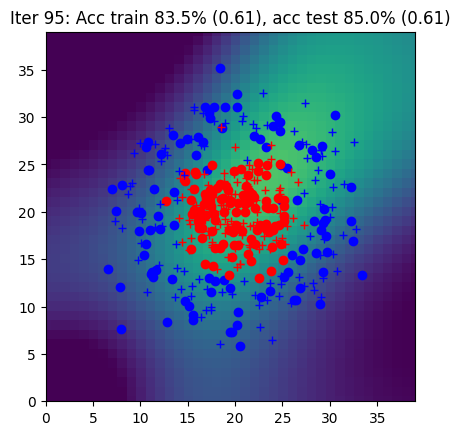

Iter 96: Acc train 84.0% (0.61), acc test 83.5% (0.61)


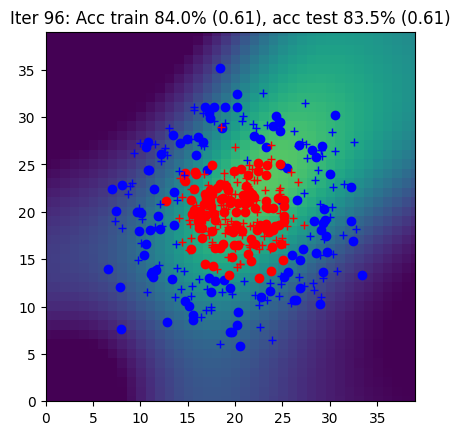

Iter 97: Acc train 83.5% (0.61), acc test 82.5% (0.61)


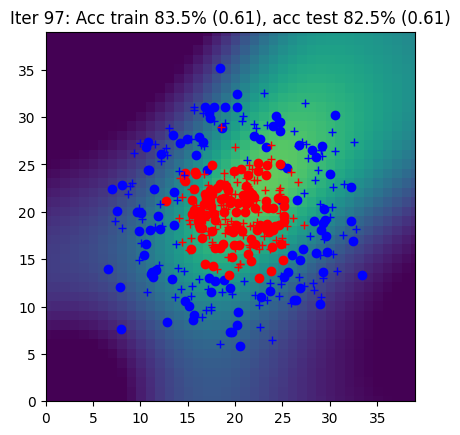

Iter 98: Acc train 83.5% (0.60), acc test 84.5% (0.60)


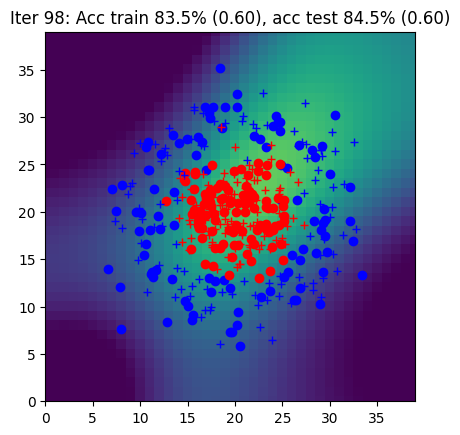

Iter 99: Acc train 84.5% (0.60), acc test 83.5% (0.60)


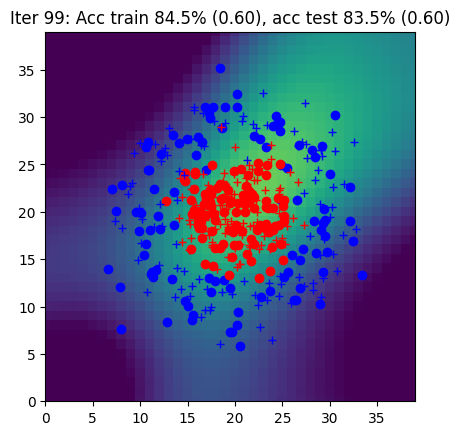

Iter 100: Acc train 84.0% (0.60), acc test 84.5% (0.59)


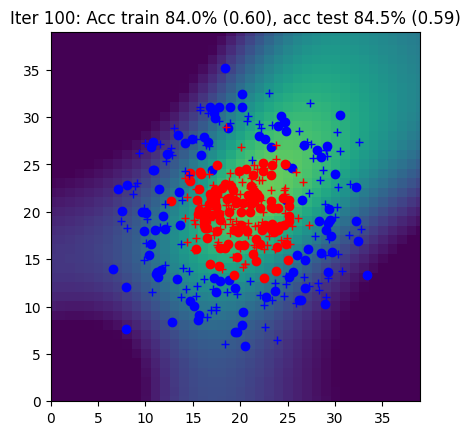

Iter 101: Acc train 83.5% (0.59), acc test 83.0% (0.59)


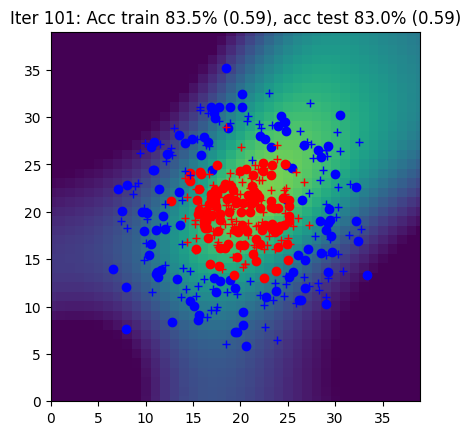

Iter 102: Acc train 83.5% (0.59), acc test 83.0% (0.59)


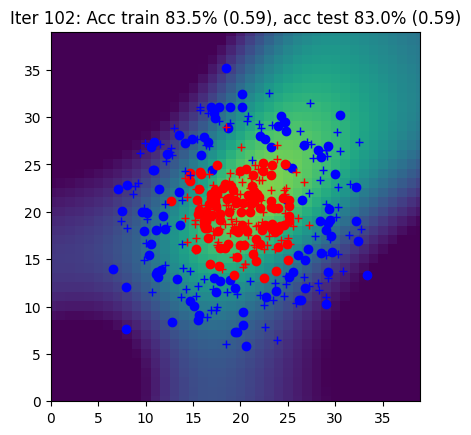

Iter 103: Acc train 83.5% (0.58), acc test 82.0% (0.58)


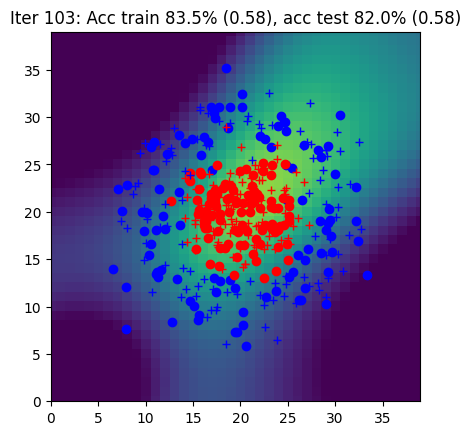

Iter 104: Acc train 83.0% (0.58), acc test 81.5% (0.58)


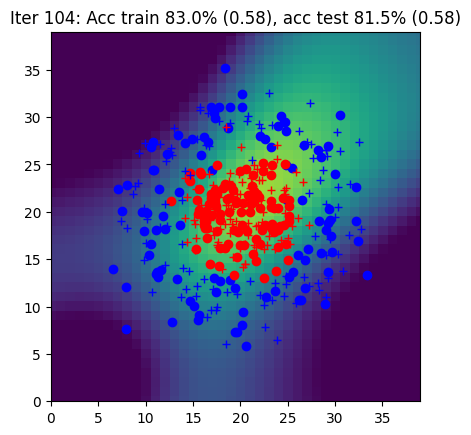

Iter 105: Acc train 83.5% (0.57), acc test 82.0% (0.57)


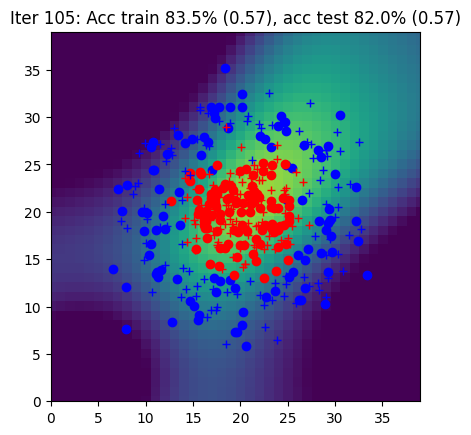

Iter 106: Acc train 83.5% (0.57), acc test 82.5% (0.57)


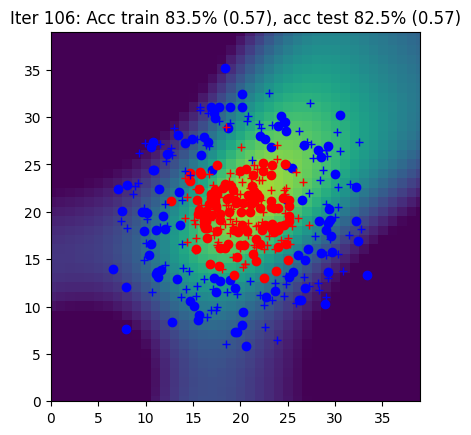

Iter 107: Acc train 84.5% (0.56), acc test 83.5% (0.56)


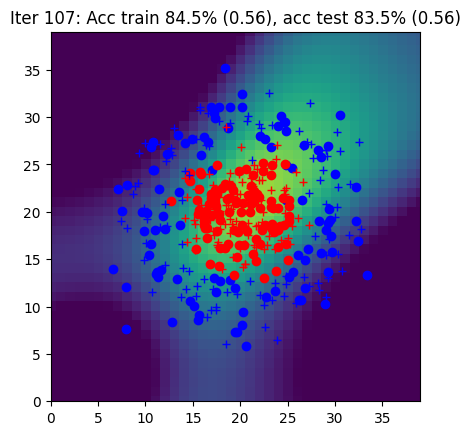

Iter 108: Acc train 84.5% (0.56), acc test 85.0% (0.56)


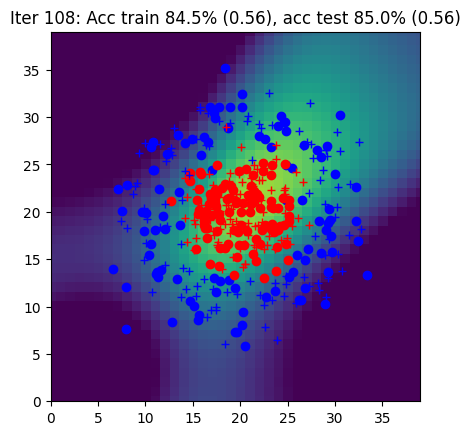

Iter 109: Acc train 84.5% (0.56), acc test 84.5% (0.55)


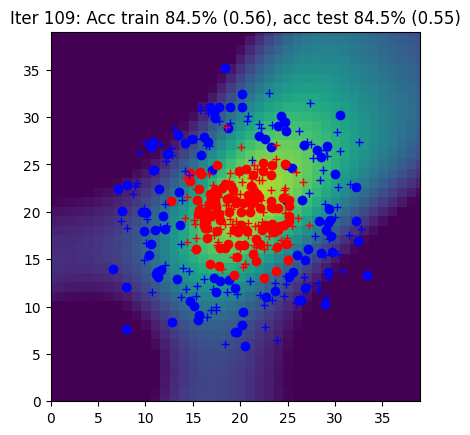

Iter 110: Acc train 84.0% (0.55), acc test 83.0% (0.55)


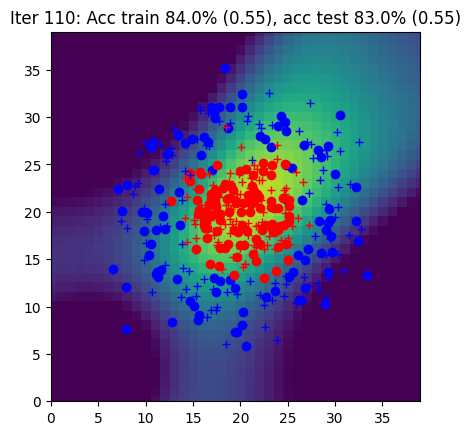

Iter 111: Acc train 84.5% (0.55), acc test 85.0% (0.54)


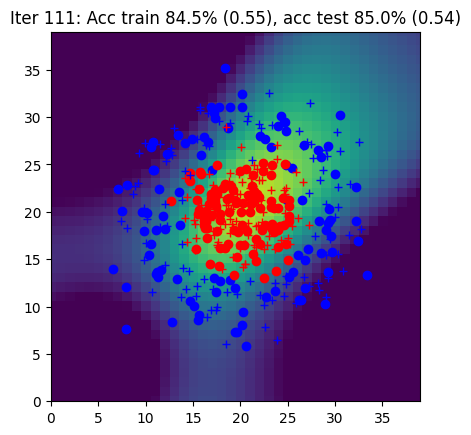

Iter 112: Acc train 84.5% (0.54), acc test 85.0% (0.54)


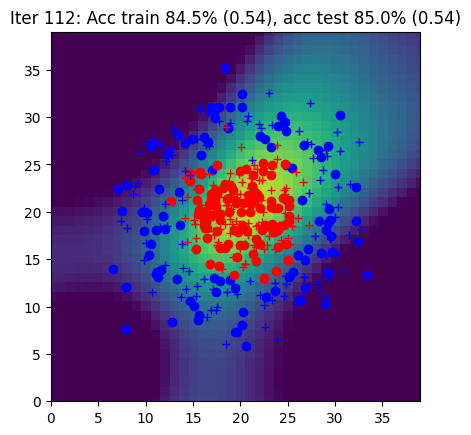

Iter 113: Acc train 84.5% (0.54), acc test 84.5% (0.53)


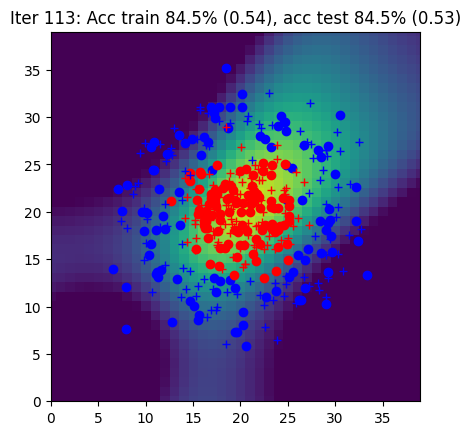

Iter 114: Acc train 85.0% (0.53), acc test 85.5% (0.53)


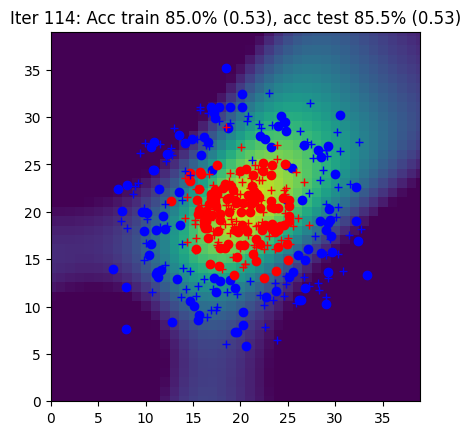

Iter 115: Acc train 85.0% (0.53), acc test 85.0% (0.52)


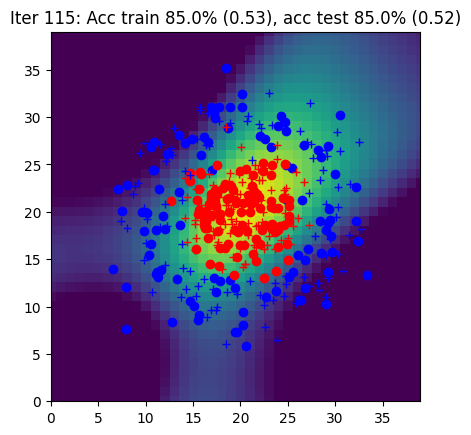

Iter 116: Acc train 83.0% (0.52), acc test 83.0% (0.52)


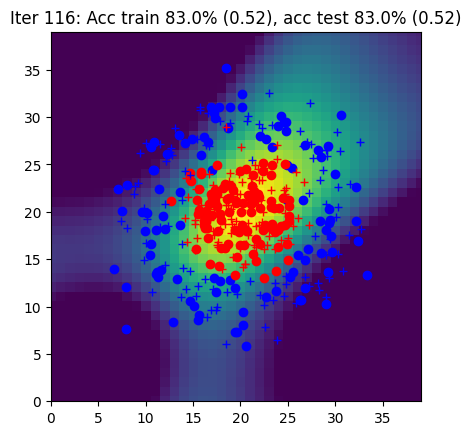

Iter 117: Acc train 84.5% (0.52), acc test 84.0% (0.51)


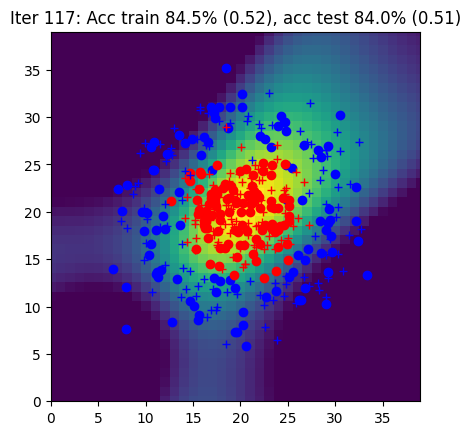

Iter 118: Acc train 85.0% (0.51), acc test 85.0% (0.51)


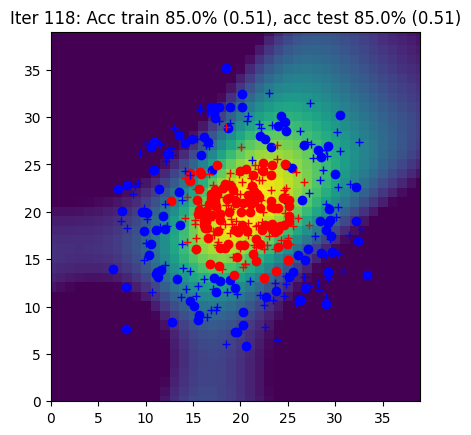

Iter 119: Acc train 85.0% (0.50), acc test 87.0% (0.50)


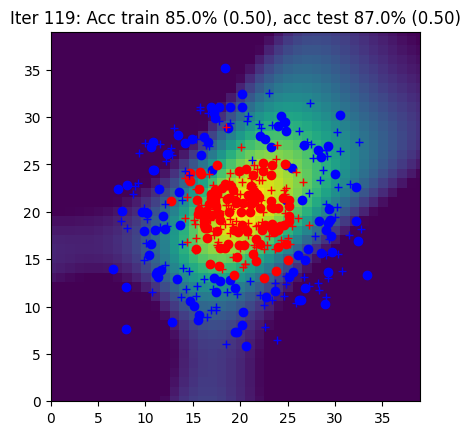

Iter 120: Acc train 85.0% (0.50), acc test 86.0% (0.50)


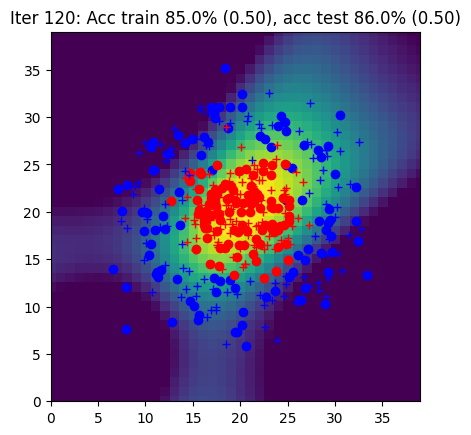

Iter 121: Acc train 85.0% (0.49), acc test 86.5% (0.49)


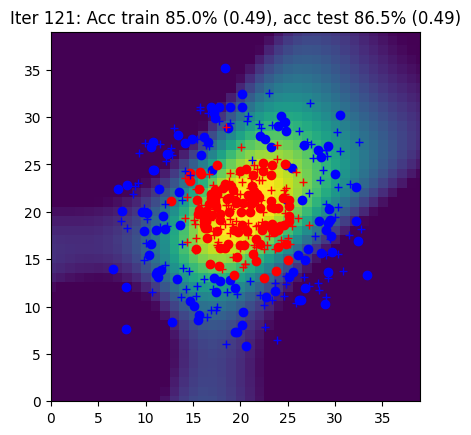

Iter 122: Acc train 85.0% (0.49), acc test 86.5% (0.48)


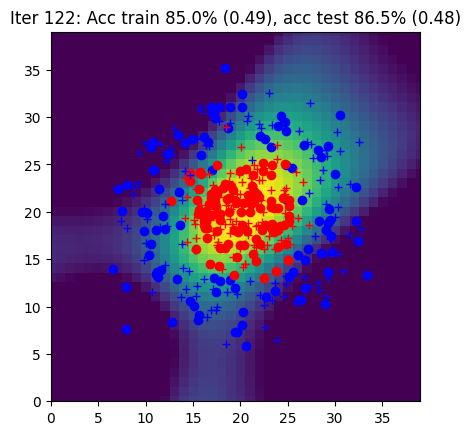

Iter 123: Acc train 85.0% (0.48), acc test 87.0% (0.48)


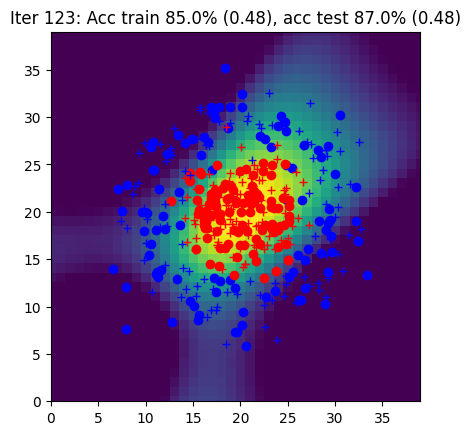

Iter 124: Acc train 85.0% (0.48), acc test 87.5% (0.47)


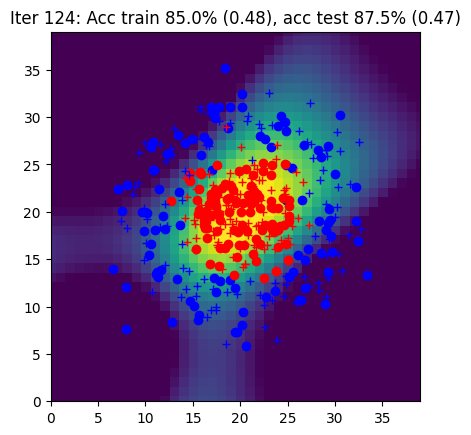

Iter 125: Acc train 84.5% (0.47), acc test 87.5% (0.47)


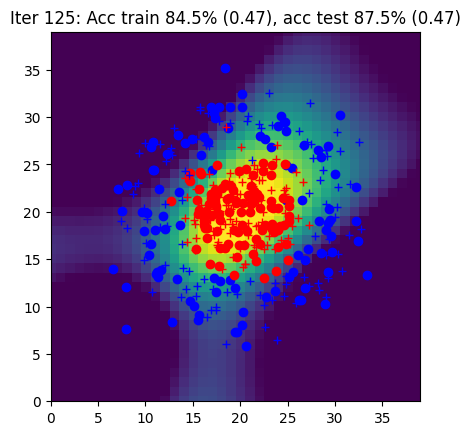

Iter 126: Acc train 85.0% (0.47), acc test 87.0% (0.46)


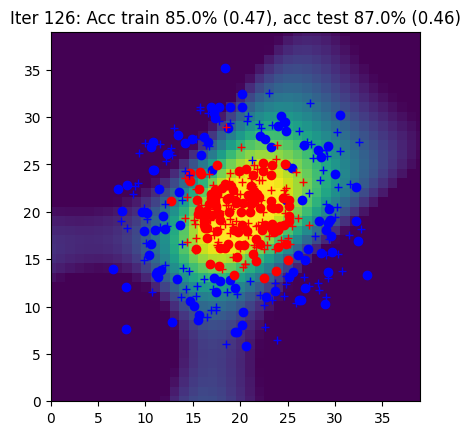

Iter 127: Acc train 86.0% (0.46), acc test 87.5% (0.46)


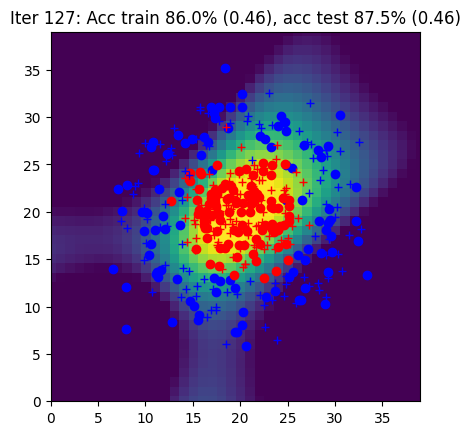

Iter 128: Acc train 86.5% (0.46), acc test 87.5% (0.45)


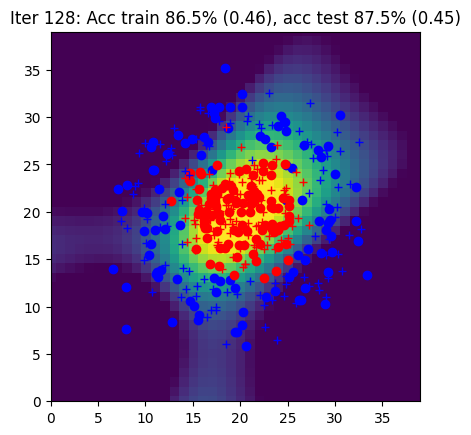

Iter 129: Acc train 86.5% (0.45), acc test 88.5% (0.45)


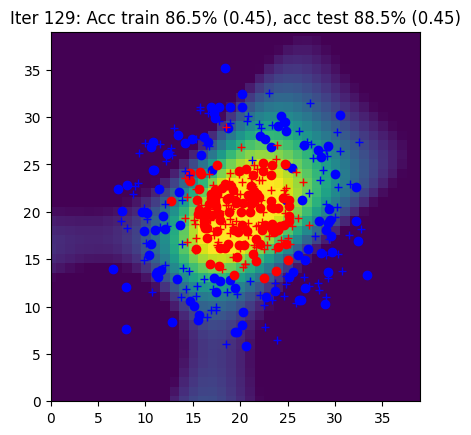

Iter 130: Acc train 87.0% (0.45), acc test 88.5% (0.44)


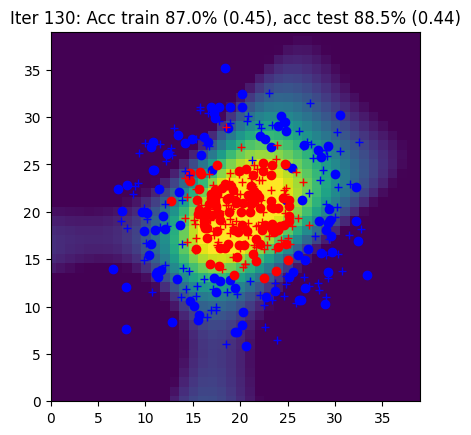

Iter 131: Acc train 88.5% (0.44), acc test 88.5% (0.44)


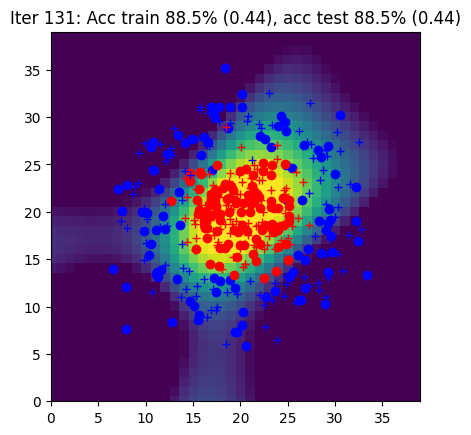

Iter 132: Acc train 88.5% (0.44), acc test 90.0% (0.43)


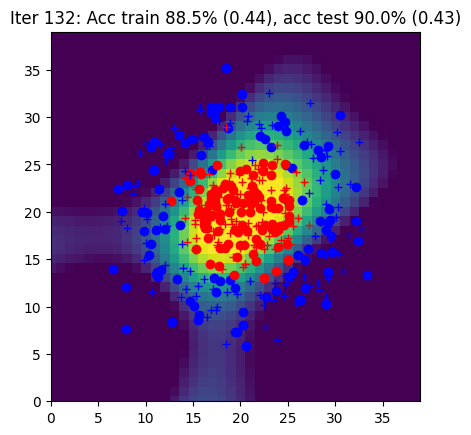

Iter 133: Acc train 89.0% (0.43), acc test 92.0% (0.43)


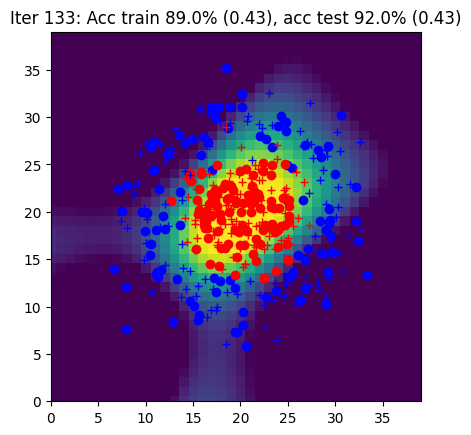

Iter 134: Acc train 90.0% (0.43), acc test 94.5% (0.42)


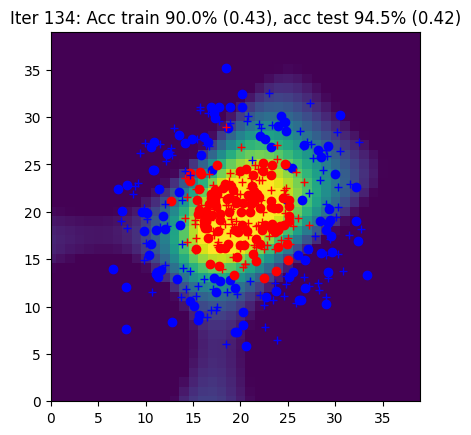

Iter 135: Acc train 90.0% (0.42), acc test 95.0% (0.42)


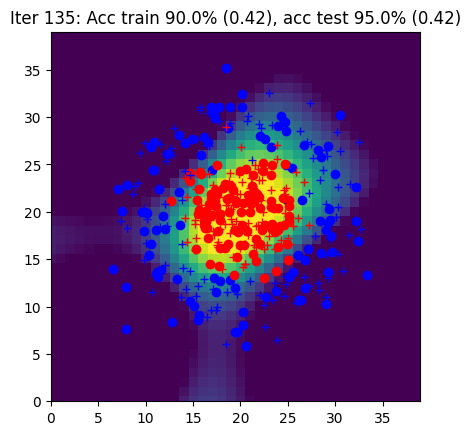

Iter 136: Acc train 90.0% (0.42), acc test 95.0% (0.41)


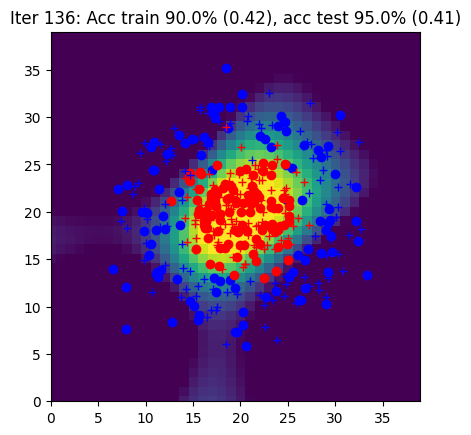

Iter 137: Acc train 90.5% (0.41), acc test 95.0% (0.40)


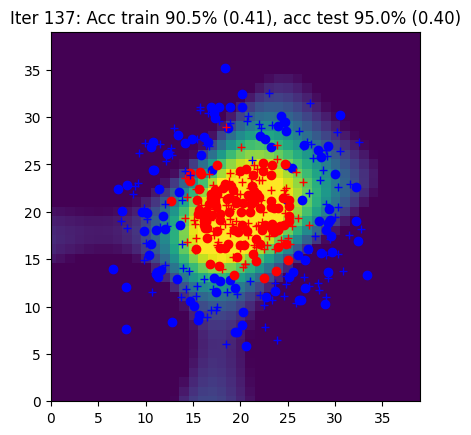

Iter 138: Acc train 90.0% (0.40), acc test 94.5% (0.40)


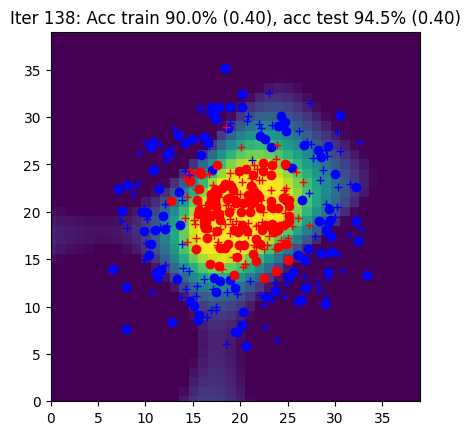

Iter 139: Acc train 90.5% (0.40), acc test 94.5% (0.39)


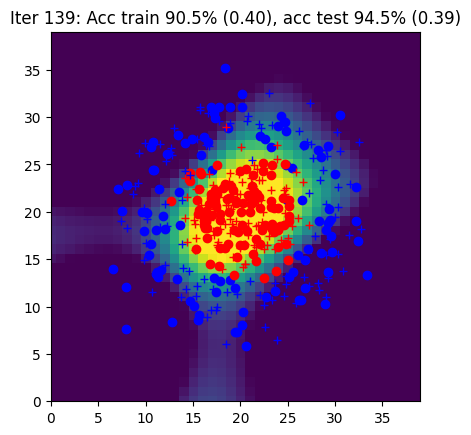

Iter 140: Acc train 90.5% (0.39), acc test 95.0% (0.39)


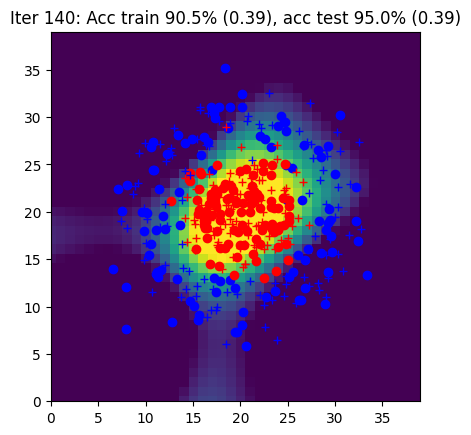

Iter 141: Acc train 90.0% (0.39), acc test 95.0% (0.38)


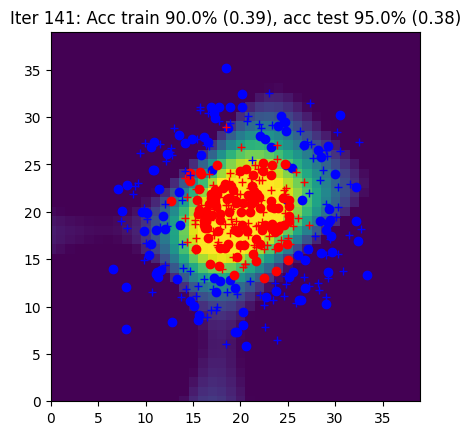

Iter 142: Acc train 90.0% (0.38), acc test 95.5% (0.38)


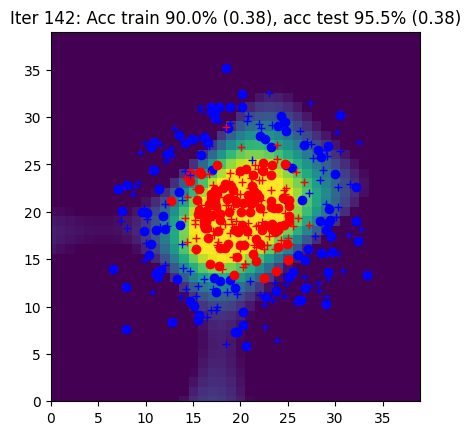

Iter 143: Acc train 90.5% (0.38), acc test 95.5% (0.37)


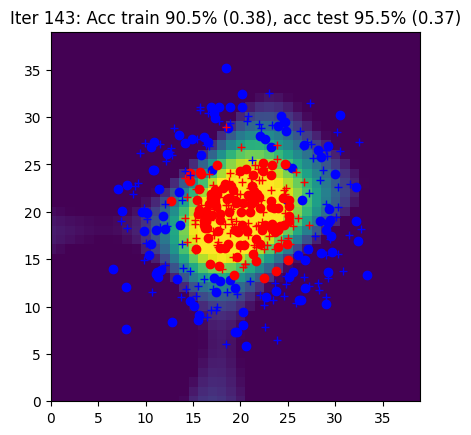

Iter 144: Acc train 90.5% (0.38), acc test 96.0% (0.37)


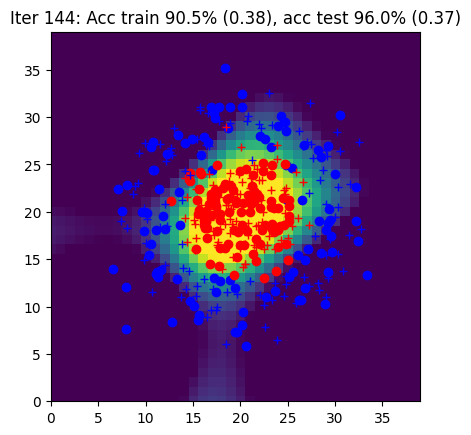

Iter 145: Acc train 90.5% (0.37), acc test 96.0% (0.36)


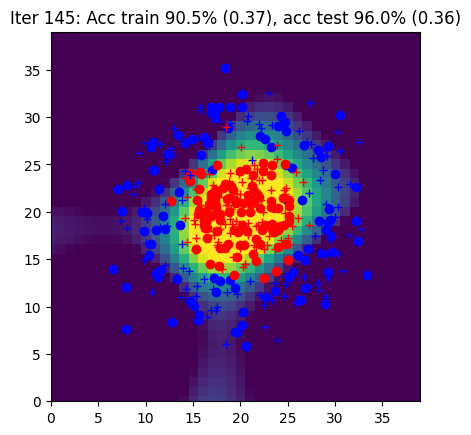

Iter 146: Acc train 91.0% (0.37), acc test 96.0% (0.36)


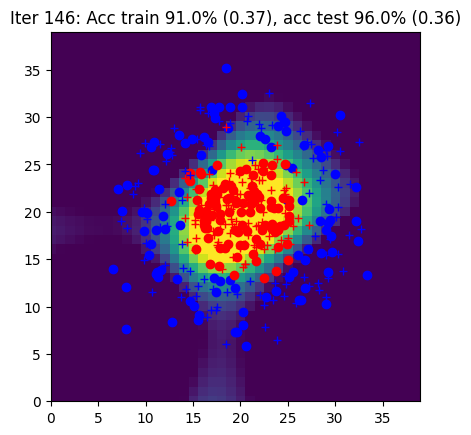

Iter 147: Acc train 91.0% (0.36), acc test 96.0% (0.35)


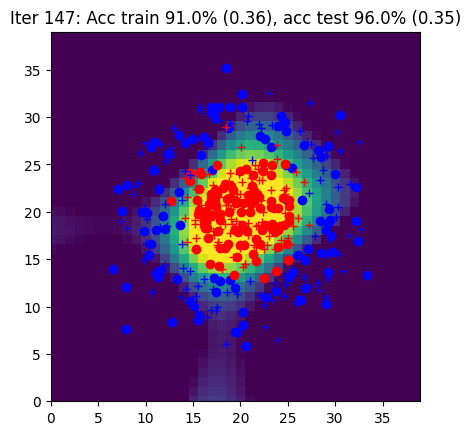

Iter 148: Acc train 91.0% (0.36), acc test 95.0% (0.35)


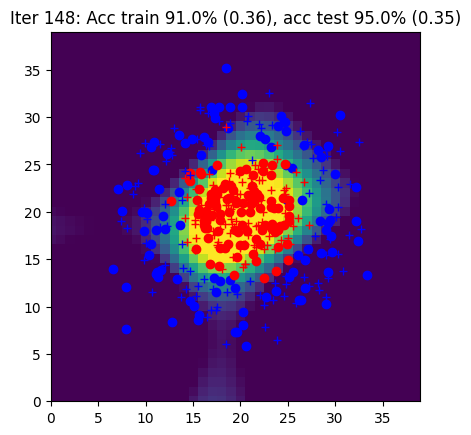

Iter 149: Acc train 91.5% (0.35), acc test 96.0% (0.35)


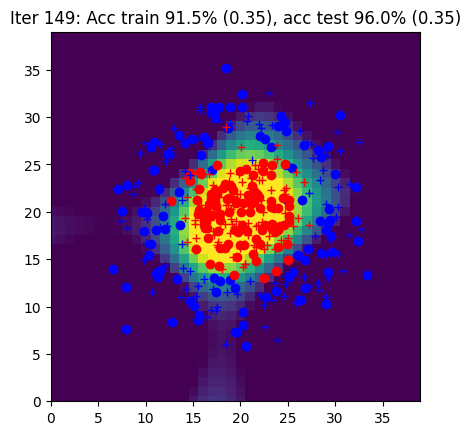

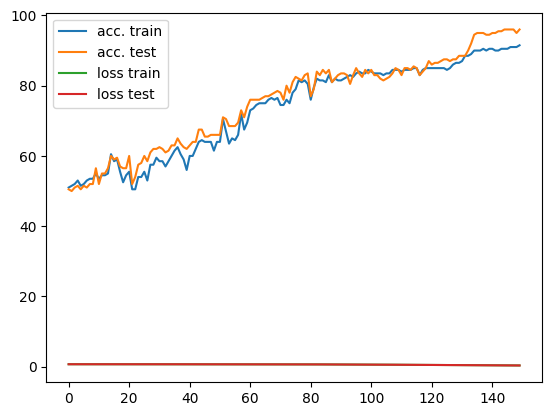

In [40]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # Write out the training code on batch inputs (X,Y)
        # Use our new forward, loss_accuracy, sgd
        # Gradients are taken care of by .backward() and .grad


    ####################
    ##      FIN        #
    ####################


        Y_hat, outputs = forward(params, X)
        loss, accuracy = loss_accuracy(Y_hat, Y)
        loss.backward()
        params = sgd(params, eta)



    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    # detach() est utilisé pour détacher les predictions du graphes de calcul autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain.detach().numpy())
    curves[1].append(acctest.detach().numpy())
    curves[2].append(Ltrain.detach().numpy())
    curves[3].append(Ltest.detach().numpy())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 3 : Simplify the forward with `torch.nn`

`init_params` et `forward` are replaced by `init_model` which instantiates the model using torch.nn (with a loss object too while we are at it!)

In [42]:
import torch.nn
import torch.nn.functional
import torch.optim as optim

In [44]:
def init_model(nx, nh, ny):

    #####################
    ## Your code here  ##
    #####################

    # Declare the model using torch.nn modules
    # It might be easier to use the torch.nn.Sequential() syntax
    model = torch.nn.Sequential( torch.nn.Linear(nx, nh),
                          torch.nn.relu(),
                           torch.nn.Linear(nh, ny)
                            )

    loss = torch.nn.CrossEntropyLoss()

    ####################
    ##      FIN        #
    ####################

    return model, loss

In [46]:
def loss_accuracy(loss, Yhat, Y):

    #####################
    ## Your code here  ##
    #####################
    # Call instantiated loss function('s forward)
    with torch.no_grad():
      L = loss(Yhat, Y)

      _, indYhat = torch.max(Yhat, 1)
      _, indY = torch.max(Y, 1)

      acc = torch.sum(indY == indYhat) * 100. / indY.size(0);

    ####################
    ##      FIN        #
    ####################

    return L, acc

In [47]:
def sgd(model, eta):

    #####################
    ## Your code here  ##
    #####################
    # Update model parameters using our instantiade model's weights
    # Remember to use torch.no_grad()
    # And do keep in mind you need oto zero out gradients afterwards


    ####################
    ##      FIN        #
    ####################

    optim_1 = torch.optim.SGD(model.parameters(), lr=eta)



    return optim_1

## Algorithme global d'apprentissage (avec autograd et les couches `torch.nn`)

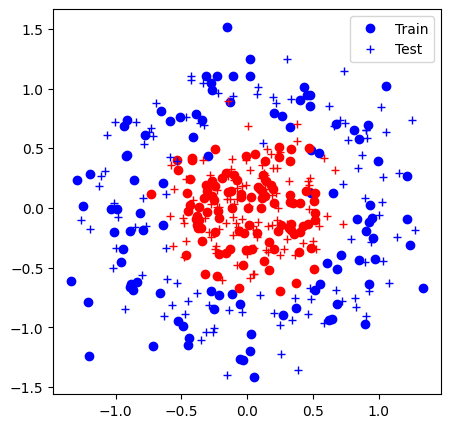

AttributeError: module 'torch.nn' has no attribute 'relu'

In [48]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # Write out the learning algorithm on batch (X,Y)
        # make good use of our new loss_accuracy, sgd
        # forward if a call to our model
        # Compute gradients using autograd as before


    ####################
    ##      FIN        #
    ####################





    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 4 : Simplifify SGD with `torch.optim`

In [ ]:
def init_model(nx, nh, ny, eta):

    #####################
    ## Your code here  ##
    #####################

    model = None
    loss = None
    optim = None

    ####################
    ##      FIN        #
    ####################

    return model, loss, optim

No more manual `sgd`! It is all taken care of by our instantiated `torch.optim.SGD`. Clear out gradients with `zero_grad()` before calling the `.backward()` and `optim.step()` after the backward.

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # Write out the learning algorithm on (X,Y)


    ####################
    ##      FIN        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Partie 5 : (If you have time) MNIST


Adapt the previous code to the MNIST dataset MNIST.

In [ ]:
# init
data = MNISTData()
N = data.Xtrain.shape[0]
Nbatch = 100
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.03